# Imports

In [1]:
from gurobipy import *
import numpy as np
import matplotlib.pyplot as plt
import re

# Data Parcing

## Provided Data parcing

In [2]:
file_path = "d=1\p=20\h=7\DataCplex_density=1_p=20_h=7_test_0.dat"


def Extract(file_path=None, d=1, p=10, h=7, t=0):
    if file_path is not None:
        with open(file_path, "r", encoding="utf-8") as f:
            data = f.readlines()  # Liste des lignes du fichier
    else:
        file_path = (
            f"d={d}\\p={p}\\h={h}\\DataCplex_density={d}_p={p}_h={h}_test_{t}.dat"
        )
        with open(file_path, "r", encoding="utf-8") as f:
            data = f.readlines()  # Liste des lignes du fichier
    data_dict = {i: list() for i in range(6)}
    i = 0
    for line in data:
        data_dict[i].append(line)
        if line[len(line) - 2 :] == ";\n":
            i += 1
    for x in range(6):
        for i in range(len(data_dict[x])):
            data_dict[x][i] = data_dict[x][i][: len(data_dict[x][i]) - 1]

    # (Departure/Arrival) (Airports/Times)

    AeroDep = {}
    AeroArr = {}
    DateDep = {}
    DateArr = {}

    for i in range(1, len(data_dict[3])):
        values = data_dict[3][i].strip("<>;{}").split(",")
        AeroDep[i] = values[1]
        AeroArr[i] = values[2]
        DateDep[i] = float(values[3])
        DateArr[i] = float(values[4])

    # Aeroports

    Aero = data_dict[0][0].split("{")[1].split("}")[0].strip(",").split(",")

    # Aircrafts

    Aircrafts_str = data_dict[2][0].split("{")[1].split("}")[0].strip(",").split(",")
    Aircrafts = range(int(Aircrafts_str[-1]) + 1)

    # Flights

    NbFlights = int(data_dict[1][0].split("=")[1].split(";")[0])

    Flights = range(1, NbFlights + 1)

    # Cost

    cost = {}
    for i in range(len(Aircrafts)):
        for j in range(1, len(data_dict[4])):
            q = 0
            for k in range(len(data_dict[4][j])):
                if data_dict[4][j][k] == ",":
                    cost[(i, j)] = data_dict[4][j][q + 1 : k]
                    cost[(i, j)] = float(cost[(i, j)])
                    q = k

    # Origin
    Origin_list = data_dict[5][1]
    Origin_list = Origin_list.strip("[]")
    pairs = Origin_list.split(" ,")
    Origin = {}
    for pair in pairs[:-1]:
        pair = pair.strip("<>")
        key, value = pair.split(",")
        Origin[int(key)] = value

    return Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin

<>:1: SyntaxWarning: invalid escape sequence '\p'
<>:1: SyntaxWarning: invalid escape sequence '\p'
C:\Users\adame\AppData\Local\Temp\ipykernel_23784\1635703404.py:1: SyntaxWarning: invalid escape sequence '\p'
  file_path = "d=1\p=20\h=7\DataCplex_density=1_p=20_h=7_test_0.dat"


In [3]:
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=1, p=20, h=7, t=0, file_path=file_path
)

In [4]:
print(Origin)

{0: 'A', 1: 'C', 2: 'K', 3: 'C', 4: 'B', 5: 'C', 6: 'C', 7: 'D', 8: 'C', 9: 'A', 10: 'B', 11: 'A', 12: 'A', 13: 'I', 14: 'C', 15: 'C', 16: 'P', 17: 'B', 18: 'I', 19: 'A'}


In [5]:
file_path_sol = "d=1\p=20\h=7\Optimal_Solution_density=1_p=20_h=7_test_0.txt"

<>:1: SyntaxWarning: invalid escape sequence '\p'
<>:1: SyntaxWarning: invalid escape sequence '\p'
C:\Users\adame\AppData\Local\Temp\ipykernel_23784\1395304505.py:1: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=1\p=20\h=7\Optimal_Solution_density=1_p=20_h=7_test_0.txt"


In [6]:
def Extract_cost_from_sol(file_path_sol=None, d=0.5, p=10, h=7, t=0):
    flight_assignments_sol = {}
    aircraft = None
    if file_path_sol is None:
        file_path_sol = (
            f"d={d}\\p={p}\\h={h}\\DataCplex_density={d}_p={p}_h={h}_test_{t}.dat"
        )
    with open(file_path_sol, "r", encoding="latin-1") as file:
        for line in file:
            if "Flights assigned to aircraft" in line:
                aircraft = int(re.search(r"\d+", line).group())
            elif "Flight n°" in line:
                match = re.search(r'<(\d+)\s+"(\w+)"\s+"(\w+)"\s+(\d+)\s+(\d+)>', line)
                if match:
                    flight_id, dep, arr, dep_time, arr_time = match.groups()
                    flight_assignments_sol[int(flight_id)] = {
                        "aircraft": aircraft,
                        "departure_airport": dep,
                        "arrival_airport": arr,
                        "departure_time": int(dep_time),
                        "arrival_time": int(arr_time),
                    }
    cost_mat = cost
    final_cost = 0
    for i in flight_assignments_sol:
        aircraft = flight_assignments_sol[i]["aircraft"]
        final_cost += cost_mat[(aircraft, i)]
    return final_cost


print(Extract_cost_from_sol(file_path_sol=file_path_sol))

3606833.0


In [7]:
def parse_flight_assignments(file_path=None, d=1, p=10, h=7, t=0):
    flight_assignments = {}
    aircraft = None
    if file_path is not None:
        with open(file_path, "r", encoding="utf-8") as f:
            data = f.readlines()  # Liste des lignes du fichier
    else:
        file_path = f"d={d}\\p={p}\\h={h}\\Optimal_Solution_density={d}_p={p}_h={h}_test_{t}.txt"

    with open(file_path, "r", encoding="latin-1") as file:

        for line in file:
            if "Flights assigned to aircraft" in line:
                aircraft = int(re.search(r"\d+", line).group())
            elif "Flight n°" in line:
                match = re.search(r'<(\d+)\s+"(\w+)"\s+"(\w+)"\s+(\d+)\s+(\d+)>', line)
                if match:
                    flight_id, dep, arr, dep_time, arr_time = match.groups()
                    flight_assignments[int(flight_id)] = {
                        "aircraft": aircraft,
                        "departure_airport": dep,
                        "arrival_airport": arr,
                        "departure_time": int(dep_time),
                        "arrival_time": int(arr_time),
                    }

    return flight_assignments


def plot_flights_opt(flight_assignments):
    aircrafts = sorted(set(f["aircraft"] for f in flight_assignments.values()))
    aircraft_colors = {
        aircraft: plt.cm.tab10(i % 10) for i, aircraft in enumerate(aircrafts)
    }
    aircraft_map = {aircraft: i for i, aircraft in enumerate(aircrafts)}

    fig, ax = plt.subplots(figsize=(12, 6))

    for flight, data in flight_assignments.items():
        color = aircraft_colors[data["aircraft"]]
        y_pos = aircraft_map[data["aircraft"]]
        ax.plot(
            [DateDep[flight], DateArr[flight]], [y_pos, y_pos], marker="o", color=color
        )
        ax.text(
            DateDep[flight],
            y_pos,
            AeroDep[flight],
            verticalalignment="top",
            horizontalalignment="right",
            fontsize=10,
            color=color,
        )
        ax.text(
            DateArr[flight],
            y_pos,
            AeroDep[flight],
            verticalalignment="bottom",
            horizontalalignment="left",
            fontsize=10,
            color=color,
        )

    ax.set_yticks(range(len(aircrafts)))
    ax.set_yticklabels([f"Aircraft {ac}" for ac in aircrafts])
    ax.set_xlabel("Time")
    ax.set_ylabel("Aircraft")
    ax.set_title("Aircraft Flight Visualization from the optimal solution file")

    plt.grid(True, linestyle="--", alpha=0.6)
    plt.show()

# Useful Functions for Flight/Airplane Selection

As per our report, we make use of certain sets to define the constraints. The definitions are rather simple and are detailed below.
Some of them are used immediately with the initial "static" model. The rest will be used further down with the repair model.

In [8]:
# Dj: the set of flights departing from the same airport as flight j
def D(j):
    L = []
    for k in Flights:
        if AeroDep[j] == AeroDep[k] and k != j:
            L.append(k)
    return set(L)


# Aa,j+: the set of flights arriving after the arrival time of flight j
def A_a_plus(j):
    L = []
    for k in Flights:
        if DateArr[k] >= DateArr[j] and k != j:
            L.append(k)
    return set(L)


# Aa,j-: the set of flights arriving before the arrival time of flight j
def A_a_minus(j):
    L = []
    for k in Flights:
        if DateArr[k] <= DateArr[j] and k != j:
            L.append(k)
    return set(L)


# Ad,j+: the set of flights arriving after the departure time of flight j
def A_d_plus(j):
    L = []
    for k in Flights:
        if DateArr[k] >= DateDep[j] and k != j:
            L.append(k)
    return set(L)


# Ad,j-: the set of flights arriving before the departure time of flight j
def A_d_minus(j):
    L = []
    for k in Flights:
        if DateArr[k] <= DateDep[j]:
            L.append(k)
    return set(L)


# Da,j+: the set of flights departing after the arrival time of flight j
def D_a_plus(j):
    L = []
    for k in Flights:
        if DateDep[k] >= DateArr[j]:
            L.append(k)
    return set(L)


# Da,j-: the set of flights departing before the arrival time of flight j
def D_a_minus(j):
    L = []
    for k in Flights:
        if DateDep[k] <= DateArr[j] and k != j:
            L.append(k)
    return set(L)


# Dd,j+: the set of flights departing after the depature time of flight j
def D_d_plus(j):
    L = []
    for k in Flights:
        if DateDep[k] >= DateDep[j] and k != j:
            L.append(k)
    return set(L)


# Dd,j-: the set of flights departing before the departure time of flight j
def D_d_minus(j):
    L = []
    for k in Flights:
        if DateDep[k] <= DateDep[j] and k != j:
            L.append(k)
    return set(L)


# Co_j: the set of flights connecting onward with flight j,  i.e. having the same departure airport as the arrival airport as flight j ∈ {1, ..., V } (regardless of the time)
def Co(j):
    L = []
    for k in Flights:
        if AeroDep[k] == AeroArr[j]:
            L.append(k)
    return set(L)


# Co_j-: the set of flights connecting backward with flight j,  i.e. having the same arrival airport as the departure airport as flight j ∈ {1, ..., V } (regardless of the time)
def Co_minus(j):
    L = []
    for k in Flights:
        if AeroArr[k] == AeroDep[j]:
            L.append(k)
    return set(L)


# Oi: the set of flights departing from the origin airport oi of airplane i ∈ {1, ..., A}.


def O(i):
    L = []
    for k in Flights:
        if Origin[i] == AeroDep[k]:
            L.append(k)
    return set(L)


# the set of flights departing after the arrival time of flight j + r Da,j,+r


def D_a_plus_r(j, r):
    L = []
    for i in Flights:
        if DateDep[i] >= DateArr[j] + r:
            L.append(i)
    return set(L)


# the set of flights with departure time in a certain interval, and a certain departure airport D[t1,t2],l
def D_(t1, t2, l):
    L = []
    for i in Flights:
        if DateDep[i] >= t1 and DateDep[i] <= t2 and AeroDep[i] == l:
            L.append(i)
    return set(L)


# the set of flights with arrival time in a certain interval, and a certain arrival airport A[t1,t2],l
def A_(t1, t2, l):
    L = []
    for i in Flights:
        if DateArr[i] >= t1 and DateArr[i] <= t2 and AeroArr[i] == l:
            L.append(i)
    return set(L)

# Small Test Instances

Here we define two small test instances to test our model :

## Test 1

In [9]:
# Define Airports
Aero = ["A", "B", "C"]

# Define Aircrafts
Aircrafts = range(2)

# Define Flights
Flights = range(1, 8)

# Define Flights Details
AeroDep = {1: "A", 2: "B", 3: "C", 4: "B", 5: "A", 6: "C", 7: "A"}
AeroArr = {1: "B", 2: "C", 3: "B", 4: "A", 5: "C", 6: "A", 7: "B"}
DateDep = {1: 550, 2: 1100, 3: 1600, 4: 2050, 5: 2600, 6: 3000, 7: 3400}
DateArr = {1: 1050, 2: 1500, 3: 2000, 4: 2550, 5: 2900, 6: 3300, 7: 3900}

# Define Costs
cost = {
    (0, 1): 100,
    (0, 2): 200,
    (0, 3): 100,
    (0, 4): 400,
    (0, 5): 200,
    (0, 6): 100,
    (0, 7): 300,
    (1, 1): 200,
    (1, 2): 300,
    (1, 3): 1000,
    (1, 4): 3500,
    (1, 5): 1000,
    (1, 6): 6000,
    (1, 7): 1000,
}

In [10]:
m = Model("Test 1")
X = {
    (i, j): m.addVar(vtype=GRB.BINARY, name="x" + str(i) + str(j))
    for i in Aircrafts
    for j in Flights
}

# -- Uniqueness of airplane assignment to flights
for j in Flights:
    m.addConstr(quicksum([X[(i, j)] for i in Aircrafts]) == 1, name="U" + str(j))

# -- No Time Table Conflicts
for j in Flights:
    for i in Aircrafts:
        for k in (D_d_plus(j) & D_a_minus(j)) | (A_d_plus(j) & A_a_minus(j)):
            m.addConstr(
                X[(i, j)] + X[(i, k)] <= 1, name="NTTC" + str(i) + str(j) + str(k)
            )

# -- Continuity of Flights for non origins
for i in Aircrafts:
    for j in Flights:
        if j not in O(i):
            m.addConstr(
                quicksum(
                    [X[(i, k)] for k in Co_minus(j) & A_d_minus(j)]
                    + [X[(i, l)] * (-1) for l in D(j) & D_d_minus(j)]
                    + [X[(i, j)] * (-1)]
                )
                >= 0, name="C " + str(i) + " " + str(j)
            )

# -- Departure / continuity for potential origins
for i in Aircrafts:
    for j in O(i):
        m.addConstr(
            quicksum(
                [X[(i, k)] for k in Co_minus(j) & A_d_minus(j)]
                + [X[(i, l)] * (-1) for l in D(j) & D_d_minus(j)]
                + [X[(i, j)] * (-1)]
            )
            >= -1, name="Co " + str(i) + " " + str(j)
        )


# Objective Function
m.setObjective(
    quicksum(X[(i, j)] * cost[(i, j)] for i in Aircrafts for j in Flights), GRB.MINIMIZE
)

m.update()

m.write("Test1.lp")

m.optimize()
if m.status == GRB.INFEASIBLE:
    print("Le modèle n'a pas de solution. Voici les contraintes le rendant ainsi")
    m.computeIIS()
    for c in m.getConstrs():
        if c.IISConstr:
            print(f"\t{c.constrname}: {m.getRow(c)} {c.Sense} {c.RHS}")
elif m.status == GRB.UNBOUNDED:
    print("Le modèle est non borné")
else:
    print("Le coût à l'optimal a pour valeur: ", m.ObjVal)

print(m.getVars())

Set parameter Username
Set parameter LicenseID to value 2617871
Academic license - for non-commercial use only - expires 2026-02-04
Gurobi Optimizer version 12.0.1 build v12.0.1rc0 (win64 - Windows 11.0 (26100.2))

CPU model: 12th Gen Intel(R) Core(TM) i5-1240P, instruction set [SSE2|AVX|AVX2]
Thread count: 12 physical cores, 16 logical processors, using up to 16 threads

Optimize a model with 21 rows, 14 columns and 56 nonzeros
Model fingerprint: 0x530495fb
Variable types: 0 continuous, 14 integer (14 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 6e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective 1400.0000000
Presolve removed 21 rows and 14 columns
Presolve time: 0.01s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.03 seconds (0.00 work units)
Thread count was 1 (of 16 available processors)

Solution count 1: 1400 

Optimal solution found (to

In [11]:
def plot_flights(aircrafts, flight_assignments, representation_list):
    aircraft_colors = {
        aircraft: plt.cm.tab10(i % 10) for i, aircraft in enumerate(aircrafts)
    }
    horizontal_shift = representation_list[0]
    fig, ax = plt.subplots(figsize=(representation_list[1],representation_list[2]))
    aircraft_map = {aircraft: i for i, aircraft in enumerate(aircrafts)}

    for flight, aircraft in flight_assignments.items():
        color = aircraft_colors[aircraft]
        y_pos = aircraft_map[aircraft]
        ax.plot(
            [DateDep[flight], DateArr[flight]],
            [y_pos, y_pos],
            marker="o",
            color=color,
            label=aircraft if aircraft not in ax.get_legend_handles_labels()[1] else "",
        )
        ax.text(
            DateDep[flight],
            y_pos + horizontal_shift,
            AeroDep[flight],
            verticalalignment="top",
            horizontalalignment="center",
            fontsize=8,
            color=color,
        )
        ax.text(
            DateArr[flight],
            y_pos - horizontal_shift,
            AeroArr[flight],
            verticalalignment="bottom",
            horizontalalignment="center",
            fontsize=8,
            color=color,
        )

    ax.set_yticks(range(len(aircrafts)))
    ax.set_yticklabels([f"Aircraft {ac}" for ac in aircrafts])
    ax.set_xlabel("Time")
    ax.set_ylabel("Aircraft")
    ax.set_title("Aircraft Flight Visualization")
    # ax.legend(title="Aircrafts")
    plt.grid(True, linestyle="--", alpha=0.6)
    plt.show()

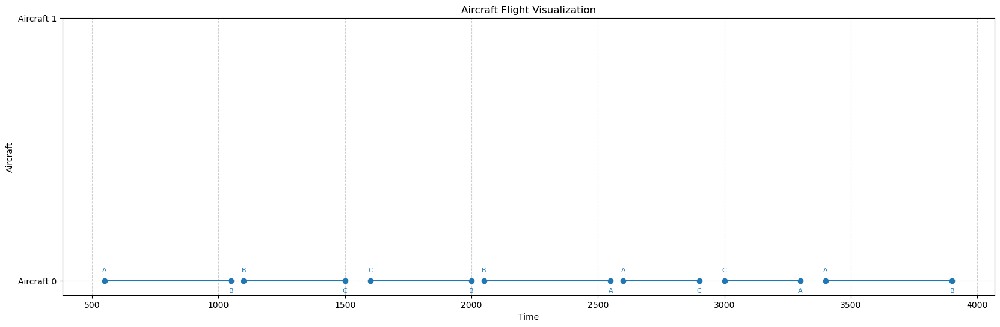

In [12]:
# Define Aircraft Assignments based on Gurobi results
gurobi_vars = [var.x for var in m.getVars()]

flight_assignments = {}
index = 0
for aircraft in Aircrafts:
    for flight in Flights:
        if gurobi_vars[index] == 1.0:
            flight_assignments[flight] = aircraft
        index += 1

plot_flights(Aircrafts, flight_assignments,representation_list=[0.05,20,6])

## Test 2

In [13]:
# Define Airports
Aero = ["A", "B", "C"]

# Define Aircrafts
Aircrafts = list(range(2))

# Define Flights
Flights = list(range(1, 8))

# Define Flights Details
AeroDep = {1: "A", 2: "B", 3: "A", 4: "B", 5: "C", 6: "C", 7: "B"}
AeroArr = {1: "B", 2: "C", 3: "C", 4: "A", 5: "B", 6: "A", 7: "C"}
DateDep = {1: 550, 2: 200, 3: 1700, 4: 1100, 5: 700, 6: 2000, 7: 1200}
DateArr = {1: 1050, 2: 600, 3: 2000, 4: 1600, 5: 1100, 6: 2300, 7: 1600}

# Define Aicrafts Origin Airports
Origin = {0: "A", 1: "B"}

# Define Costs
cost = {
    (0, 1): 100,
    (0, 2): 2000,
    (0, 3): 300,
    (0, 4): 400,
    (0, 5): 5000,
    (0, 6): 600,
    (0, 7): 7000,
    (1, 1): 1000,
    (1, 2): 200,
    (1, 3): 3000,
    (1, 4): 4000,
    (1, 5): 500,
    (1, 6): 6000,
    (1, 7): 700,
}

In [14]:
m = Model("Test 2")
X = {
    (i, j): m.addVar(vtype=GRB.BINARY, name="x" + str(i) + str(j))
    for i in Aircrafts
    for j in Flights
}

# -- Uniqueness of airplane assignment to flights
for j in Flights:
    m.addConstr(quicksum([X[(i, j)] for i in Aircrafts]) == 1, name="U" + str(j))

# -- No Time Table Conflicts
for j in Flights:
    for i in Aircrafts:
        for k in (D_d_plus(j) & D_a_minus(j)) | (A_d_plus(j) & A_a_minus(j)):
            m.addConstr(
                X[(i, j)] + X[(i, k)] <= 1, name="NTTC" + str(i) + str(j) + str(k)
            )

# -- Continuity of Flights for non origins
for i in Aircrafts:
    for j in Flights:
        if j not in O(i):
            m.addConstr(
                quicksum(
                    [X[(i, k)] for k in Co_minus(j) & A_d_minus(j)]
                    + [X[(i, l)] * (-1) for l in D(j) & D_d_minus(j)]
                    + [X[(i, j)] * (-1)]
                )
                >= 0,  name="C "+ str(i)+ " "+str(j) 
            )

# -- Departure / continuity for potential origins
for i in Aircrafts:
    for j in O(i):
        m.addConstr(
            quicksum(
                [X[(i, k)] for k in Co_minus(j) & A_d_minus(j)]
                + [X[(i, l)] * (-1) for l in D(j) & D_d_minus(j)]
                + [X[(i, j)] * (-1)]
            )
            >= -1, name="Co "+ str(i) + " " + str(j)
        )


# Objective Function
m.setObjective(
    quicksum(X[(i, j)] * cost[(i, j)] for i in Aircrafts for j in Flights), GRB.MINIMIZE
)

m.update()

m.write("Test2.lp")

m.optimize()
if m.status == GRB.INFEASIBLE:
    print("Le modèle n'a pas de solution. Voici les contraintes le rendant ainsi")
    m.computeIIS()
    for c in m.getConstrs():
        if c.IISConstr:
            print(f"\t{c.constrname}: {m.getRow(c)} {c.Sense} {c.RHS}")
elif m.status == GRB.UNBOUNDED:
    print("Le modèle est non borné")
else:
    print("Le coût à l'optimal a pour valeur: ", m.ObjVal)

print(m.getVars())

Gurobi Optimizer version 12.0.1 build v12.0.1rc0 (win64 - Windows 11.0 (26100.2))

CPU model: 12th Gen Intel(R) Core(TM) i5-1240P, instruction set [SSE2|AVX|AVX2]
Thread count: 12 physical cores, 16 logical processors, using up to 16 threads

Optimize a model with 41 rows, 14 columns and 96 nonzeros
Model fingerprint: 0xeeb77484
Variable types: 0 continuous, 14 integer (14 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+02, 7e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective 8200.0000000
Presolve removed 41 rows and 14 columns
Presolve time: 0.00s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.01 seconds (0.00 work units)
Thread count was 1 (of 16 available processors)

Solution count 1: 8200 

Optimal solution found (tolerance 1.00e-04)
Best objective 8.200000000000e+03, best bound 8.200000000000e+03, gap 0.0000%
Le coût à l'optimal a pour valeur:  

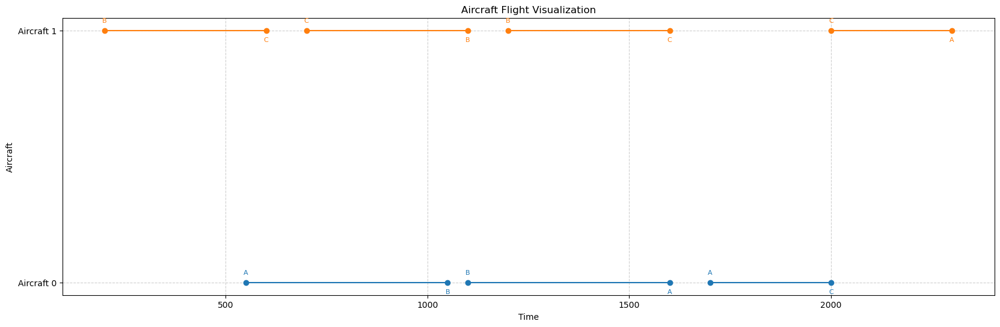

In [15]:
# Define Aircraft Assignments based on Gurobi results
gurobi_vars = [var.x for var in m.getVars()]

flight_assignments = {}
index = 0
for aircraft in Aircrafts:
    for flight in Flights:
        if gurobi_vars[index] == 1.0:
            flight_assignments[flight] = aircraft
        index += 1

plot_flights(Aircrafts, flight_assignments,[0.05, 20, 6])

# Test on the 3-day-long provided Instance in The Problem Description

In [16]:
# Conversion of time values for multi-day setting
def time_to_minutes(time_str, day):
    hours, minutes = map(int, time_str.split("h"))
    return hours * 60 + minutes + (day - 1) * 24 * 60


# Define Airports
Aero = ["PAR", "BER", "NCE", "BCN", "MAD", "LYN"]

# Define Aircrafts
Aircrafts = list(range(3))

# Define Flights
Flights = list(range(1, 31))

# Define Flights Details
AeroDep = {
    1: "PAR",
    2: "BER",
    3: "BER",
    4: "NCE",
    5: "PAR",
    6: "BER",
    7: "PAR",
    8: "BCN",
    9: "NCE",
    10: "PAR",
    11: "BCN",
    12: "BER",
    13: "PAR",
    14: "MAD",
    15: "PAR",
    16: "BCN",
    17: "PAR",
    18: "NCE",
    19: "PAR",
    20: "BCN",
    21: "BER",
    22: "PAR",
    23: "PAR",
    24: "NCE",
    25: "BER",
    26: "LYN",
    27: "BER",
    28: "LYN",
    29: "BER",
    30: "BCN",
}

AeroArr = {
    1: "BER",
    2: "NCE",
    3: "NCE",
    4: "PAR",
    5: "BCN",
    6: "PAR",
    7: "BCN",
    8: "NCE",
    9: "PAR",
    10: "BER",
    11: "PAR",
    12: "PAR",
    13: "MAD",
    14: "PAR",
    15: "BCN",
    16: "PAR",
    17: "BER",
    18: "PAR",
    19: "BCN",
    20: "BER",
    21: "PAR",
    22: "NCE",
    23: "LYN",
    24: "PAR",
    25: "LYN",
    26: "BER",
    27: "PAR",
    28: "BER",
    29: "BCN",
    30: "PAR",
}

# Définition des horaires avec conversion en minutes
DateDep = {
    1: time_to_minutes("07h25", 1),
    2: time_to_minutes("09h45", 1),
    3: time_to_minutes("10h15", 1),
    4: time_to_minutes("12h25", 1),
    5: time_to_minutes("14h25", 1),
    6: time_to_minutes("08h10", 1),
    7: time_to_minutes("11h00", 1),
    8: time_to_minutes("13h15", 1),
    9: time_to_minutes("13h05", 1),
    10: time_to_minutes("15h15", 1),
    11: time_to_minutes("06h15", 2),
    12: time_to_minutes("09h15", 2),
    13: time_to_minutes("07h45", 2),
    14: time_to_minutes("10h35", 2),
    15: time_to_minutes("11h30", 2),
    16: time_to_minutes("13h45", 2),
    17: time_to_minutes("15h45", 2),
    18: time_to_minutes("10h15", 2),
    19: time_to_minutes("12h15", 2),
    20: time_to_minutes("14h40", 2),
    21: time_to_minutes("07h45", 3),
    22: time_to_minutes("10h00", 3),
    23: time_to_minutes("09h55", 3),
    24: time_to_minutes("12h00", 3),
    25: time_to_minutes("08h05", 3),
    26: time_to_minutes("11h40", 3),
    27: time_to_minutes("14h00", 3),
    28: time_to_minutes("10h35", 3),
    29: time_to_minutes("13h00", 3),
    30: time_to_minutes("16h10", 3),
}

DateArr = {
    1: time_to_minutes("09h10", 1),
    2: time_to_minutes("11h50", 1),
    3: time_to_minutes("12h20", 1),
    4: time_to_minutes("13h50", 1),
    5: time_to_minutes("16h10", 1),
    6: time_to_minutes("09h55", 1),
    7: time_to_minutes("12h30", 1),
    8: time_to_minutes("14h30", 1),
    9: time_to_minutes("14h30", 1),
    10: time_to_minutes("17h00", 1),
    11: time_to_minutes("07h10", 2),
    12: time_to_minutes("11h00", 2),
    13: time_to_minutes("09h55", 2),
    14: time_to_minutes("12h45", 2),
    15: time_to_minutes("13h15", 2),
    16: time_to_minutes("15h00", 2),
    17: time_to_minutes("17h30", 2),
    18: time_to_minutes("11h40", 2),
    19: time_to_minutes("14h10", 2),
    20: time_to_minutes("17h20", 2),
    21: time_to_minutes("09h30", 3),
    22: time_to_minutes("11h25", 3),
    23: time_to_minutes("10h55", 3),
    24: time_to_minutes("13h25", 3),
    25: time_to_minutes("09h55", 3),
    26: time_to_minutes("13h30", 3),
    27: time_to_minutes("15h45", 3),
    28: time_to_minutes("12h25", 3),
    29: time_to_minutes("15h40", 3),
    30: time_to_minutes("18h05", 3),
}


# Define Aircrafts Origin Airports
Origin = {0: "PAR", 1: "BER", 2: "BER"}

# Define Costs
cost = {
    (0, 1): 4505,
    (0, 2): 5074,
    (0, 3): 5074,
    (0, 4): 4270,
    (0, 5): 4471,
    (0, 6): 4505,
    (0, 7): 4471,
    (0, 8): 3755,
    (0, 9): 4270,
    (0, 10): 4505,
    (0, 11): 4471,
    (0, 12): 4505,
    (0, 13): 4919,
    (0, 14): 4919,
    (0, 15): 4471,
    (0, 16): 4471,
    (0, 17): 4505,
    (0, 18): 4270,
    (0, 19): 4471,
    (0, 20): 6071,
    (0, 21): 4505,
    (0, 22): 4270,
    (0, 23): 3376,
    (0, 24): 4270,
    (0, 25): 5045,
    (0, 26): 5045,
    (0, 27): 4505,
    (0, 28): 5045,
    (0, 29): 6071,
    (0, 30): 4471,
    (1, 1): 4505,
    (1, 2): 5079,
    (1, 3): 5079,
    (1, 4): 4265,
    (1, 5): 4469,
    (1, 6): 4505,
    (1, 7): 4469,
    (1, 8): 3744,
    (1, 9): 4265,
    (1, 10): 4505,
    (1, 11): 4469,
    (1, 12): 4505,
    (1, 13): 4922,
    (1, 14): 4922,
    (1, 15): 4469,
    (1, 16): 4469,
    (1, 17): 4505,
    (1, 18): 4265,
    (1, 19): 4469,
    (1, 20): 6088,
    (1, 21): 4505,
    (1, 22): 4265,
    (1, 23): 3361,
    (1, 24): 4265,
    (1, 25): 5050,
    (1, 26): 5050,
    (1, 27): 4505,
    (1, 28): 5050,
    (1, 29): 6088,
    (1, 30): 4469,
    (2, 1): 4505,
    (2, 2): 5097,
    (2, 3): 5097,
    (2, 4): 4302,
    (2, 5): 4501,
    (2, 6): 4505,
    (2, 7): 4501,
    (2, 8): 3794,
    (2, 9): 4302,
    (2, 10): 4505,
    (2, 11): 4501,
    (2, 12): 4505,
    (2, 13): 4943,
    (2, 14): 4943,
    (2, 15): 4501,
    (2, 16): 4501,
    (2, 17): 4505,
    (2, 18): 4302,
    (2, 19): 4501,
    (2, 20): 6082,
    (2, 21): 4505,
    (2, 22): 4302,
    (2, 23): 3419,
    (2, 24): 4302,
    (2, 25): 5068,
    (2, 26): 5068,
    (2, 27): 4505,
    (2, 28): 5068,
    (2, 29): 6082,
    (2, 30): 4501,
}

In [17]:
m = Model("Test 3")
X = {
    (i, j): m.addVar(vtype=GRB.BINARY, name="x" + str(i) + " " + str(j))
    for i in Aircrafts
    for j in Flights
}

# -- Uniqueness of airplane assignment to flights
for j in Flights:
    m.addConstr(quicksum([X[(i, j)] for i in Aircrafts]) == 1, name="U" + str(j))

# -- No Time Table Conflicts
for j in Flights:
    for i in Aircrafts:
        for k in (D_d_plus(j) & D_a_minus(j)) | (A_d_plus(j) & A_a_minus(j)):
            m.addConstr(
                X[(i, j)] + X[(i, k)] <= 1,
                name="NTTC" + str(i) + " " + str(j) + " " + str(k),
            )

# -- Continuity of Flights for non origins
for i in Aircrafts:
    for j in Flights:
        if j not in O(i):
            m.addConstr(
                quicksum(
                    [X[(i, k)] for k in Co_minus(j) & A_d_minus(j)]
                    + [X[(i, l)] * (-1) for l in D(j) & D_d_minus(j)]
                    + [X[(i, j)] * (-1)]
                )
                >= 0, name="C "+ str(i) + " " + str(j)
            )

# -- Departure / continuity for potential origins
for i in Aircrafts:
    for j in O(i):
        m.addConstr(
            quicksum(
                [X[(i, k)] for k in Co_minus(j) & A_d_minus(j)]
                + [X[(i, l)] * (-1) for l in D(j) & D_d_minus(j)]
                + [X[(i, j)] * (-1)]
            )
            >= -1, name="Co "+ str(i) + " " + str(j)
        )


# Objective Function
m.setObjective(
    quicksum(X[(i, j)] * cost[(i, j)] for i in Aircrafts for j in Flights), GRB.MINIMIZE
)

m.update()

m.write("Test3.lp")

m.optimize()
if m.status == GRB.INFEASIBLE:
    print("Le modèle n'a pas de solution. Voici les contraintes le rendant ainsi")
    m.computeIIS()
    for c in m.getConstrs():
        if c.IISConstr:
            print(f"\t{c.constrname}: {m.getRow(c)} {c.Sense} {c.RHS}")
elif m.status == GRB.UNBOUNDED:
    print("Le modèle est non borné")
else:
    print("Le coût à l'optimal a pour valeur: ", m.ObjVal)

print(m.getVars())

Gurobi Optimizer version 12.0.1 build v12.0.1rc0 (win64 - Windows 11.0 (26100.2))

CPU model: 12th Gen Intel(R) Core(TM) i5-1240P, instruction set [SSE2|AVX|AVX2]
Thread count: 12 physical cores, 16 logical processors, using up to 16 threads

Optimize a model with 321 rows, 90 columns and 1152 nonzeros
Model fingerprint: 0xe68ae1e4
Variable types: 0 continuous, 90 integer (90 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e+03, 6e+03]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective 138813.00000
Presolve removed 288 rows and 68 columns
Presolve time: 0.01s
Presolved: 33 rows, 22 columns, 111 nonzeros
Found heuristic solution: objective 138765.00000
Variable types: 0 continuous, 22 integer (22 binary)

Root relaxation: objective 1.387420e+05, 15 iterations, 0.01 seconds (0.00 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf

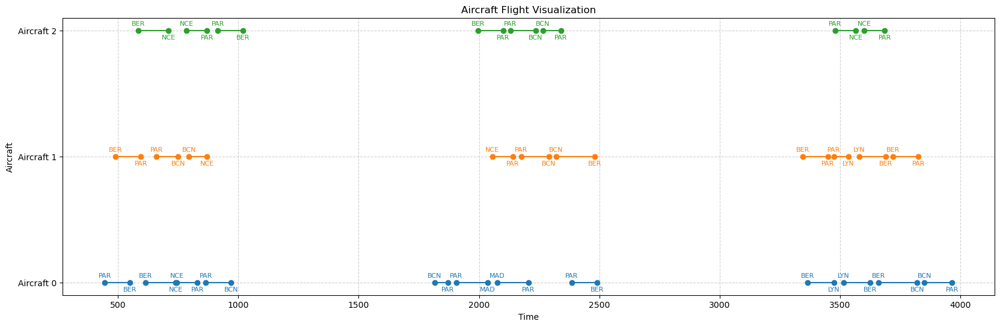

In [18]:
# Define Aircraft Assignments based on Gurobi results
gurobi_vars = [var.x for var in m.getVars()]

flight_assignments = {}
index = 0
for aircraft in Aircrafts:
    for flight in Flights:
        if gurobi_vars[index] == 1.0:
            flight_assignments[flight] = aircraft
        index += 1


plot_flights(Aircrafts, flight_assignments,[0.08, 20, 6])

# Solving the Provided Data

In order to keep track of the performance of the model, we define the following dictionnaries:

In [19]:
solving_time = {}
solved_objective = {}
otpimal_objective = {}

In [20]:
def Solve_and_represent(m,file_name,representation_list):
    X = {
        (i, j): m.addVar(vtype=GRB.BINARY, name="x" + str(i) + str(j))
        for i in Aircrafts
        for j in Flights
    }

    # -- Uniqueness of airplane assignment to flights
    for j in Flights:
        m.addConstr(quicksum([X[(i, j)] for i in Aircrafts]) == 1, name="U" + str(j))

    # -- Continuity of Flights for non origins
    for i in Aircrafts:
        for j in Flights:
            if j not in O(i):
                m.addConstr(
                    quicksum(
                        [X[(i, k)] for k in Co_minus(j) & A_d_minus(j)]
                        + [X[(i, l)] * (-1) for l in D(j) & D_d_minus(j)]
                        + [X[(i, j)] * (-1)]
                    )
                    >= 0, name="Co "+ str(i) + " " + str(j)
                )

    # -- Departure / continuity for potential origins
    for i in Aircrafts:
        for j in O(i):
            m.addConstr(
                quicksum(
                    [X[(i, k)] for k in Co_minus(j) & A_d_minus(j)]
                    + [X[(i, l)] * (-1) for l in D(j) & D_d_minus(j)]
                    + [X[(i, j)] * (-1)]
                )
                >= -1, name="Co "+ str(i) + " " + str(j)
            )

    # Objective Function
    m.setObjective(
        quicksum(X[(i, j)] * cost[(i, j)] for i in Aircrafts for j in Flights),
        GRB.MINIMIZE,
    )
    m.params.outputflag = 0
    m.update()

    m.write(str(file_name)+".lp")

    m.optimize()
    if m.status == GRB.INFEASIBLE:
        print("Le modèle n'a pas de solution. Voici les contraintes le rendant ainsi")
        m.computeIIS()
        for c in m.getConstrs():
            if c.IISConstr:
                print(f"\t{c.constrname}: {m.getRow(c)} {c.Sense} {c.RHS}")
    elif m.status == GRB.UNBOUNDED:
        print("Le modèle est non borné")
    else:
        print("Le coût à l'optimal a pour valeur: ", m.ObjVal)

    solving_time[file_name]=m.Runtime
    solved_objective[file_name]=m.ObjVal

    # Define Aircraft Assignments based on Gurobi results
    gurobi_vars = [var.x for var in m.getVars()]

    flight_assignments = {}
    index = 0
    for aircraft in Aircrafts:
        for flight in Flights:
            if gurobi_vars[index] == 1.0:
                flight_assignments[flight] = aircraft
            index += 1

    plot_flights(Aircrafts, flight_assignments,representation_list)

In [21]:
def optimal_representation(p,h):
    l=[0,0,0]
    
    if h==7:
        l[2]=6
    elif h==15:
        l[2]=12
    elif h==21:
        l[2]=18
    elif h==30:
        l[2]=24
    
    if p==10:
        l[0]= 0.3
        l[1]= 20
    elif p==20:
        l[0]= 0.6
        l[1]= 40
    elif p==30:
        l[0]= 0.9
        l[1]= 30
    elif p==40:
        l[0]= 1.2
        l[1]= 40
    return l

## cell 1

<>:12: SyntaxWarning: invalid escape sequence '\p'
<>:12: SyntaxWarning: invalid escape sequence '\h'
<>:12: SyntaxWarning: invalid escape sequence '\O'
<>:12: SyntaxWarning: invalid escape sequence '\p'
<>:12: SyntaxWarning: invalid escape sequence '\h'
<>:12: SyntaxWarning: invalid escape sequence '\O'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_23172\3156360728.py:12: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d="+str(d)+"\p="+str(p)+"\h="+str(h)+"\Optimal_Solution_density="+str(d)+"_p="+str(p)+"_h="+str(h)+"_test_"+str(t)+".txt"
C:\Users\ASUS\AppData\Local\Temp\ipykernel_23172\3156360728.py:12: SyntaxWarning: invalid escape sequence '\h'
  file_path_sol = "d="+str(d)+"\p="+str(p)+"\h="+str(h)+"\Optimal_Solution_density="+str(d)+"_p="+str(p)+"_h="+str(h)+"_test_"+str(t)+".txt"
C:\Users\ASUS\AppData\Local\Temp\ipykernel_23172\3156360728.py:12: SyntaxWarning: invalid escape sequence '\O'
  file_path_sol = "d="+str(d)+"\p="+str(p)+"\h="+str(h)+"\Optimal_Solution_dens

Le coût à l'optimal a pour valeur:  829836.0


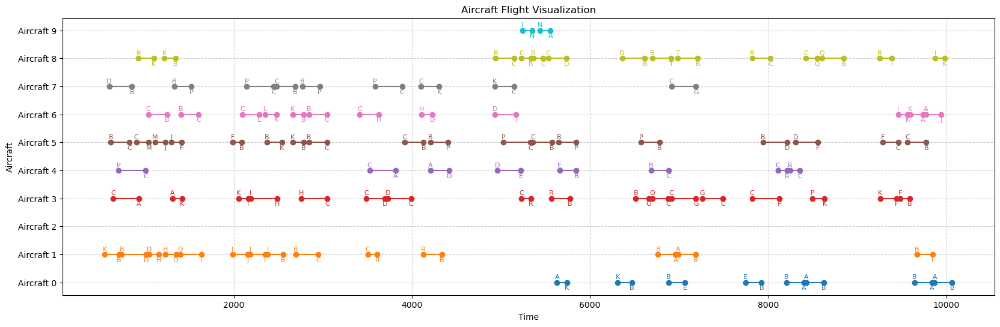

The optimal Cost provided is 829836.0
Le coût à l'optimal a pour valeur:  767779.0


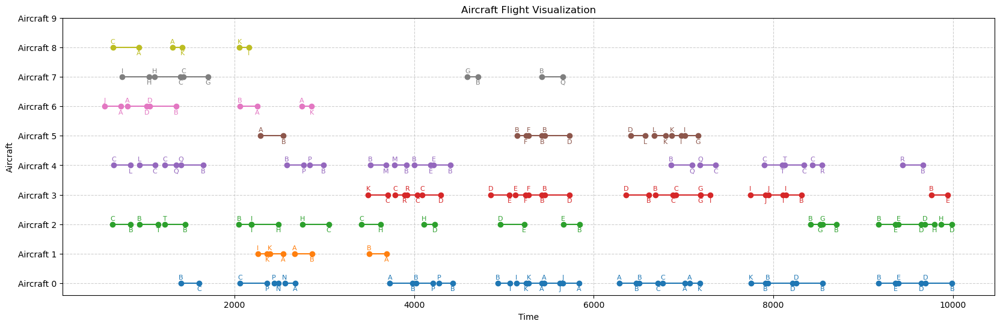

The optimal Cost provided is 767779.0
Le coût à l'optimal a pour valeur:  989823.0


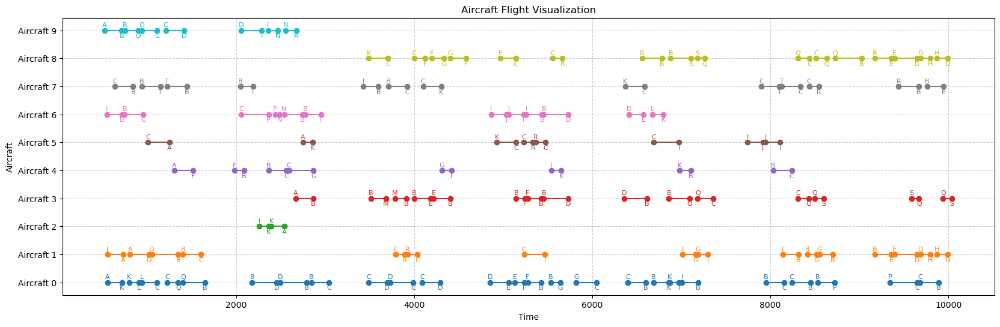

The optimal Cost provided is 989823.0
Le coût à l'optimal a pour valeur:  778912.0


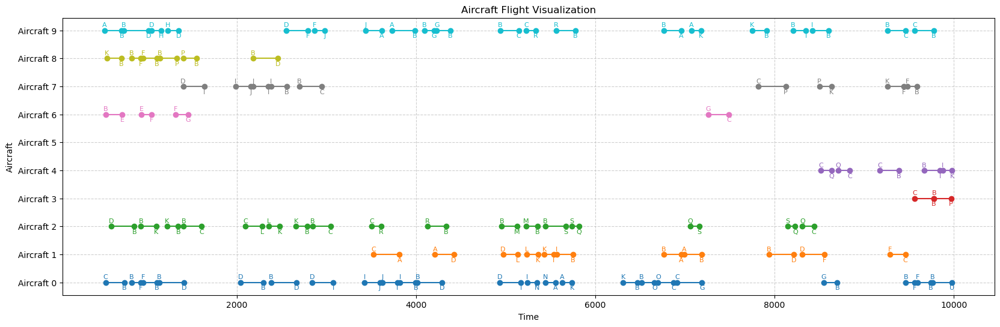

The optimal Cost provided is 778912.0
Le coût à l'optimal a pour valeur:  1014563.0


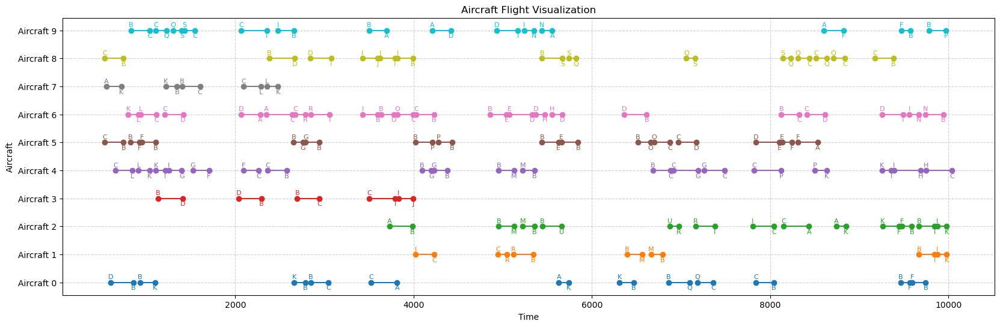

The optimal Cost provided is 1014563.0
Le coût à l'optimal a pour valeur:  519756.0


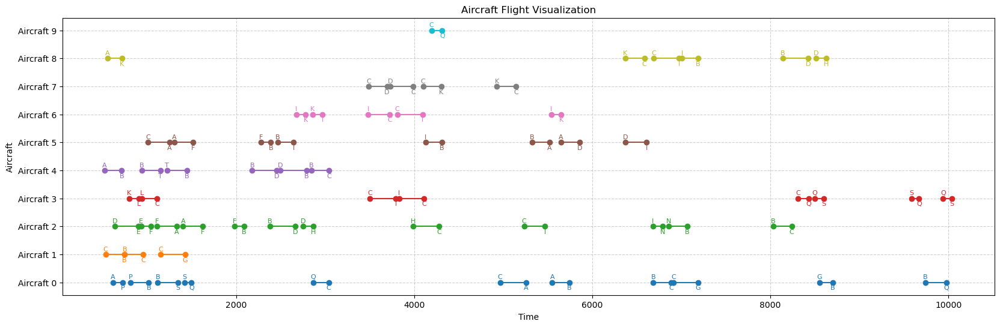

The optimal Cost provided is 519756.0
Le coût à l'optimal a pour valeur:  837052.0


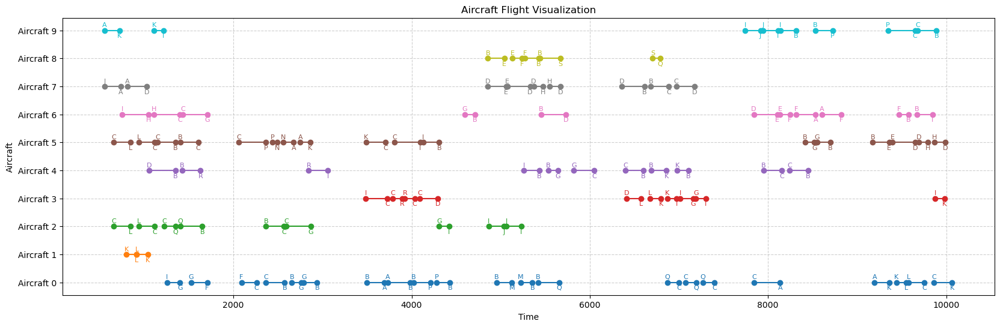

The optimal Cost provided is 837052.0
Le coût à l'optimal a pour valeur:  853751.0


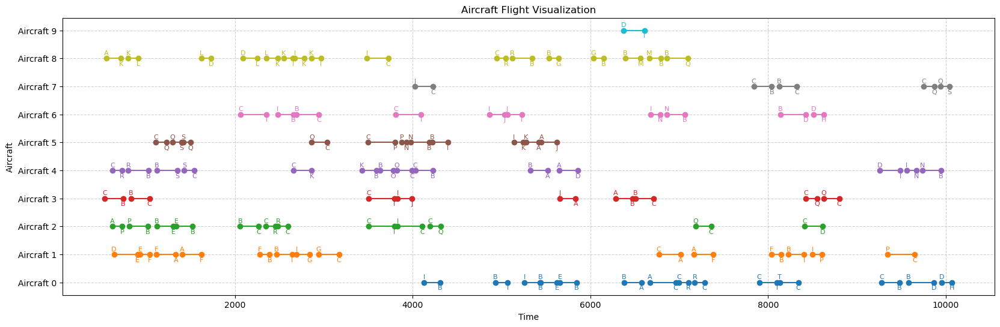

The optimal Cost provided is 853751.0
Le coût à l'optimal a pour valeur:  790251.0


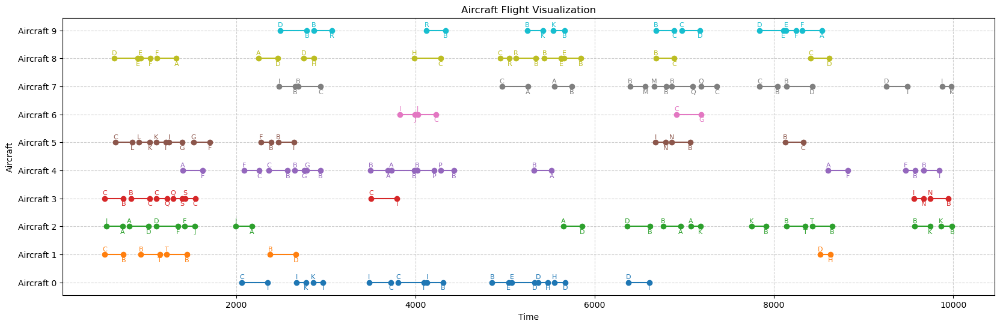

The optimal Cost provided is 790251.0
Le coût à l'optimal a pour valeur:  837052.0


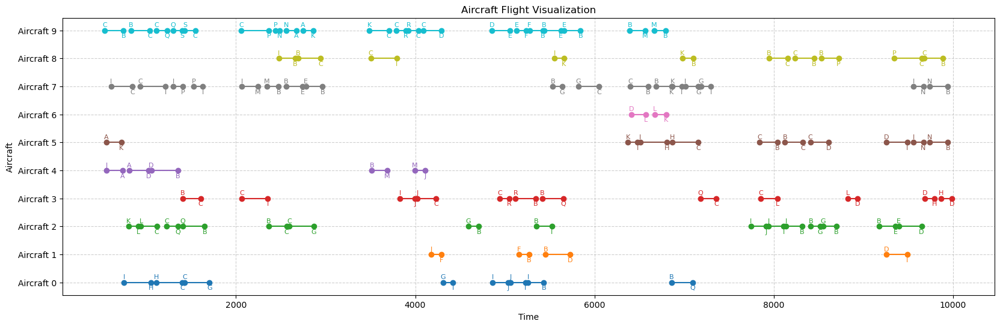

The optimal Cost provided is 837052.0
Le coût à l'optimal a pour valeur:  1438457.0


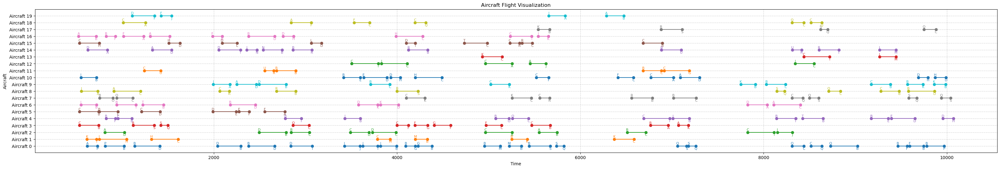

The optimal Cost provided is 1438457.0
Le coût à l'optimal a pour valeur:  1445118.0


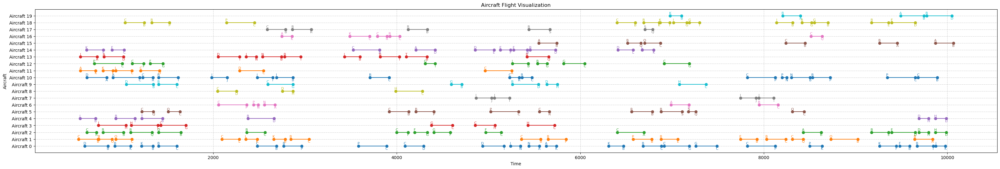

The optimal Cost provided is 1445118.0
Le coût à l'optimal a pour valeur:  1646625.0


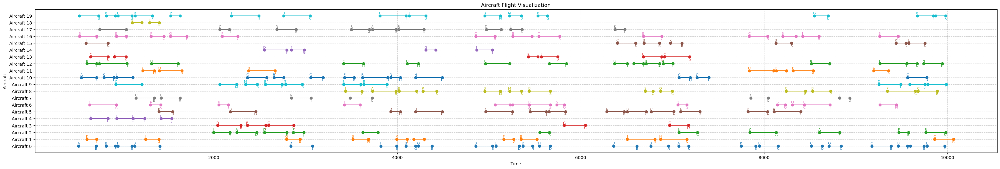

The optimal Cost provided is 1646625.0
Le coût à l'optimal a pour valeur:  1385789.0


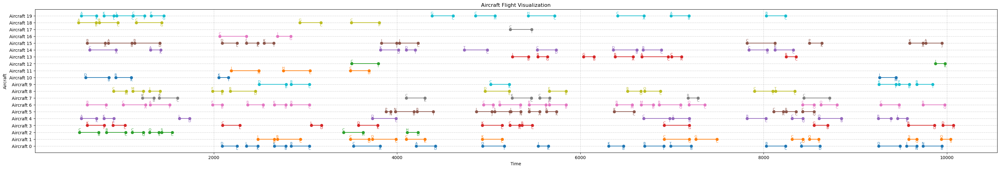

The optimal Cost provided is 1385789.0
Le coût à l'optimal a pour valeur:  1699293.0


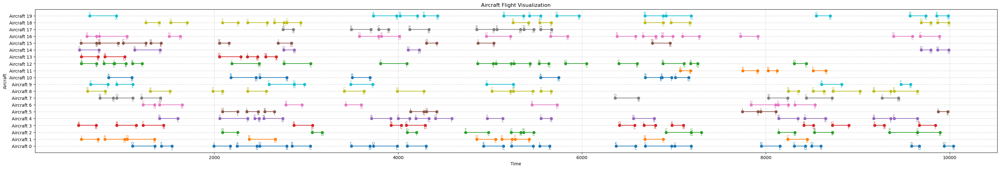

The optimal Cost provided is 1699293.0
Le coût à l'optimal a pour valeur:  1758830.0


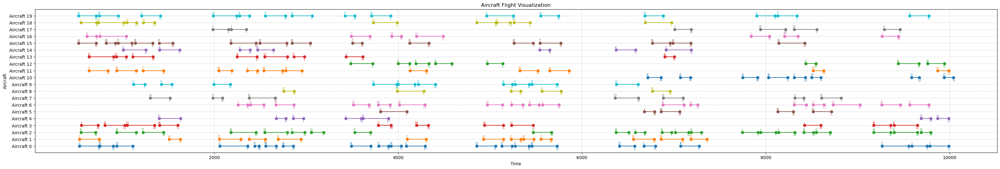

The optimal Cost provided is 1758830.0
Le coût à l'optimal a pour valeur:  1353730.0


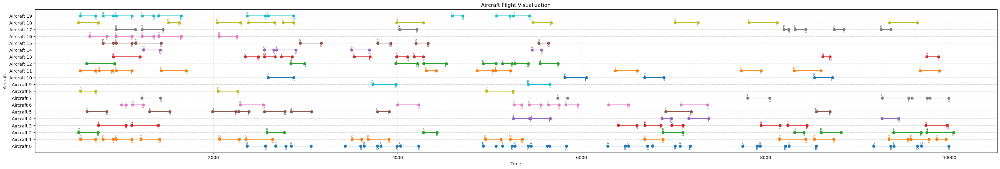

The optimal Cost provided is 1353730.0
Le coût à l'optimal a pour valeur:  1550867.0


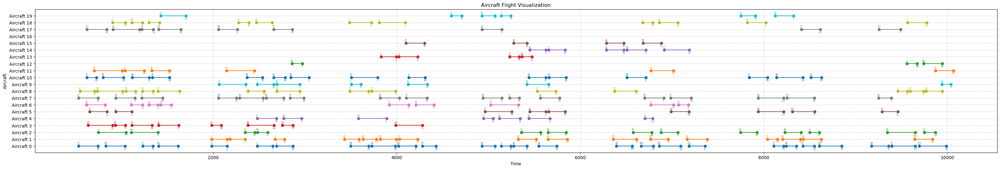

The optimal Cost provided is 1550867.0
Le coût à l'optimal a pour valeur:  1532757.0


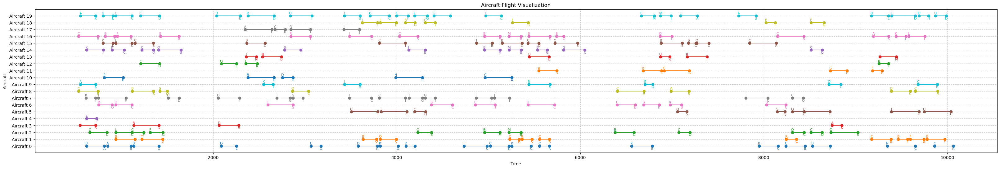

The optimal Cost provided is 1532757.0
Le coût à l'optimal a pour valeur:  1613735.0


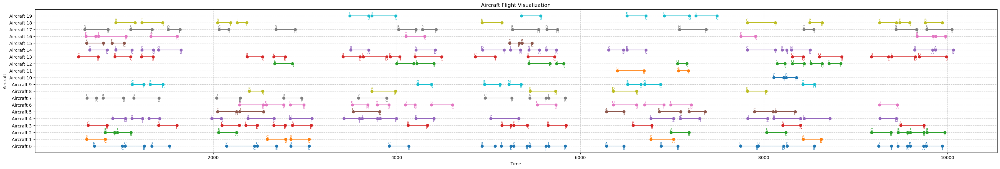

The optimal Cost provided is 1613735.0
Le coût à l'optimal a pour valeur:  1137029.0


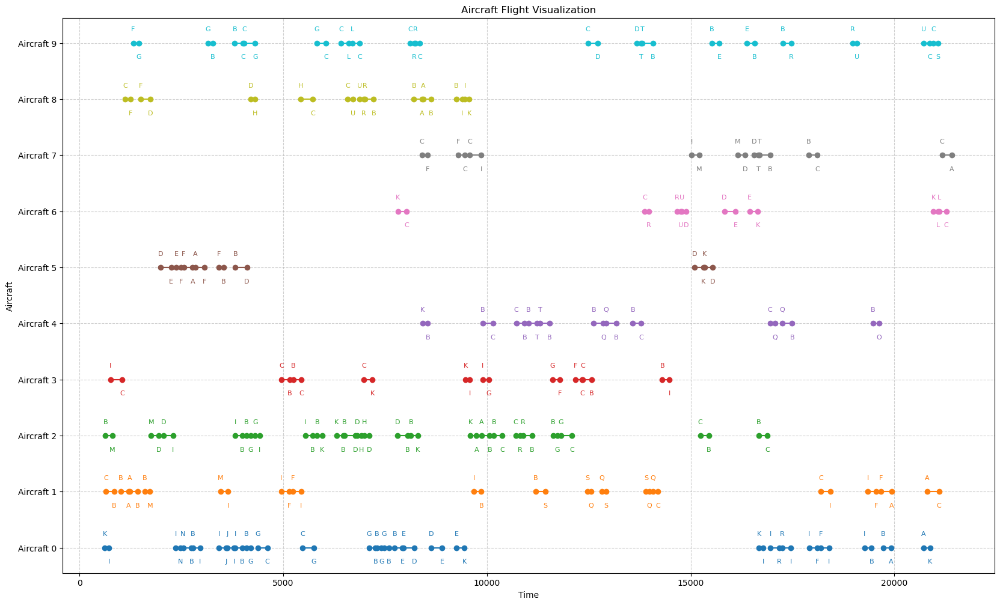

The optimal Cost provided is 1137029.0
Le coût à l'optimal a pour valeur:  1046314.0


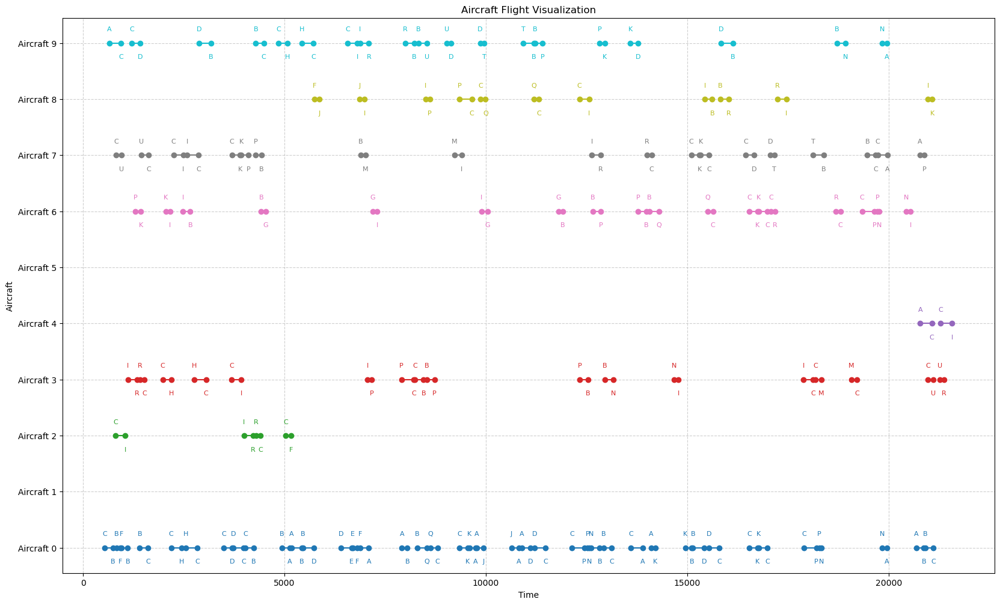

The optimal Cost provided is 1046314.0
Le coût à l'optimal a pour valeur:  966938.0


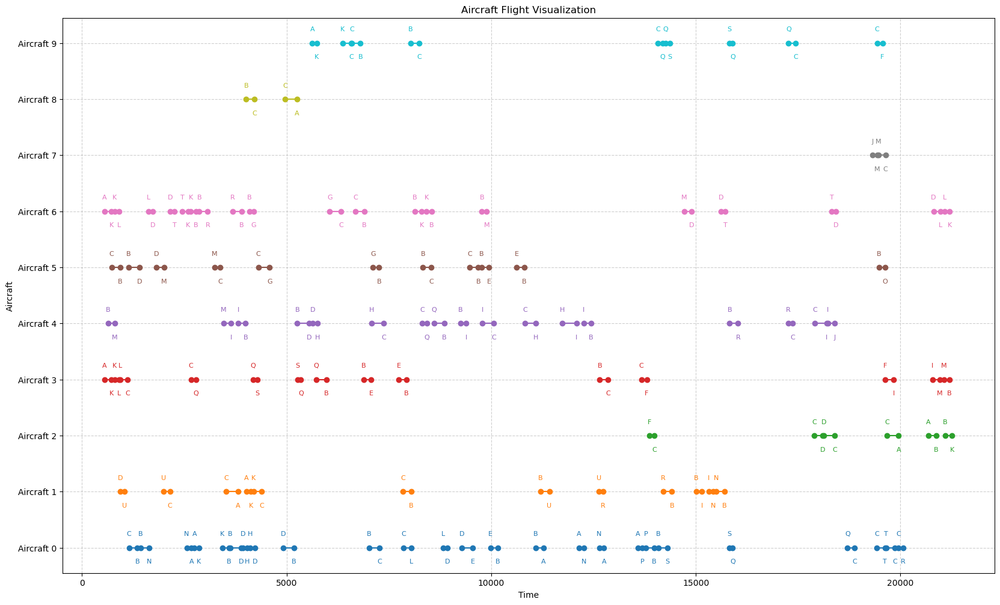

The optimal Cost provided is 966938.0
Le coût à l'optimal a pour valeur:  1489374.0


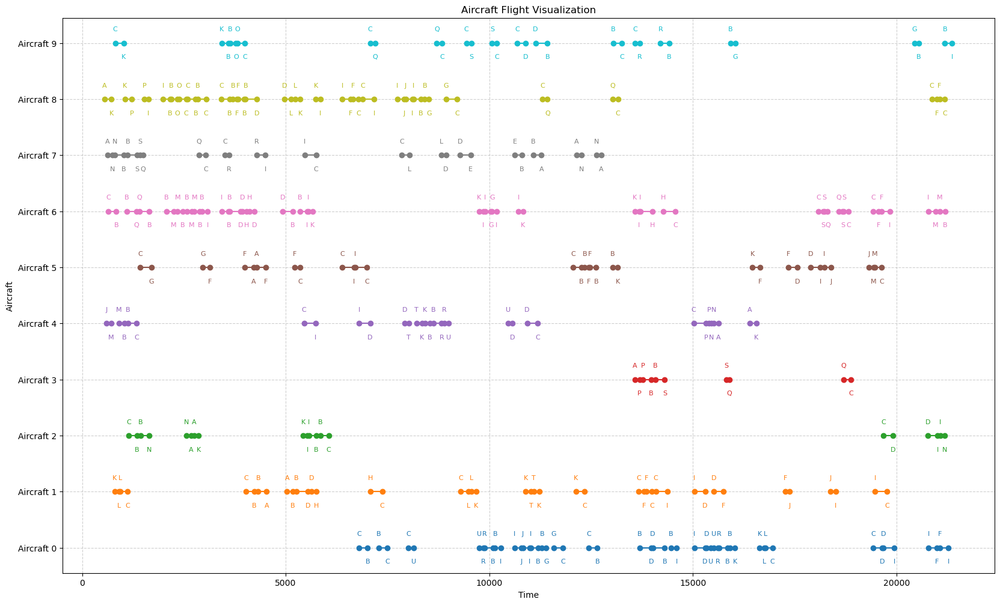

The optimal Cost provided is 1489374.0
Le coût à l'optimal a pour valeur:  1356806.0


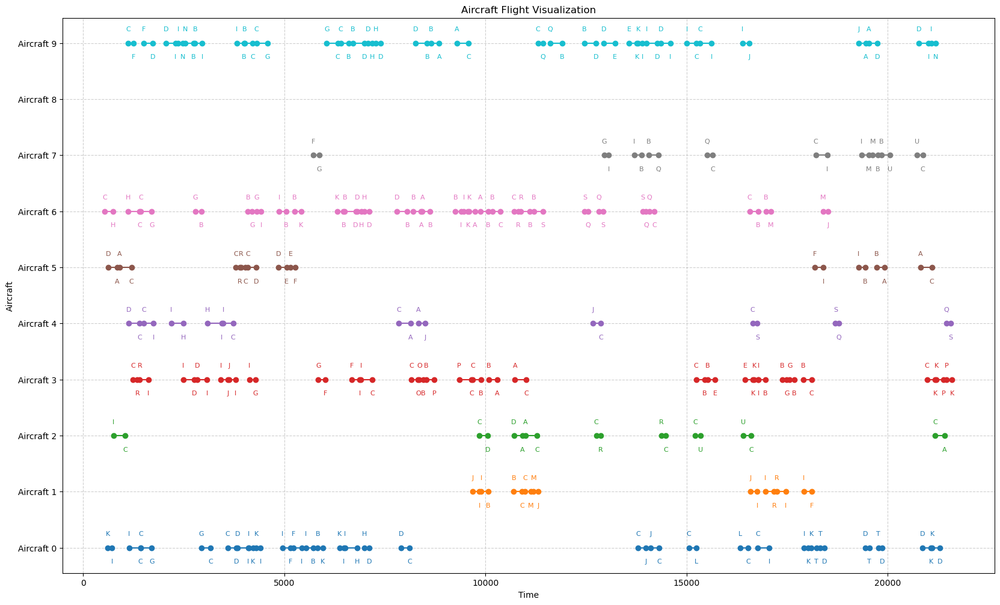

The optimal Cost provided is 1356806.0
Le coût à l'optimal a pour valeur:  1598231.0


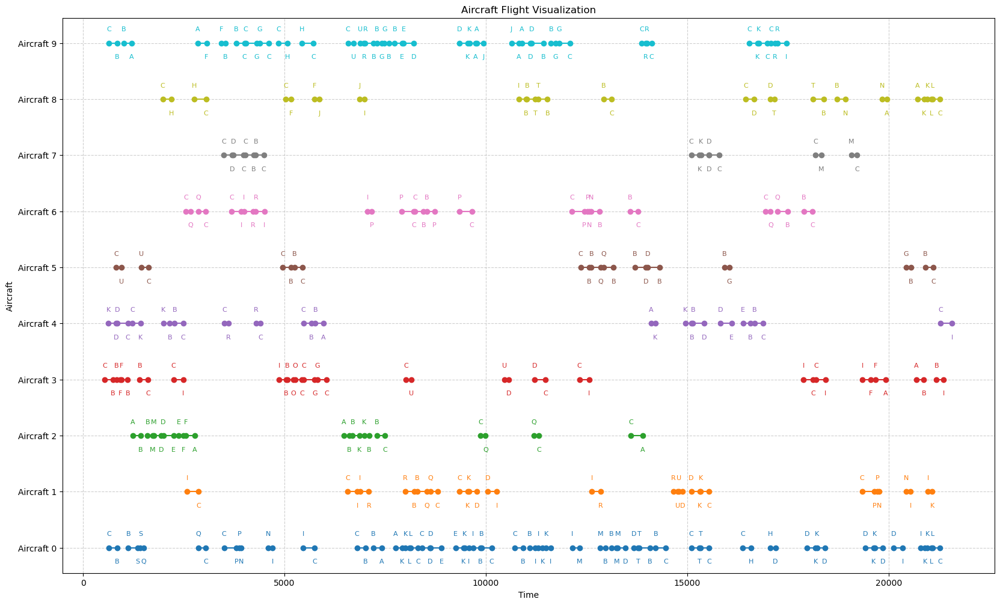

The optimal Cost provided is 1598231.0
Le coût à l'optimal a pour valeur:  1626888.0


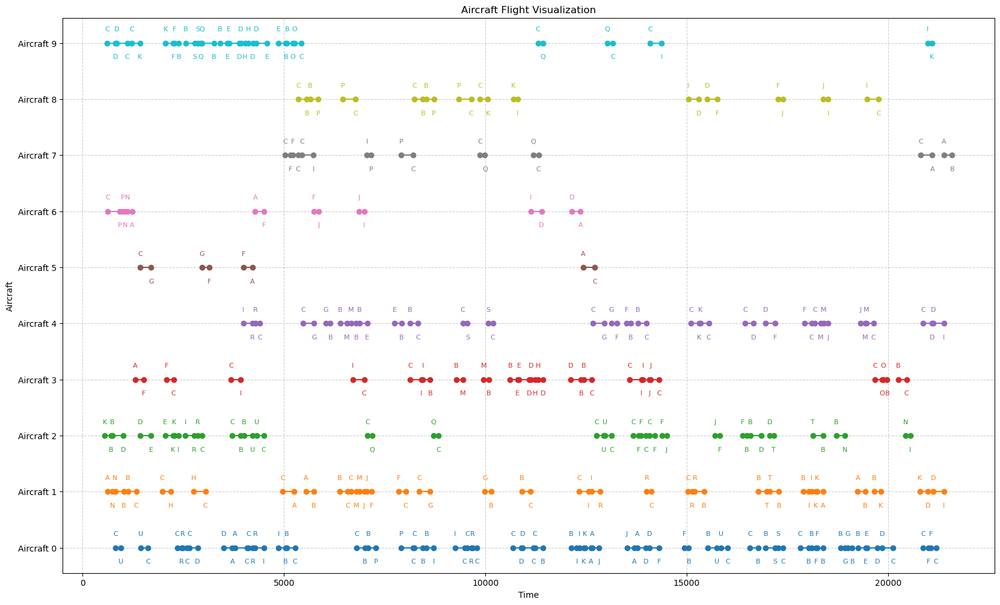

The optimal Cost provided is 1626888.0
Le coût à l'optimal a pour valeur:  1364847.0


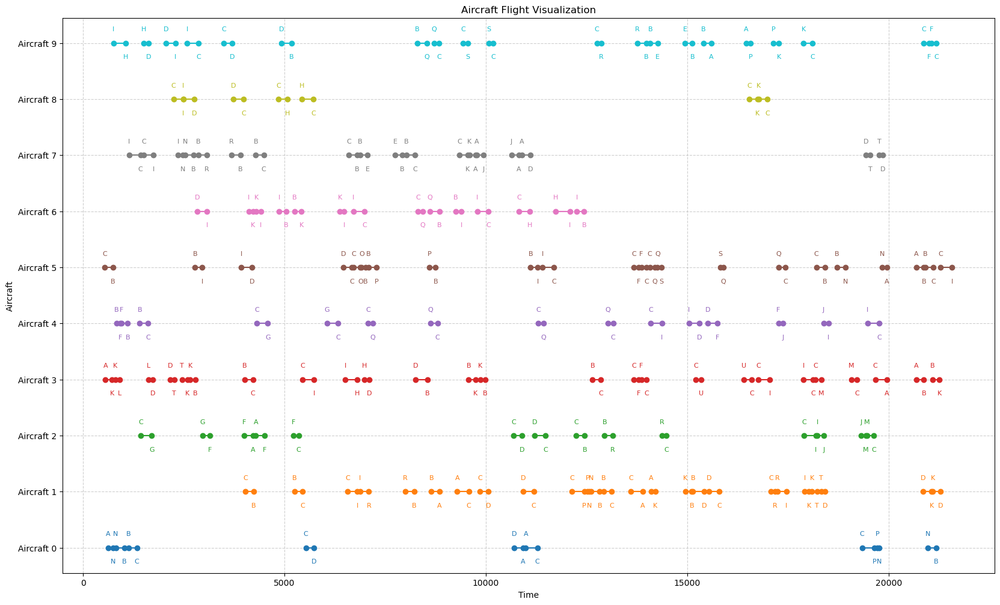

The optimal Cost provided is 1364847.0
Le coût à l'optimal a pour valeur:  1698636.0


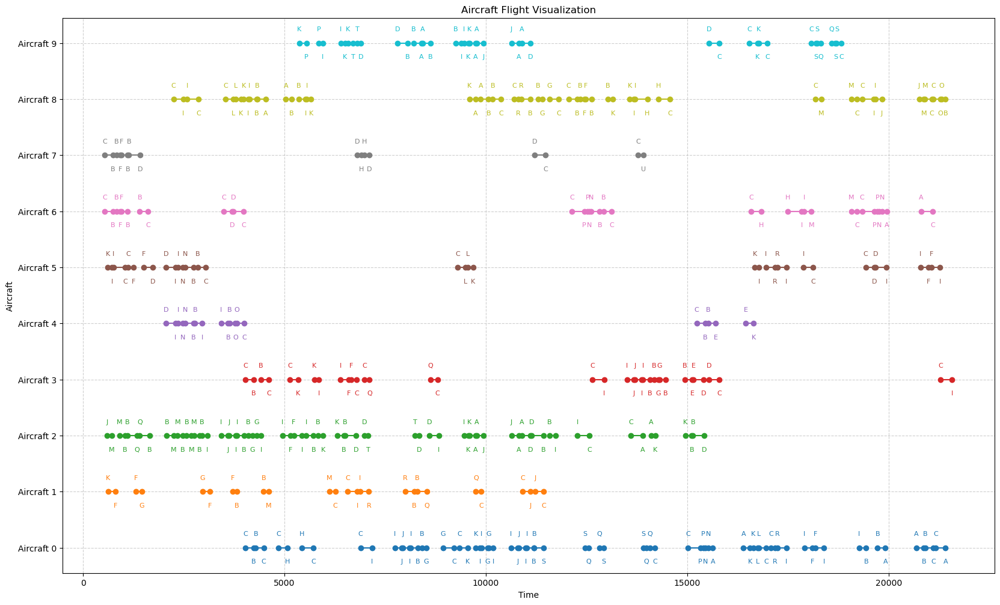

The optimal Cost provided is 1698636.0
Le coût à l'optimal a pour valeur:  1137029.0


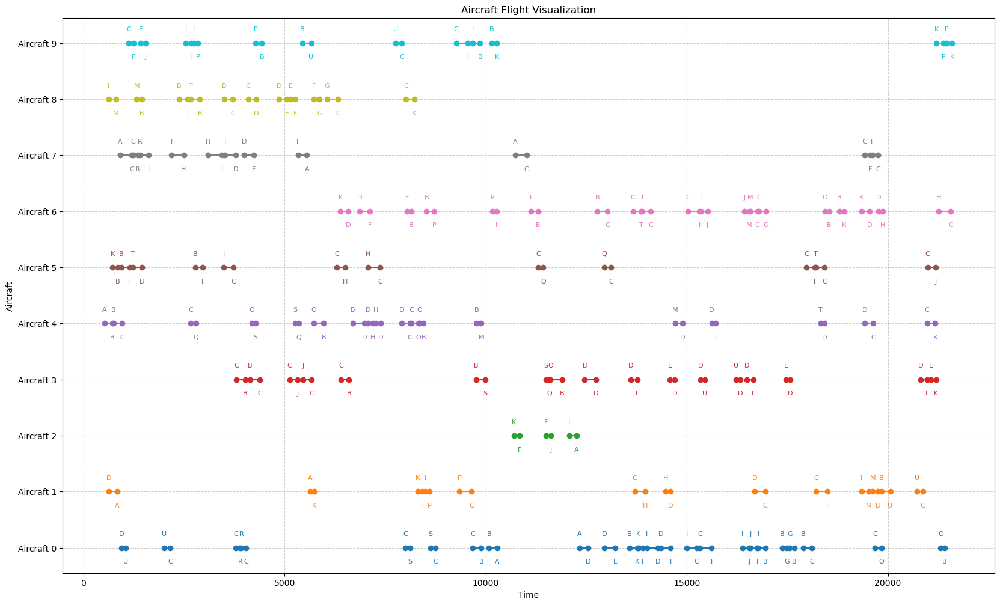

The optimal Cost provided is 1137029.0
Le coût à l'optimal a pour valeur:  2221799.0


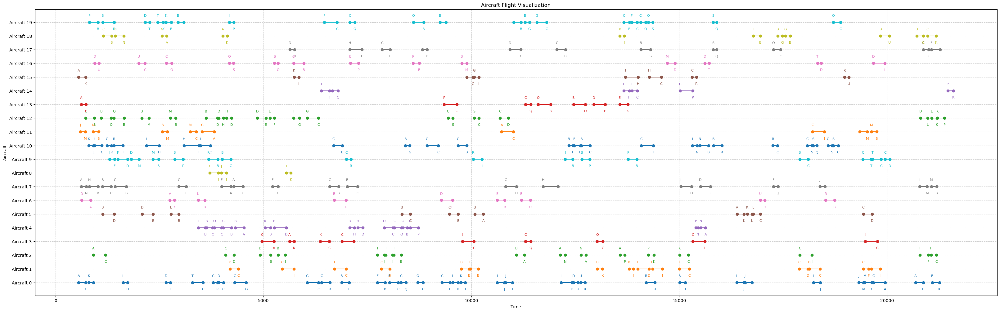

The optimal Cost provided is 2221799.0
Le coût à l'optimal a pour valeur:  2324011.0


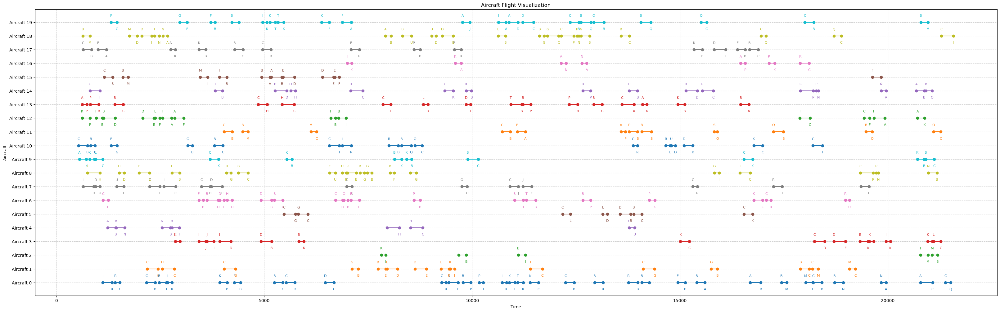

The optimal Cost provided is 2324011.0
Le coût à l'optimal a pour valeur:  2036737.0


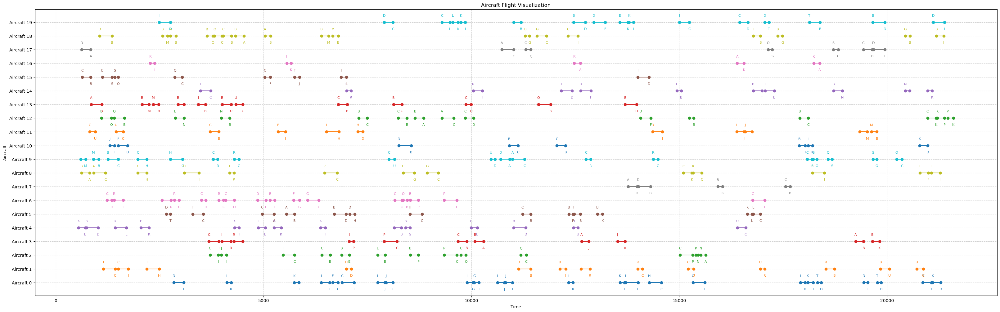

The optimal Cost provided is 2036737.0
Le coût à l'optimal a pour valeur:  2036737.0


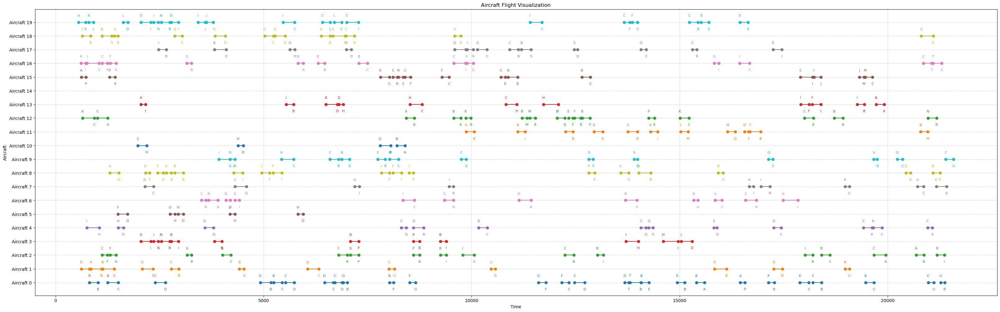

The optimal Cost provided is 2036737.0
Le coût à l'optimal a pour valeur:  2538842.0


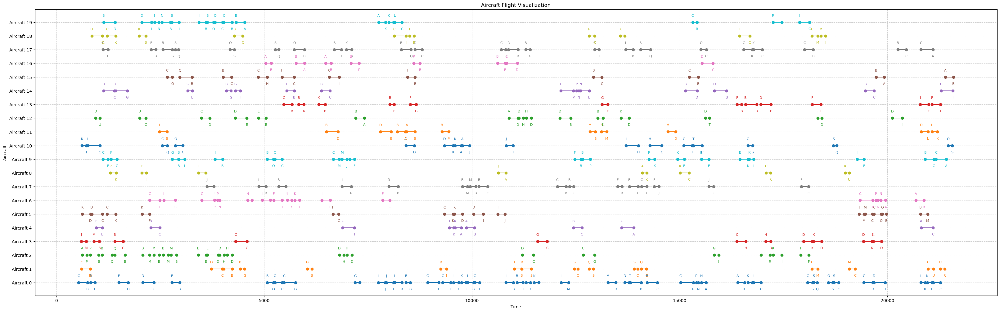

The optimal Cost provided is 2538842.0
Le coût à l'optimal a pour valeur:  2559451.0


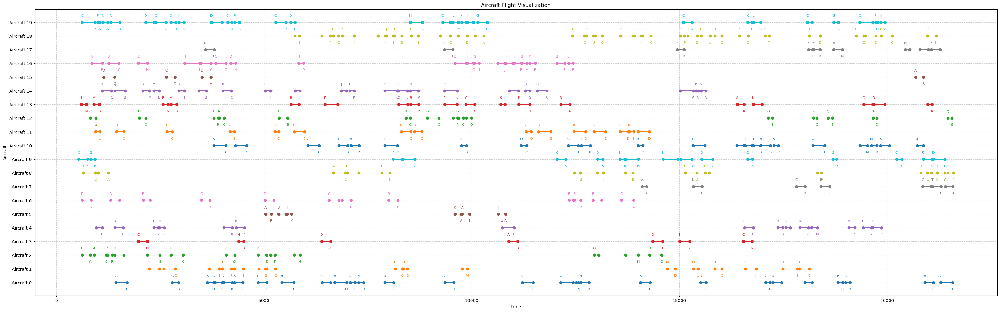

The optimal Cost provided is 2559451.0
Le coût à l'optimal a pour valeur:  1758830.0


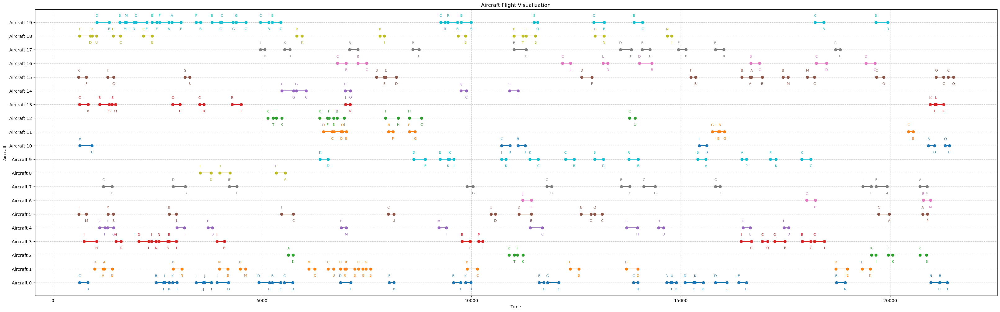

The optimal Cost provided is 1758830.0
Le coût à l'optimal a pour valeur:  2959970.0


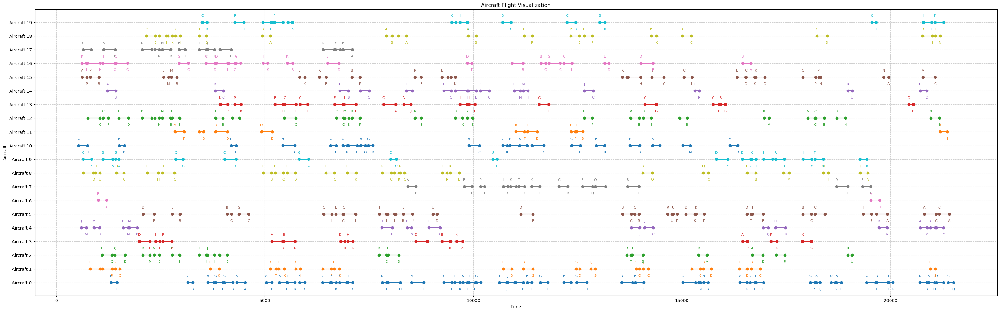

The optimal Cost provided is 2959970.0
Le coût à l'optimal a pour valeur:  1715114.0


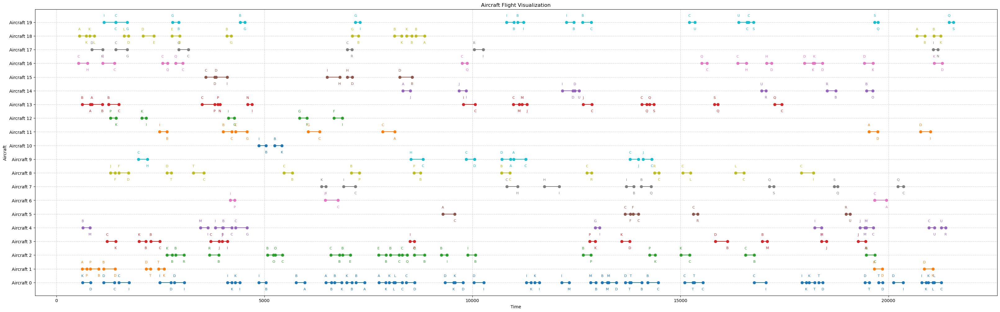

The optimal Cost provided is 1715114.0
Le coût à l'optimal a pour valeur:  2341705.0


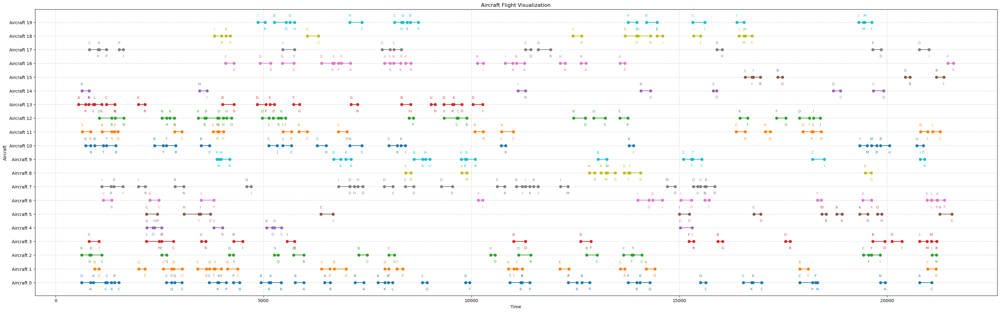

The optimal Cost provided is 2341705.0
Le coût à l'optimal a pour valeur:  1098476.0


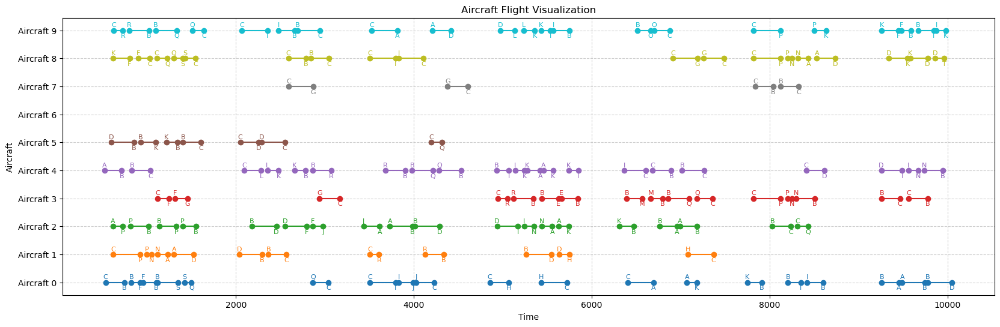

The optimal Cost provided is 1098476.0
Le coût à l'optimal a pour valeur:  1098476.0


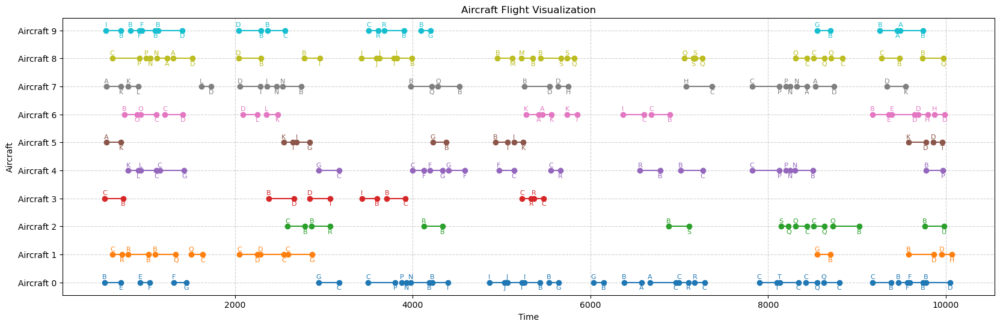

The optimal Cost provided is 1098476.0
Le coût à l'optimal a pour valeur:  837052.0


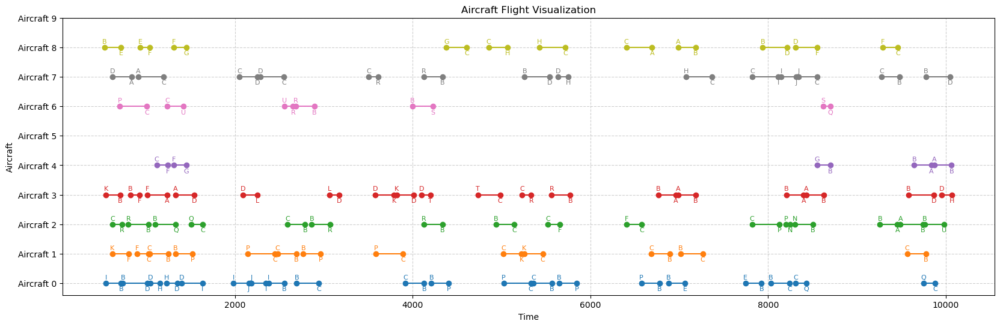

The optimal Cost provided is 837052.0
Le coût à l'optimal a pour valeur:  1239495.0


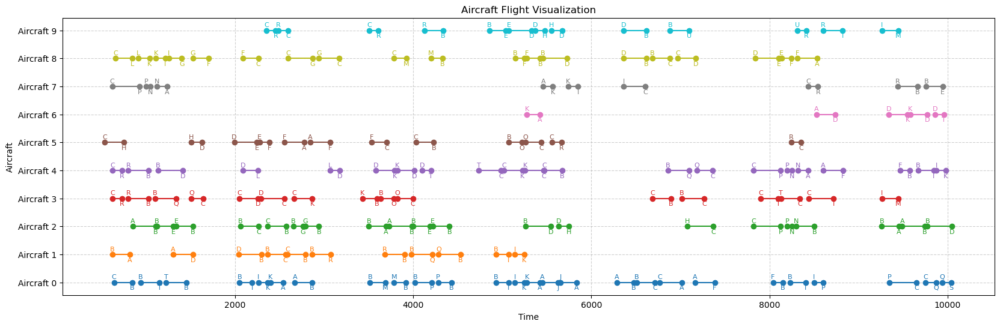

The optimal Cost provided is 1239495.0
Le coût à l'optimal a pour valeur:  1105073.0


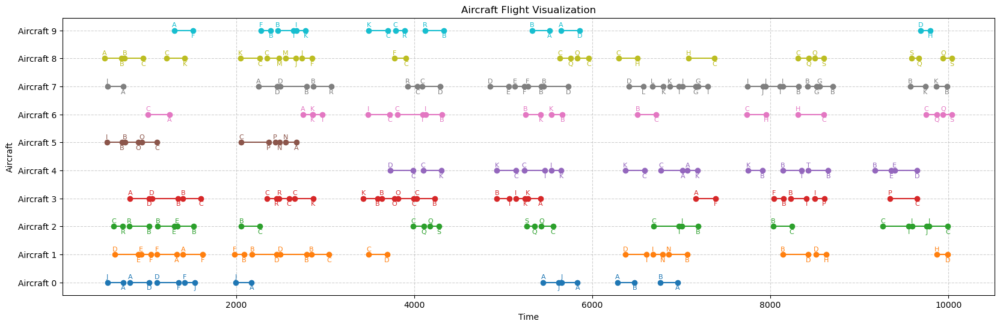

The optimal Cost provided is 1105073.0
Le coût à l'optimal a pour valeur:  974566.0


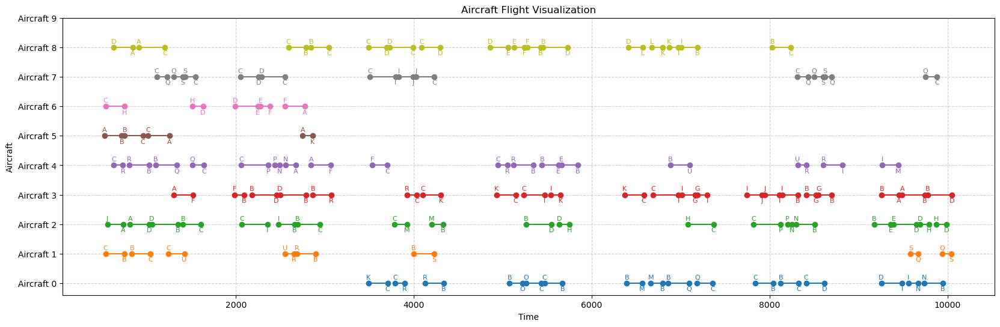

The optimal Cost provided is 974566.0
Le coût à l'optimal a pour valeur:  1272070.0


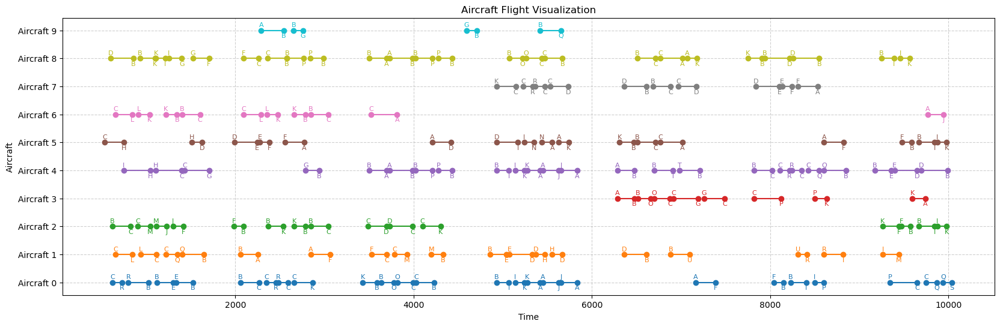

The optimal Cost provided is 1272070.0
Le coût à l'optimal a pour valeur:  1323200.0


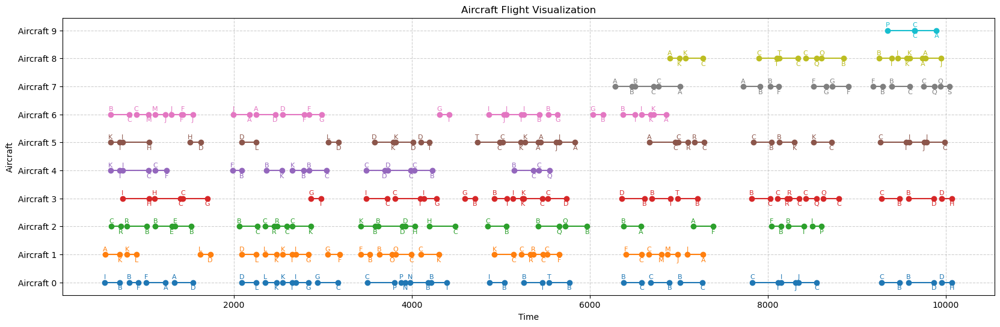

The optimal Cost provided is 1323200.0
Le coût à l'optimal a pour valeur:  1293099.0


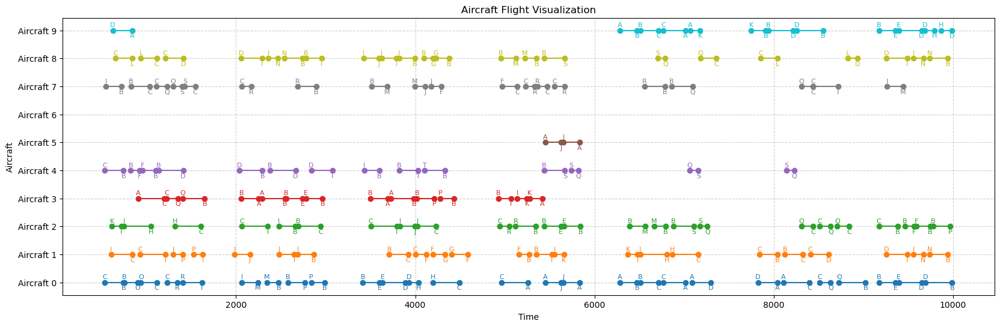

The optimal Cost provided is 1293099.0
Le coût à l'optimal a pour valeur:  966938.0


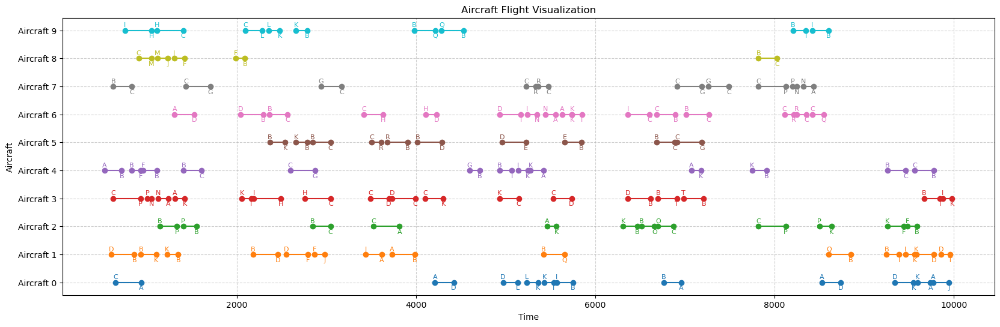

The optimal Cost provided is 966938.0
Le coût à l'optimal a pour valeur:  2171423.0


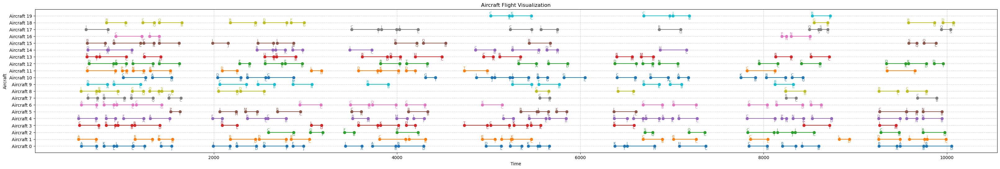

The optimal Cost provided is 2171423.0
Le coût à l'optimal a pour valeur:  2145402.0


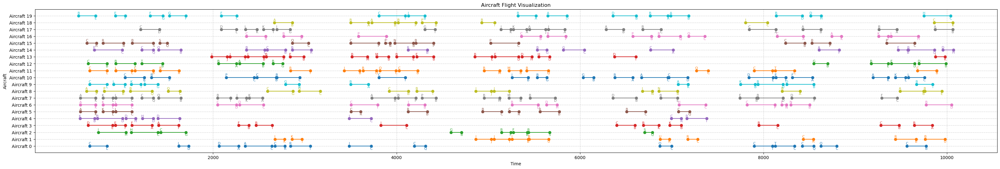

The optimal Cost provided is 2145402.0
Le coût à l'optimal a pour valeur:  1892474.0


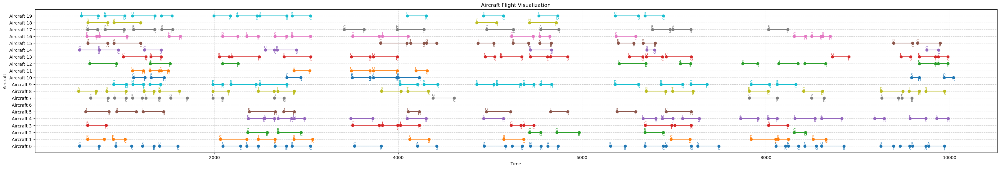

The optimal Cost provided is 1892474.0
Le coût à l'optimal a pour valeur:  2373764.0


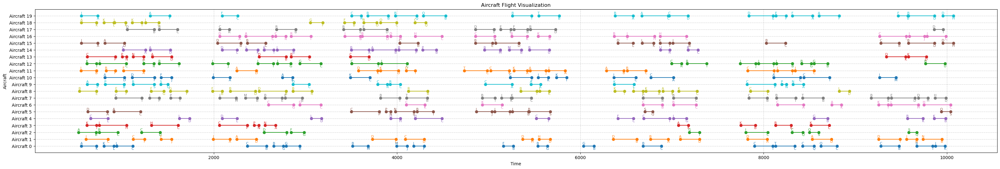

The optimal Cost provided is 2373764.0
Le coût à l'optimal a pour valeur:  2622943.0


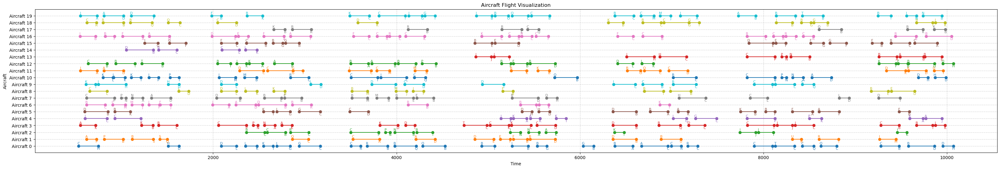

The optimal Cost provided is 2622943.0
Le coût à l'optimal a pour valeur:  2293618.0


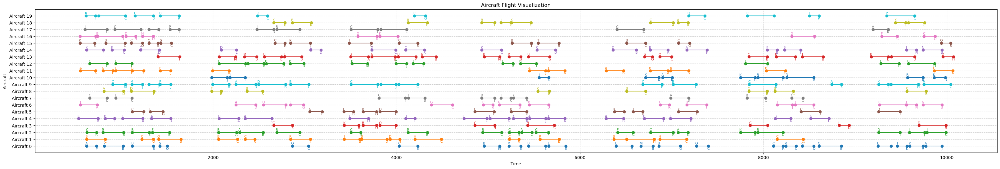

The optimal Cost provided is 2293618.0
Le coût à l'optimal a pour valeur:  2301320.0


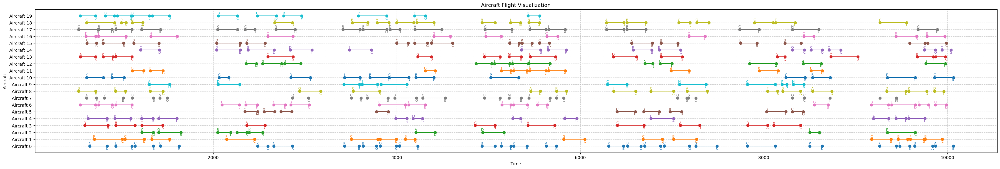

The optimal Cost provided is 2301320.0
Le coût à l'optimal a pour valeur:  2373764.0


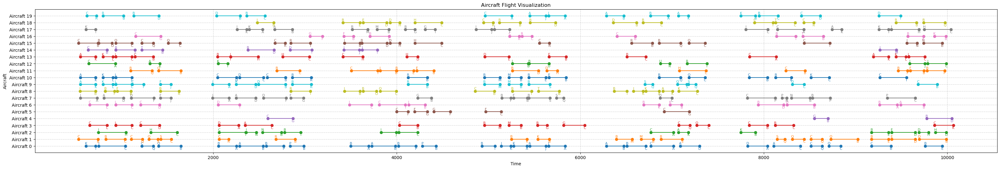

The optimal Cost provided is 2373764.0
Le coût à l'optimal a pour valeur:  2175378.0


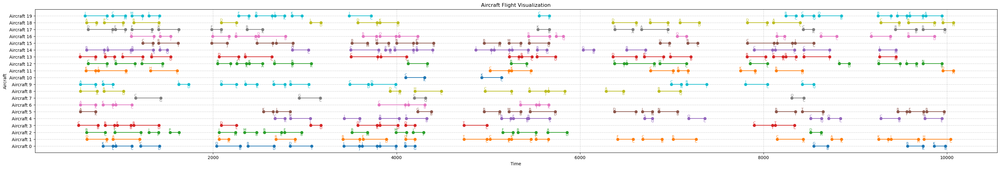

The optimal Cost provided is 2175378.0
Le coût à l'optimal a pour valeur:  2018209.0


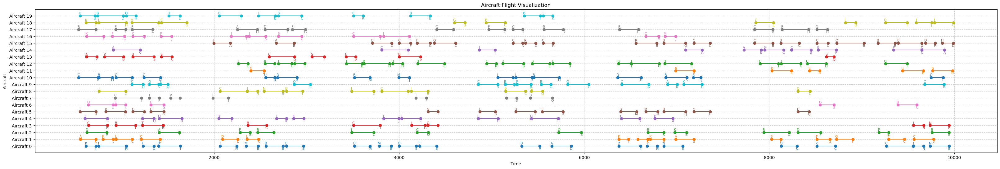

The optimal Cost provided is 2018209.0
Le coût à l'optimal a pour valeur:  2141696.0


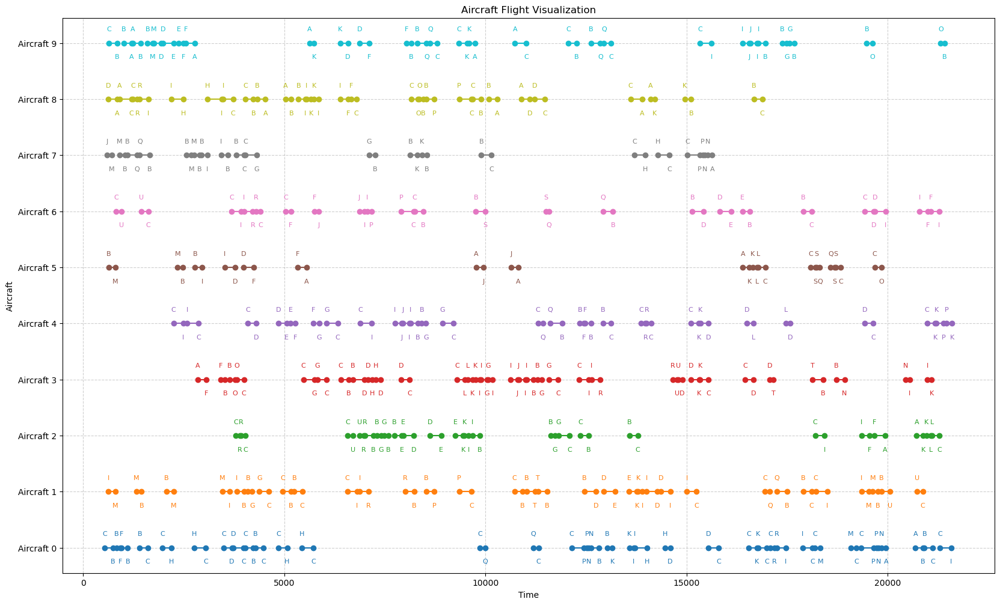

The optimal Cost provided is 2141696.0
Le coût à l'optimal a pour valeur:  1020336.0


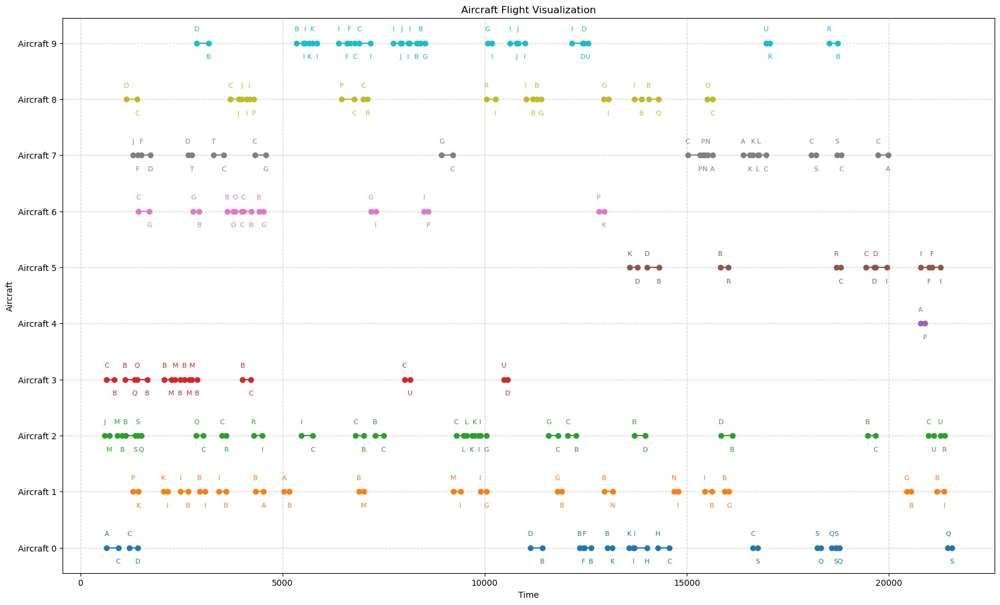

The optimal Cost provided is 1020336.0
Le coût à l'optimal a pour valeur:  1498239.0


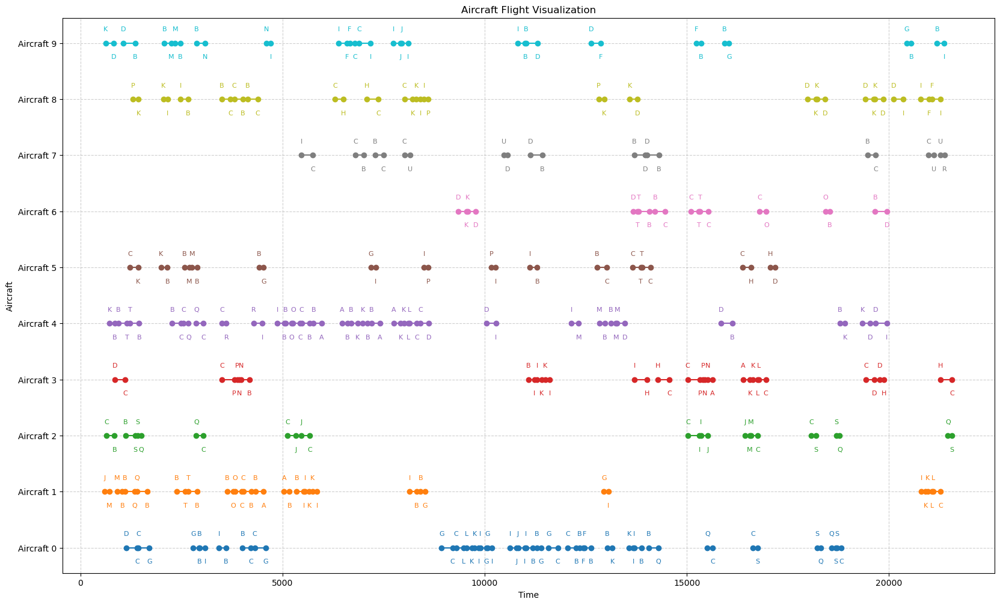

The optimal Cost provided is 1498239.0
Le coût à l'optimal a pour valeur:  2076959.0


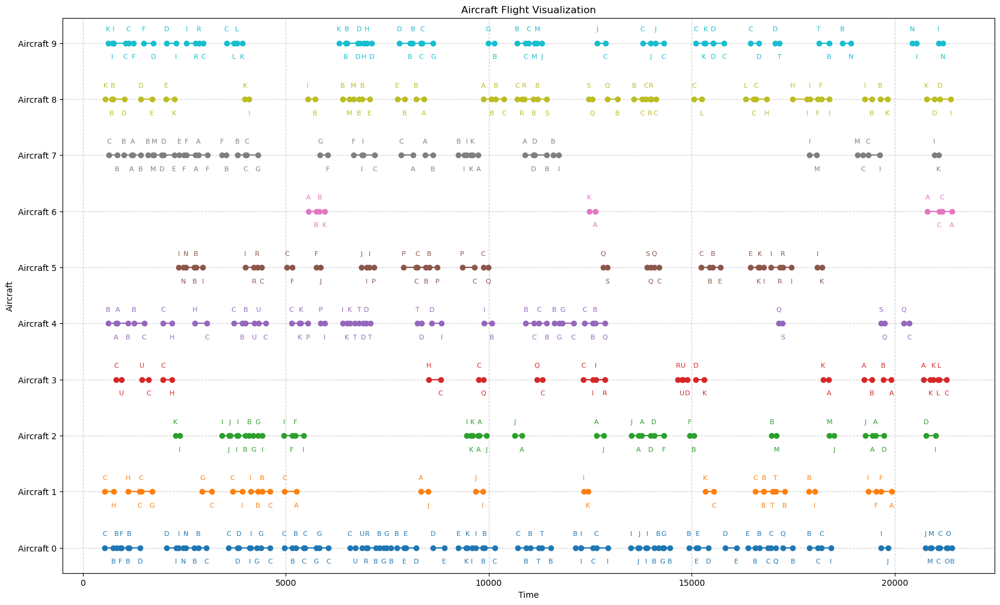

The optimal Cost provided is 2076959.0
Le coût à l'optimal a pour valeur:  1798629.0


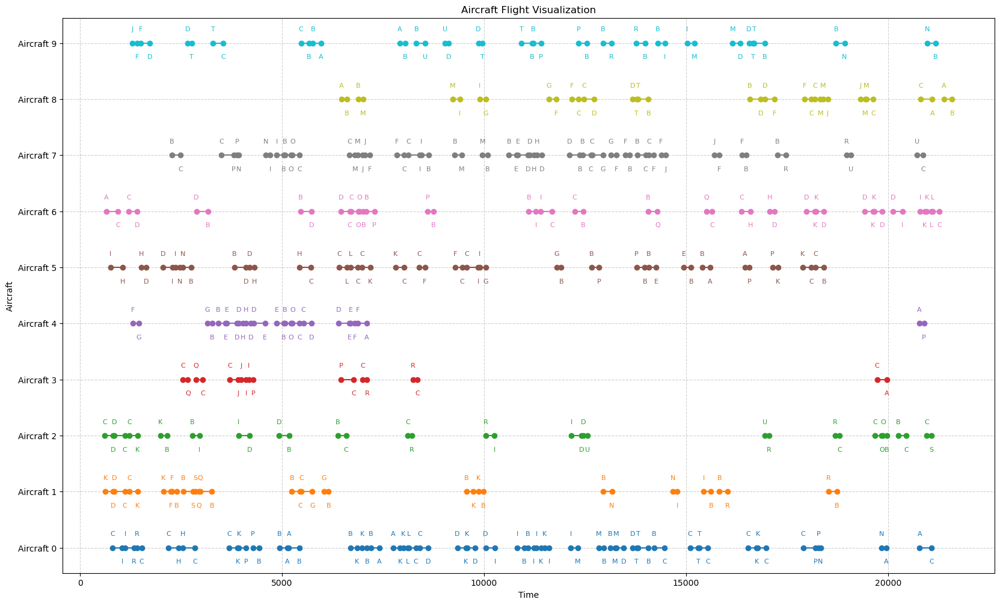

The optimal Cost provided is 1798629.0
Le coût à l'optimal a pour valeur:  1454737.0


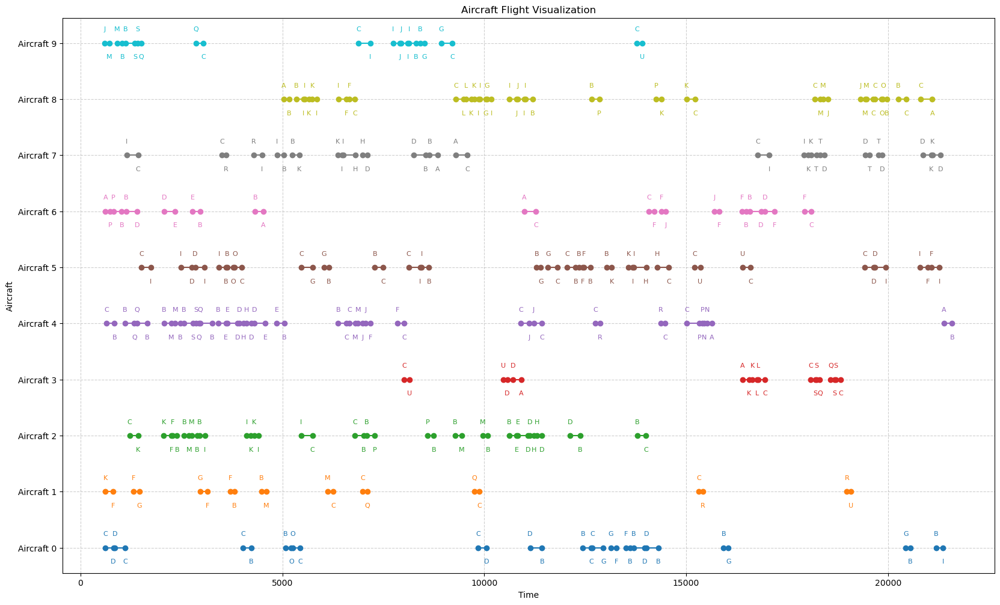

The optimal Cost provided is 1454737.0
Le coût à l'optimal a pour valeur:  1789351.0


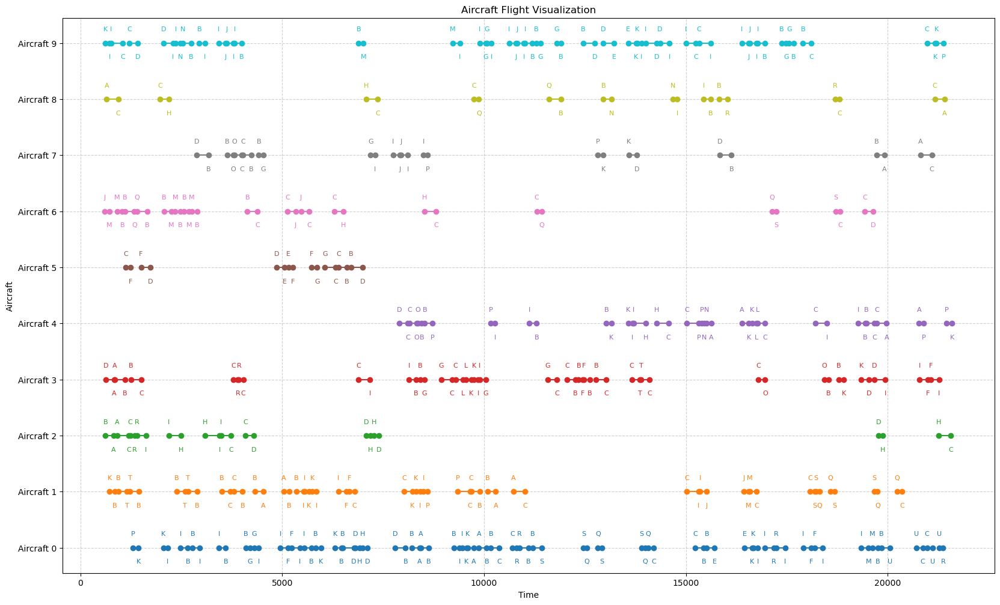

The optimal Cost provided is 1789351.0
Le coût à l'optimal a pour valeur:  1941504.0


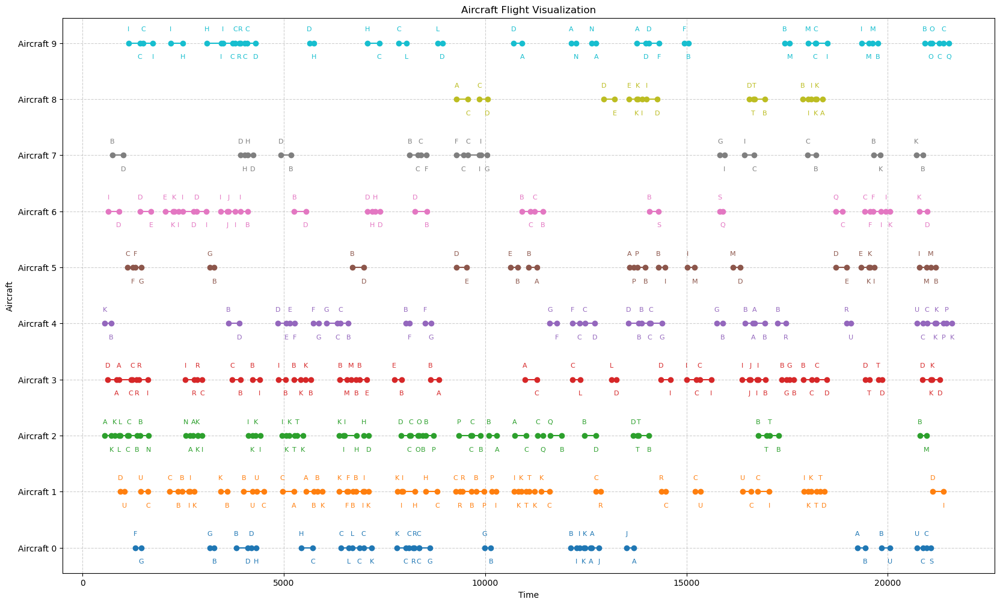

The optimal Cost provided is 1941504.0
Le coût à l'optimal a pour valeur:  2124790.0


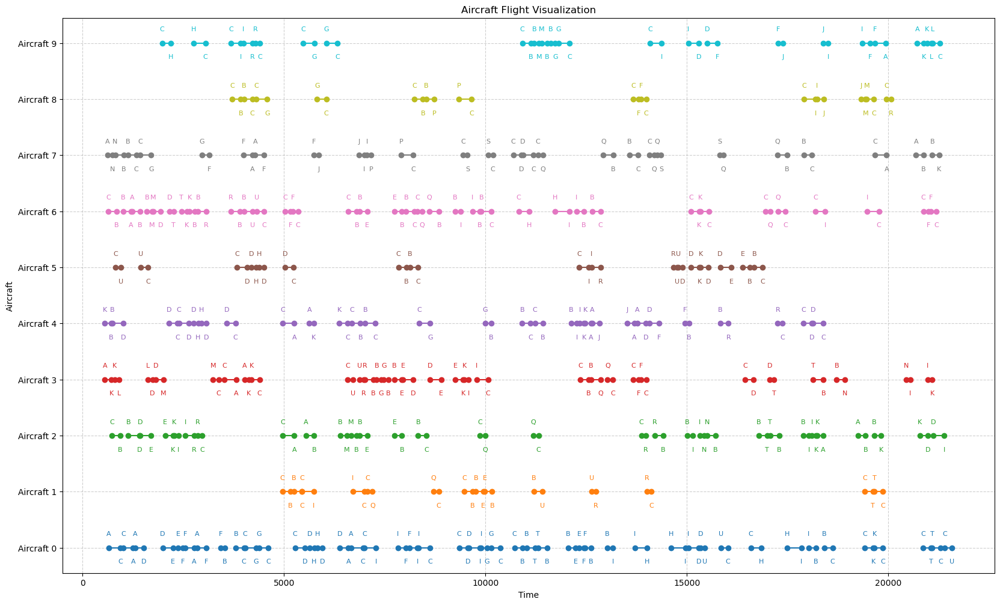

The optimal Cost provided is 2124790.0
Le coût à l'optimal a pour valeur:  1789351.0


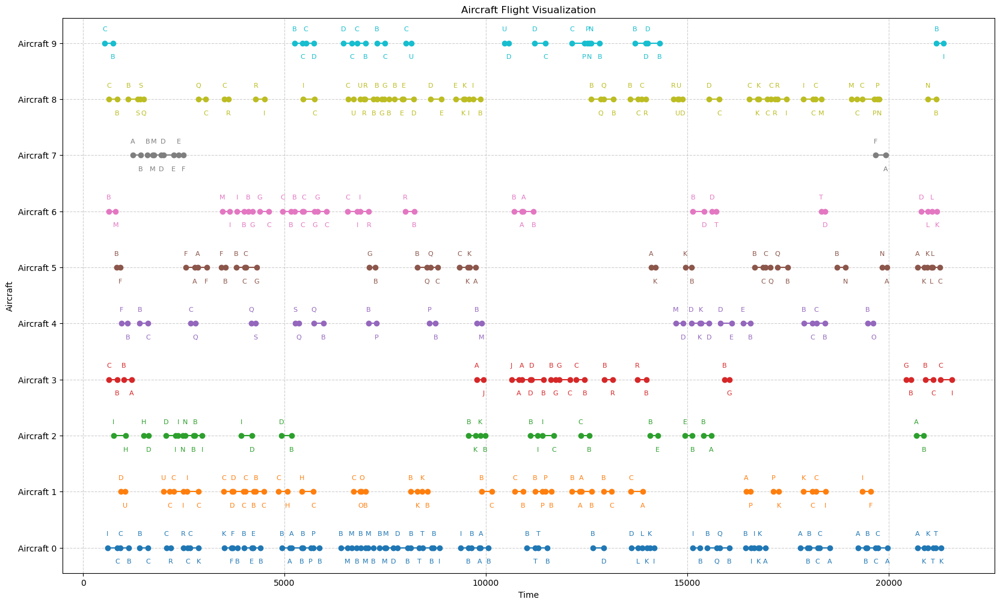

The optimal Cost provided is 1789351.0
Le coût à l'optimal a pour valeur:  4391577.0


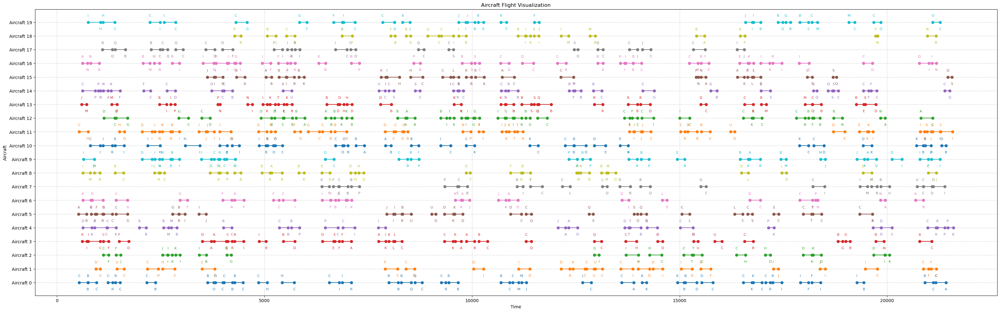

The optimal Cost provided is 4391577.0
Le coût à l'optimal a pour valeur:  3943073.0


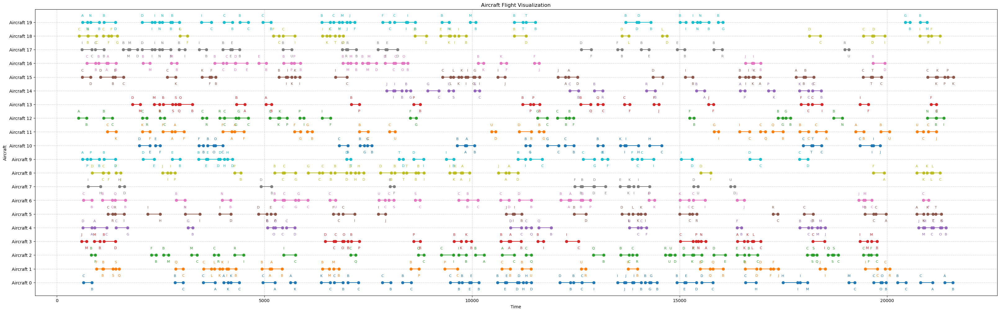

The optimal Cost provided is 3943073.0
Le coût à l'optimal a pour valeur:  3311405.0


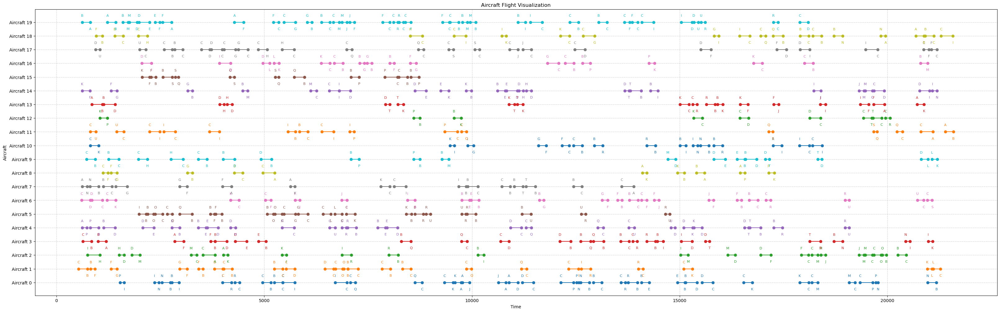

The optimal Cost provided is 3311405.0
Le coût à l'optimal a pour valeur:  4084455.0


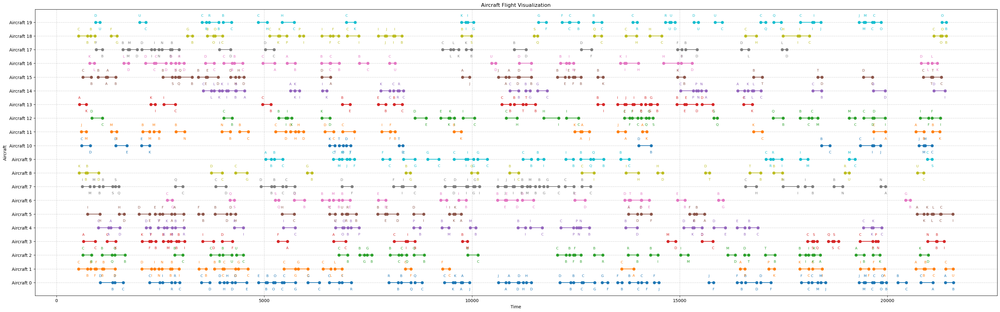

The optimal Cost provided is 4084455.0
Le coût à l'optimal a pour valeur:  3492325.0


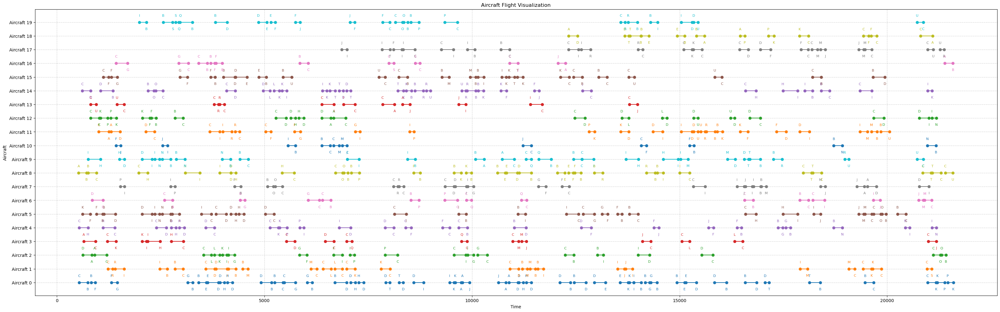

The optimal Cost provided is 3492325.0
Le coût à l'optimal a pour valeur:  3576434.0


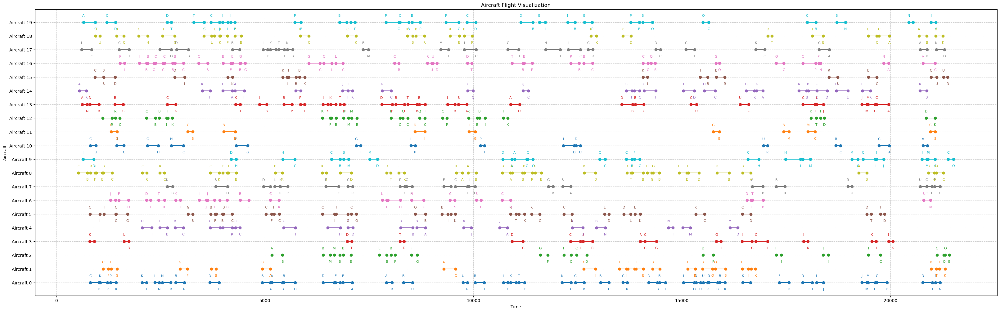

The optimal Cost provided is 3576434.0
Le coût à l'optimal a pour valeur:  2671030.0


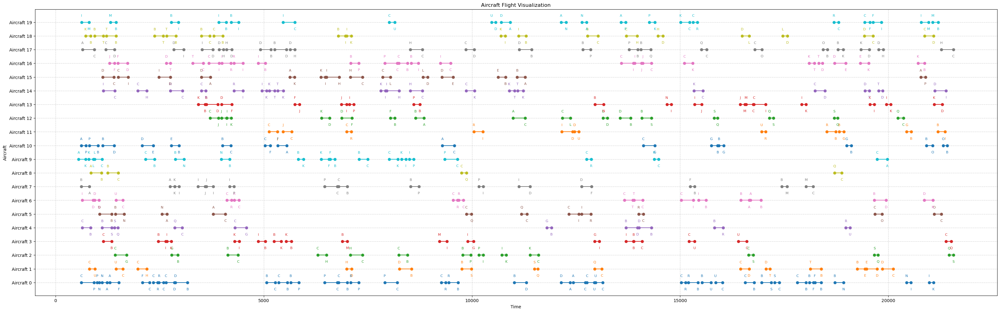

The optimal Cost provided is 2671030.0
Le coût à l'optimal a pour valeur:  4187939.0


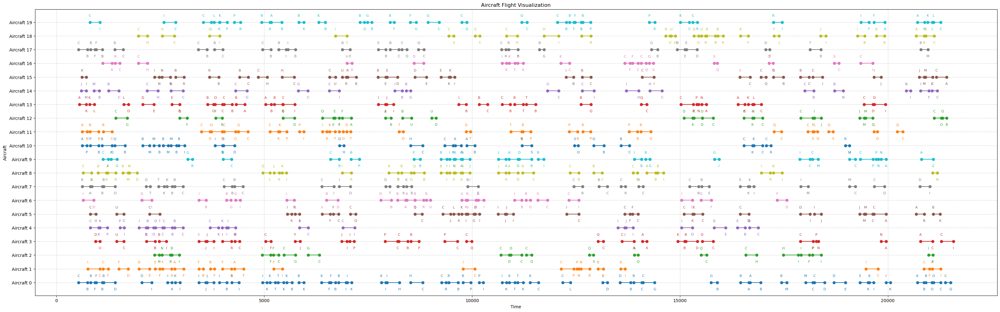

The optimal Cost provided is 4187939.0
Le coût à l'optimal a pour valeur:  3748198.0


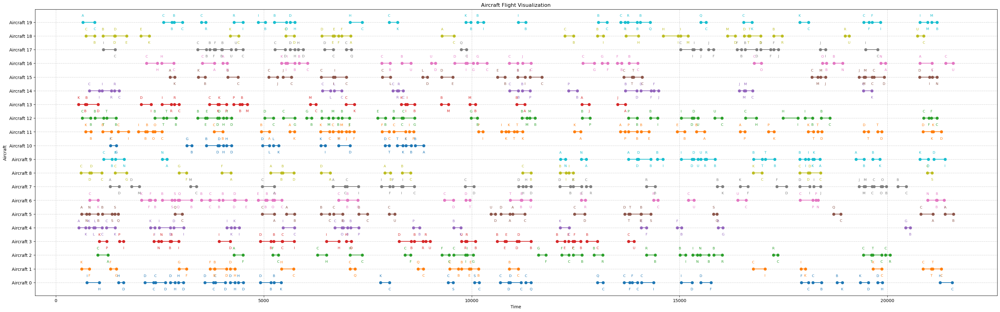

The optimal Cost provided is 3748198.0
Le coût à l'optimal a pour valeur:  3039295.0


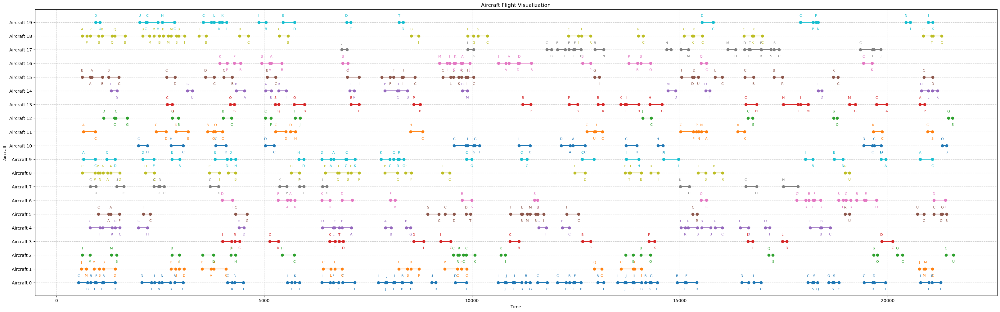

The optimal Cost provided is 3039295.0
Le coût à l'optimal a pour valeur:  1924392.0


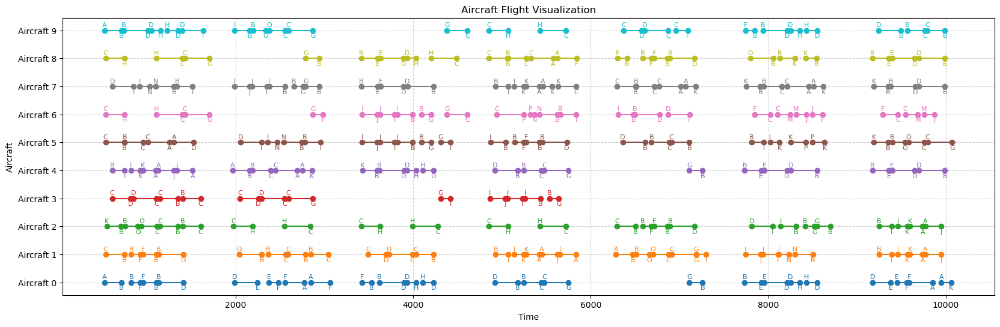

The optimal Cost provided is 1924392.0
Le coût à l'optimal a pour valeur:  1824400.0


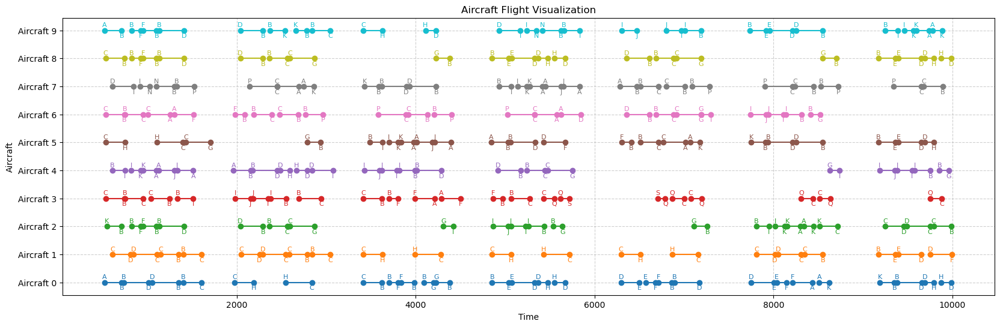

The optimal Cost provided is 1824400.0
Le coût à l'optimal a pour valeur:  1844192.0


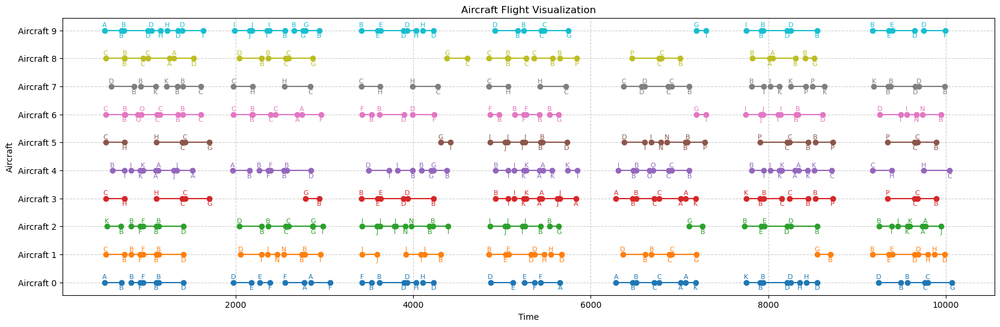

The optimal Cost provided is 1844192.0
Le coût à l'optimal a pour valeur:  1832234.0


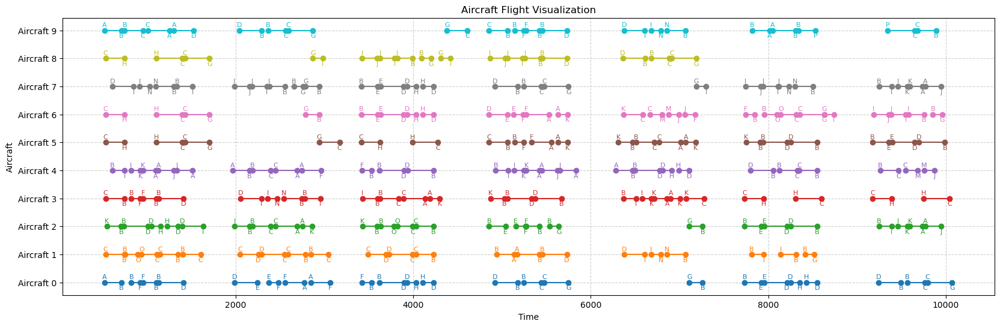

The optimal Cost provided is 1832234.0
Le coût à l'optimal a pour valeur:  1941504.0


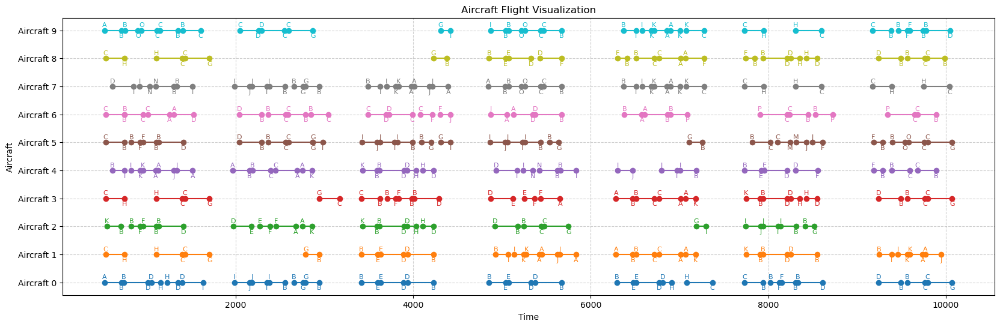

The optimal Cost provided is 1941504.0
Le coût à l'optimal a pour valeur:  1850789.0


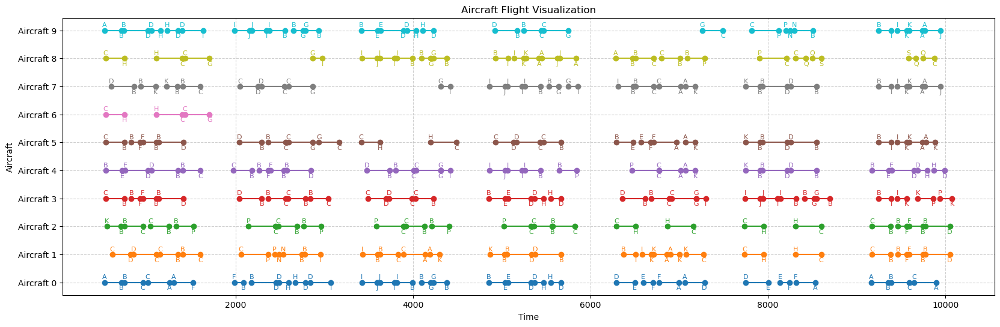

The optimal Cost provided is 1850789.0
Le coût à l'optimal a pour valeur:  1882539.0


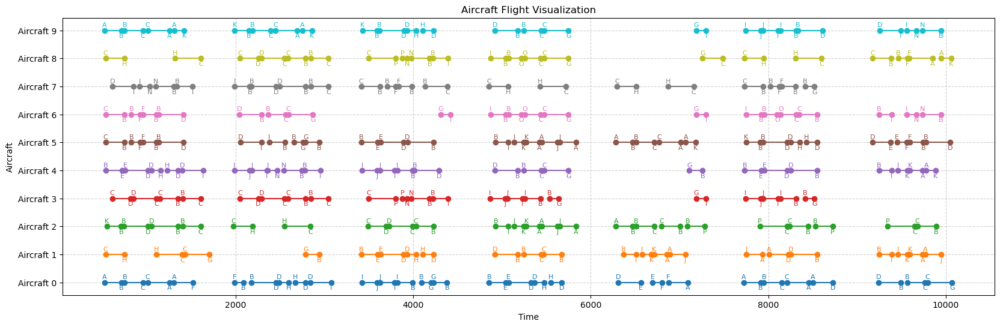

The optimal Cost provided is 1882539.0
Le coût à l'optimal a pour valeur:  1874292.0


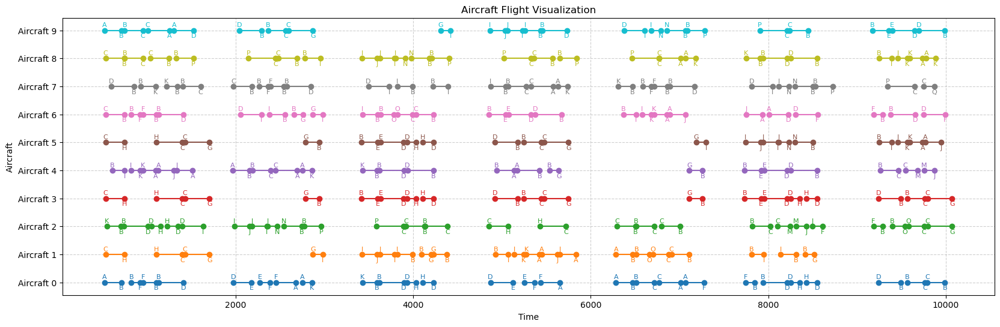

The optimal Cost provided is 1874292.0
Le coût à l'optimal a pour valeur:  1828317.0


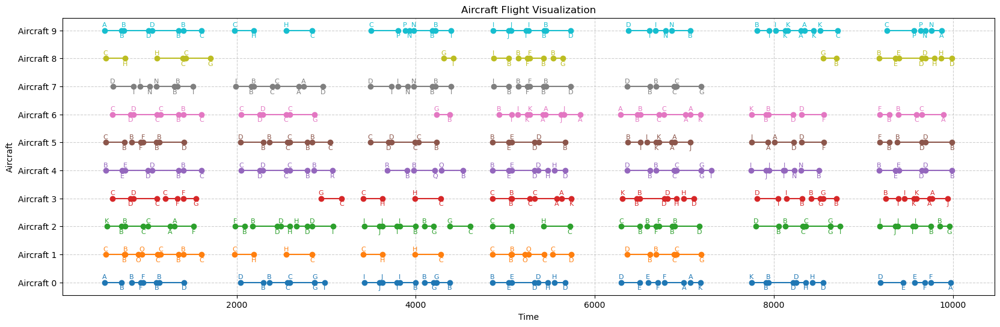

The optimal Cost provided is 1828317.0
Le coût à l'optimal a pour valeur:  1945421.0


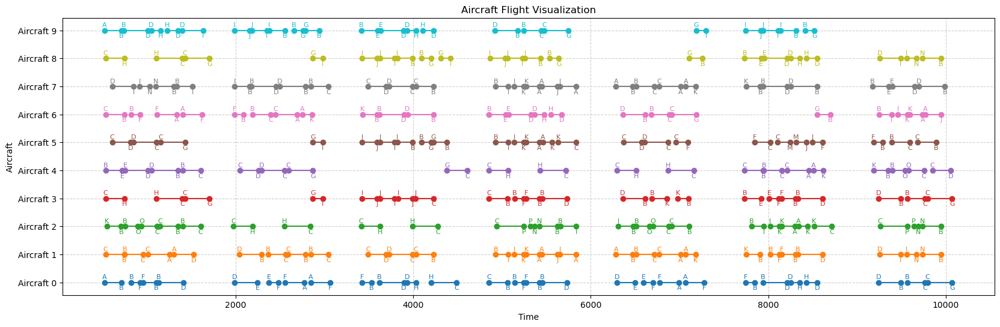

The optimal Cost provided is 1945421.0
Le coût à l'optimal a pour valeur:  3606833.0


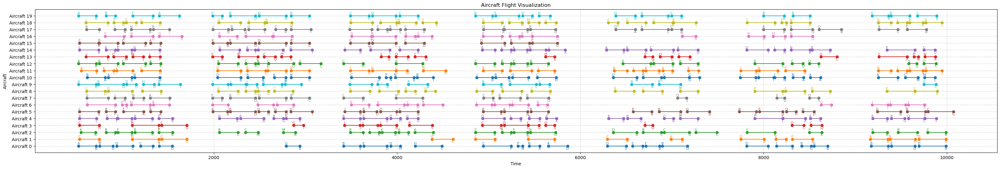

The optimal Cost provided is 3606833.0
Le coût à l'optimal a pour valeur:  3700313.0


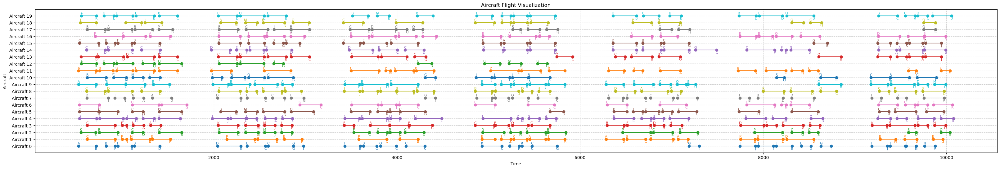

The optimal Cost provided is 3700313.0
Le coût à l'optimal a pour valeur:  3670334.0


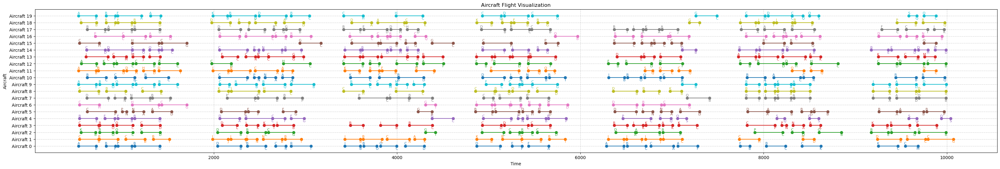

The optimal Cost provided is 3670334.0
Le coût à l'optimal a pour valeur:  3715929.0


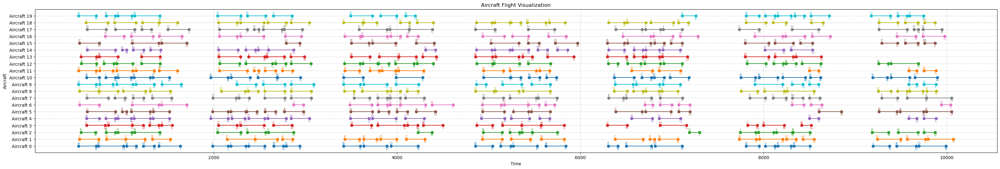

The optimal Cost provided is 3715929.0
Le coût à l'optimal a pour valeur:  3661174.0


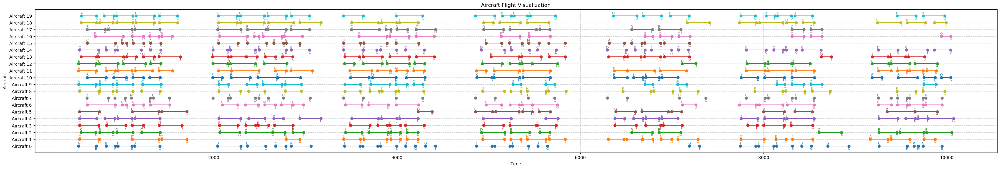

The optimal Cost provided is 3661174.0
Le coût à l'optimal a pour valeur:  3648890.0


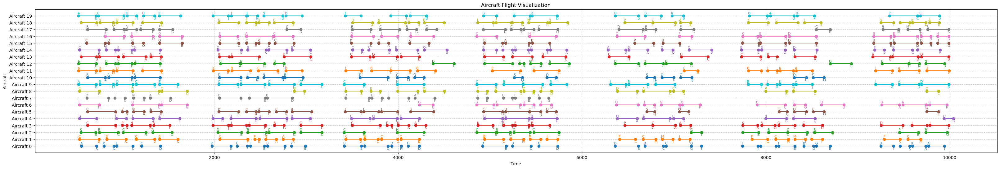

The optimal Cost provided is 3648890.0
Le coût à l'optimal a pour valeur:  3656593.0


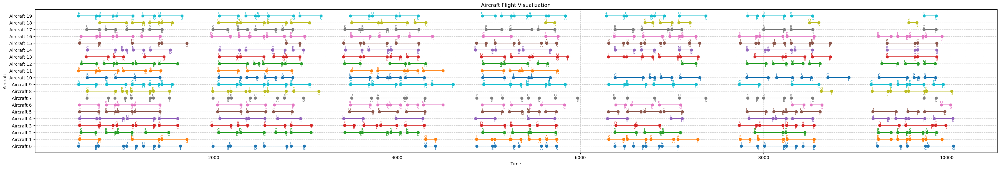

The optimal Cost provided is 3656593.0
Le coût à l'optimal a pour valeur:  3787547.0


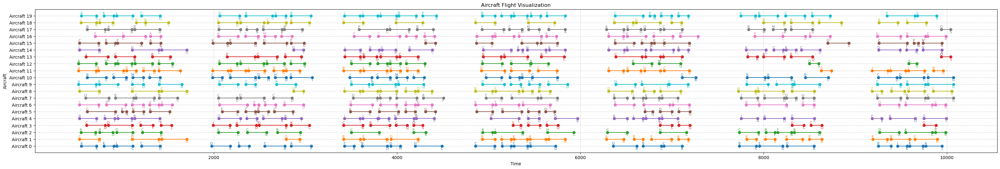

The optimal Cost provided is 3787547.0
Le coût à l'optimal a pour valeur:  3656593.0


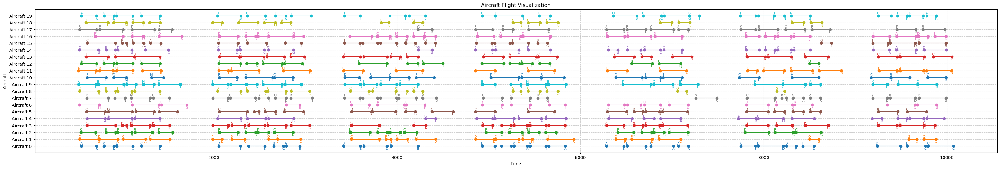

The optimal Cost provided is 3656593.0
Le coût à l'optimal a pour valeur:  3656593.0


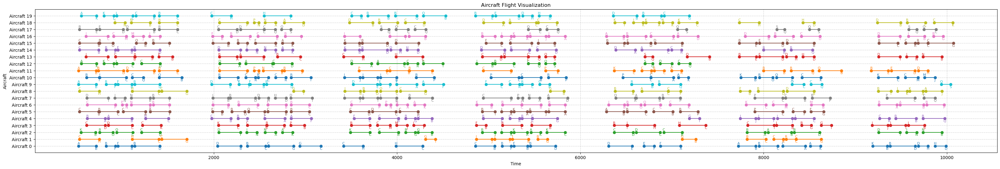

The optimal Cost provided is 3656593.0
Le coût à l'optimal a pour valeur:  3428876.0


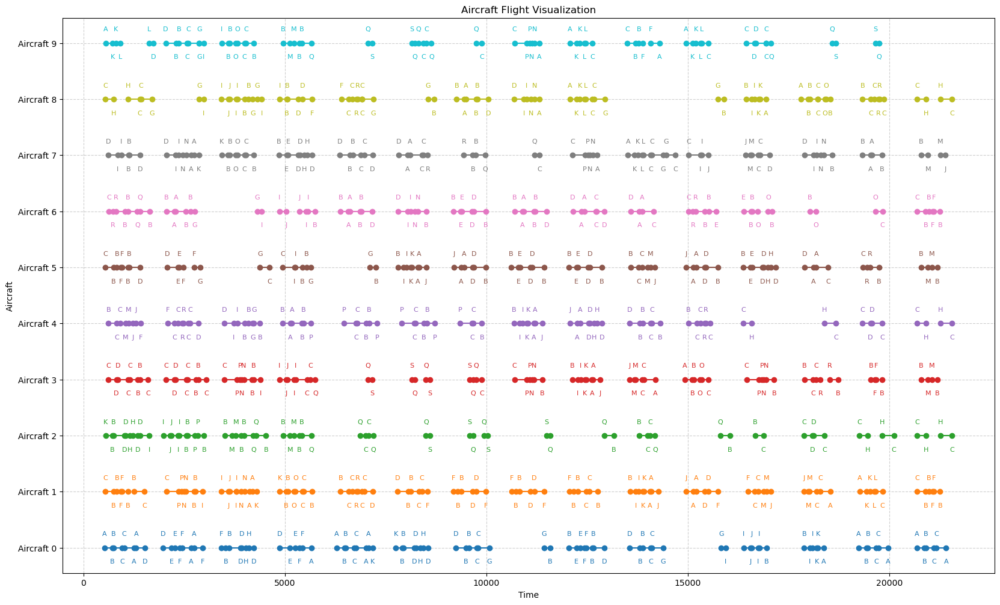

The optimal Cost provided is 3428876.0
Le coût à l'optimal a pour valeur:  3470938.0


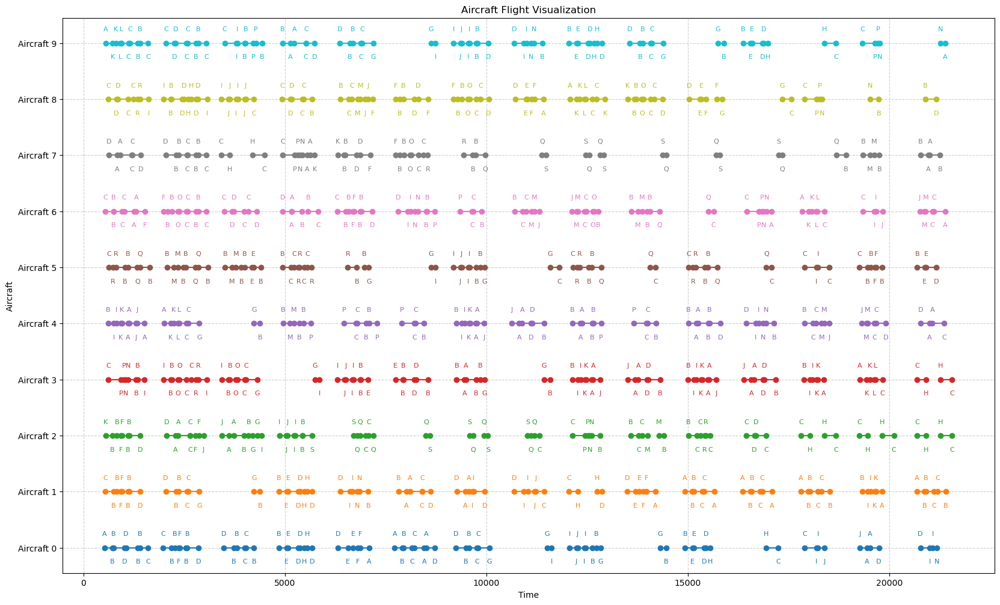

The optimal Cost provided is 3470938.0
Le coût à l'optimal a pour valeur:  3354028.0


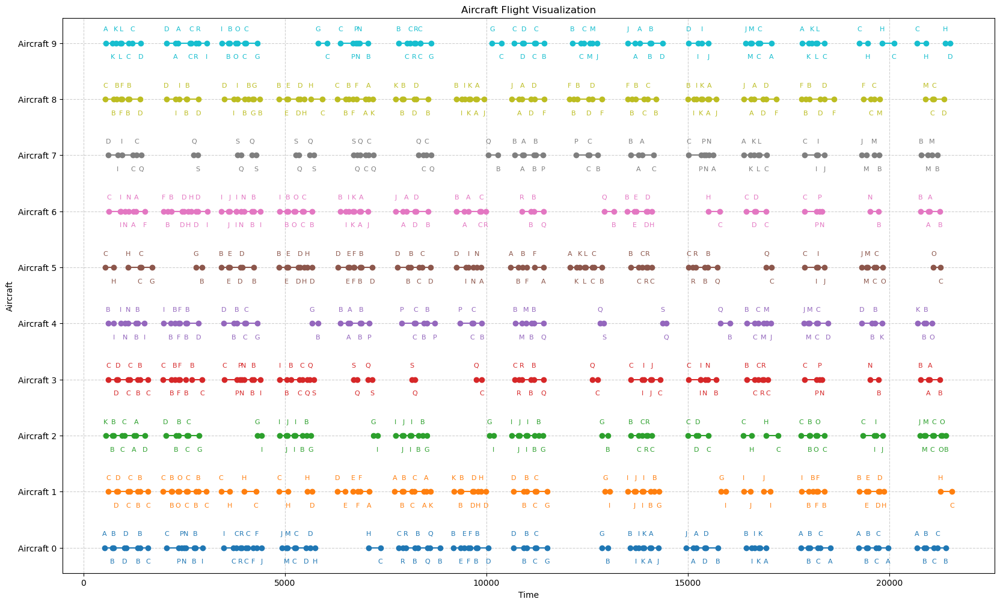

The optimal Cost provided is 3354028.0
Le coût à l'optimal a pour valeur:  3377533.0


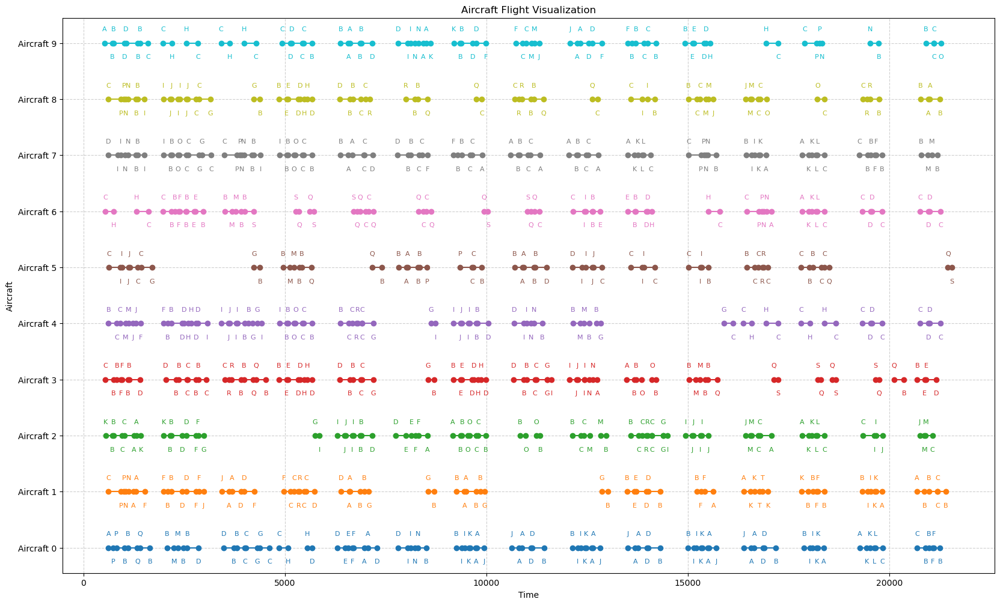

The optimal Cost provided is 3377533.0
Le coût à l'optimal a pour valeur:  3404957.0


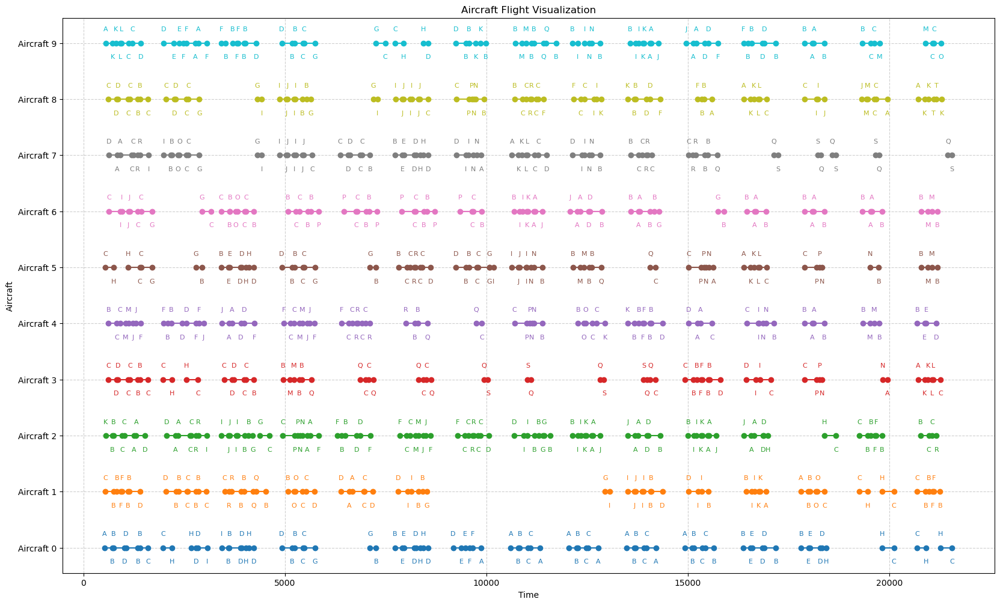

The optimal Cost provided is 3404957.0
Le coût à l'optimal a pour valeur:  3342893.0


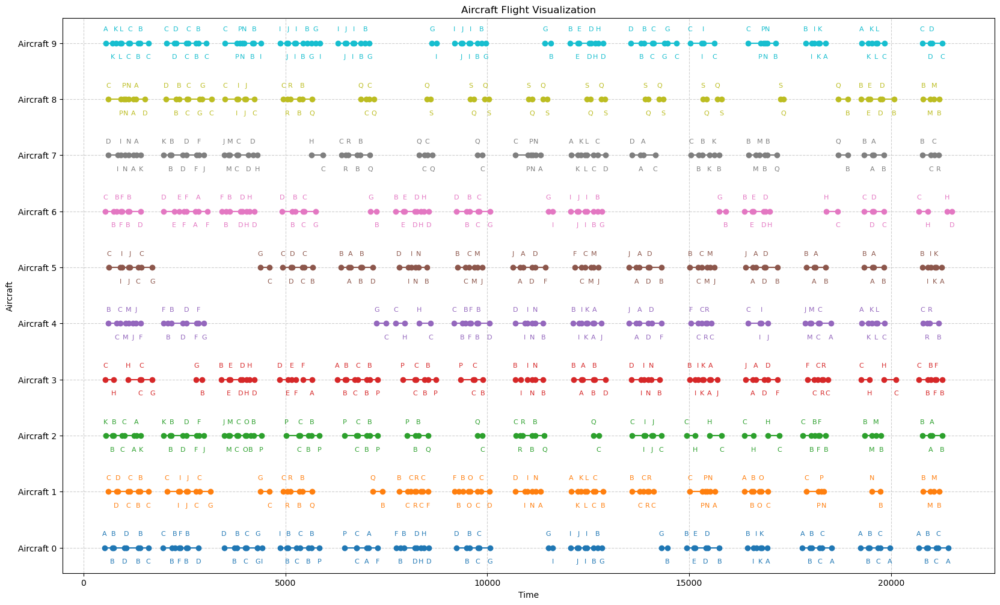

The optimal Cost provided is 3342893.0
Le coût à l'optimal a pour valeur:  3424958.0


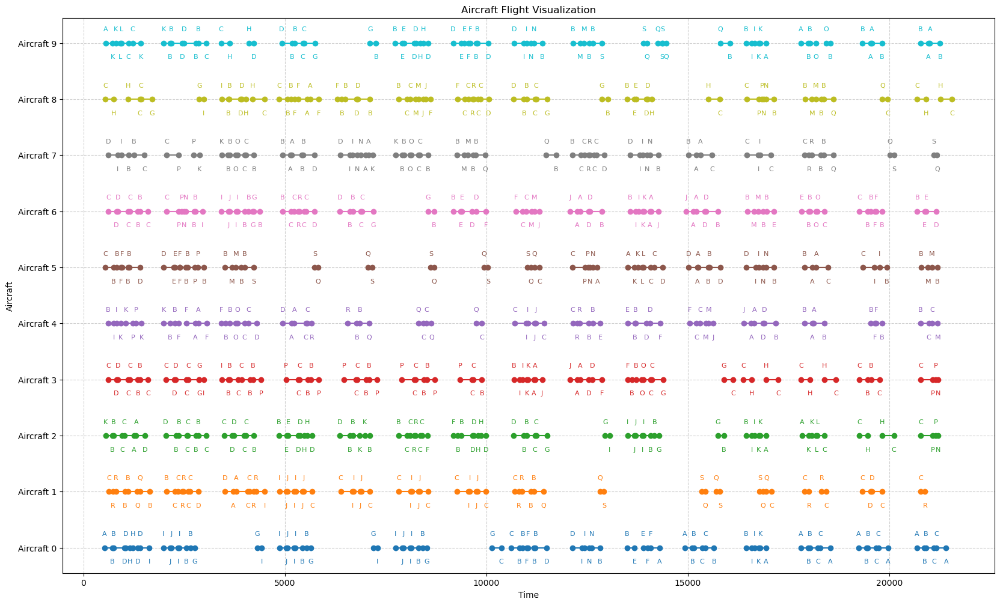

The optimal Cost provided is 3424958.0
Le coût à l'optimal a pour valeur:  3412174.0


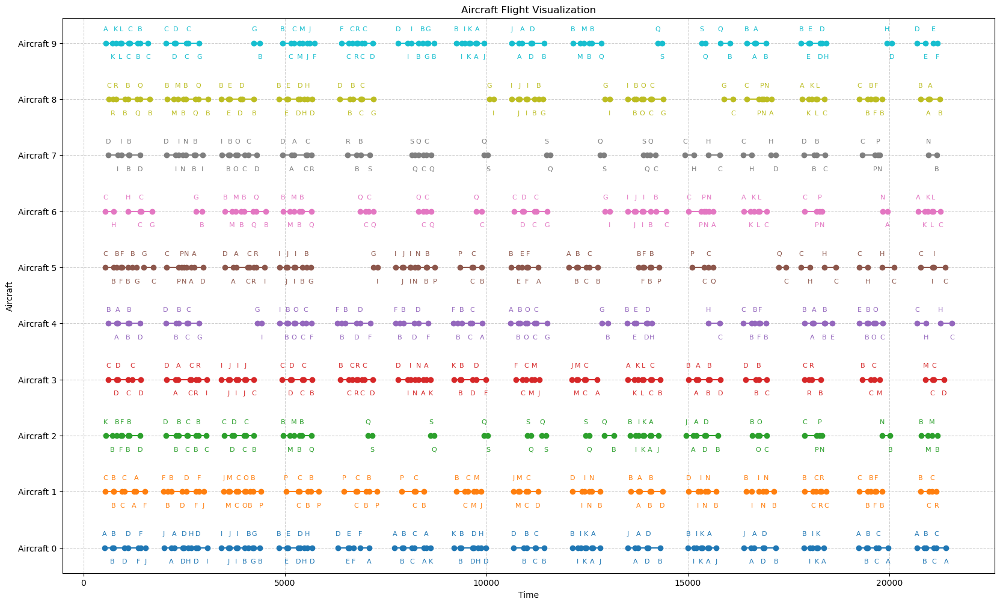

The optimal Cost provided is 3412174.0
Le coût à l'optimal a pour valeur:  3470938.0


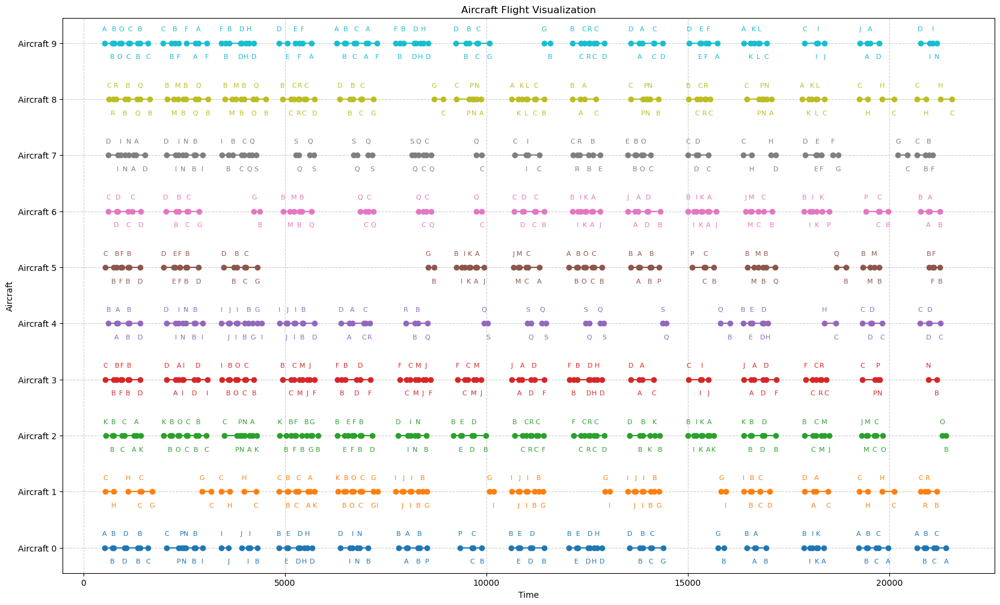

The optimal Cost provided is 3470938.0
Le coût à l'optimal a pour valeur:  3365368.0


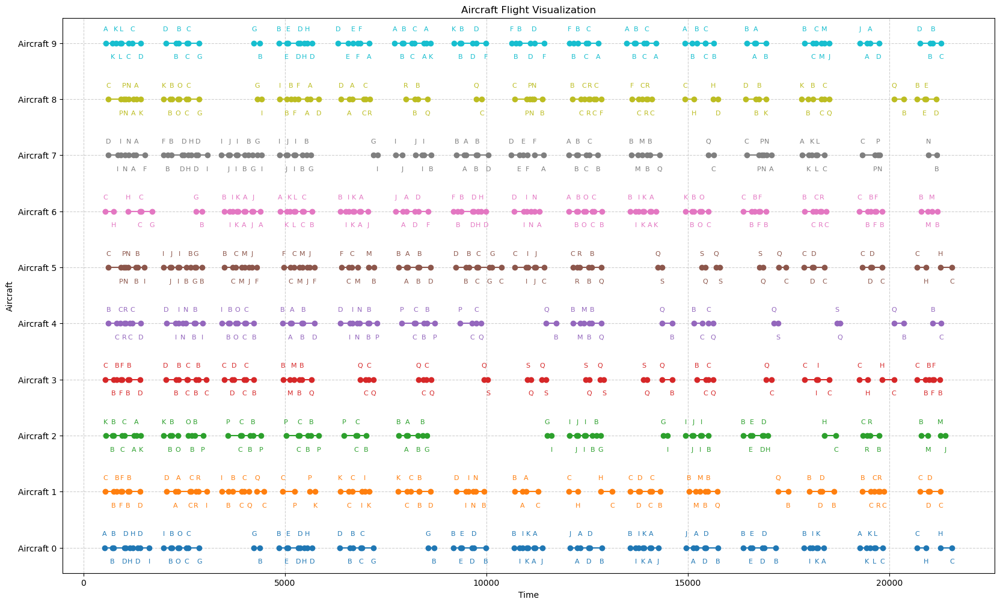

The optimal Cost provided is 3365368.0
Le coût à l'optimal a pour valeur:  6031271.0


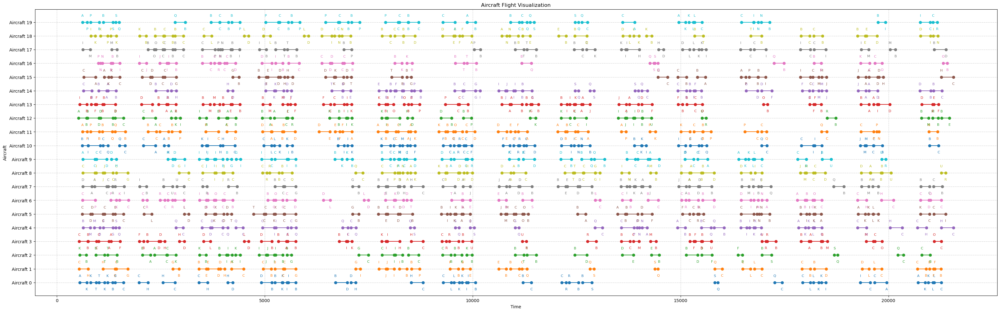

The optimal Cost provided is 6031271.0
Le coût à l'optimal a pour valeur:  6086043.0


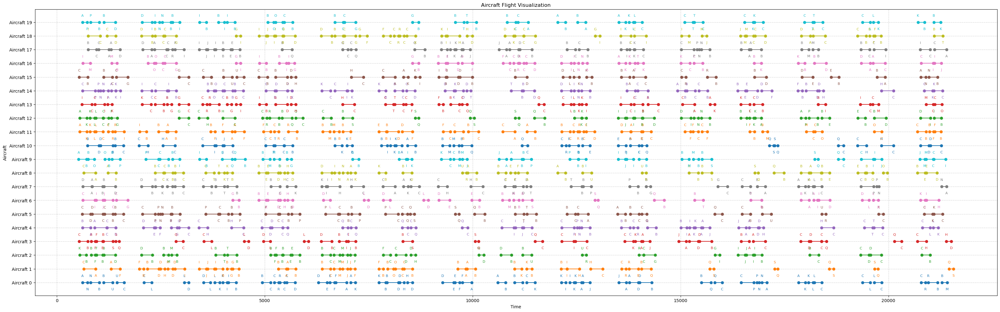

The optimal Cost provided is 6086043.0
Le coût à l'optimal a pour valeur:  6086043.0


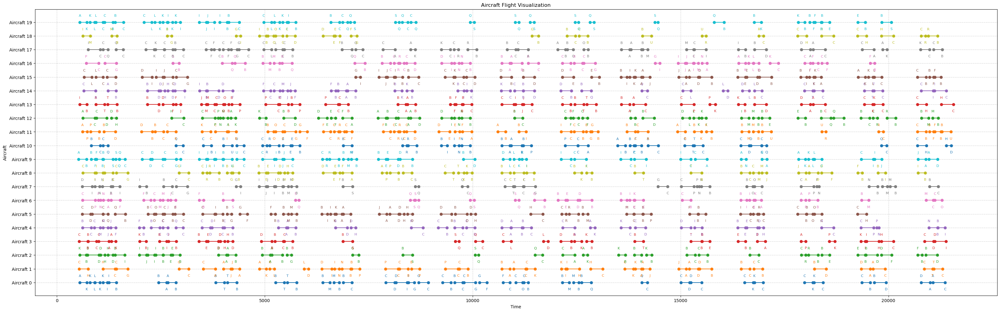

The optimal Cost provided is 6086043.0
Le coût à l'optimal a pour valeur:  6162058.0


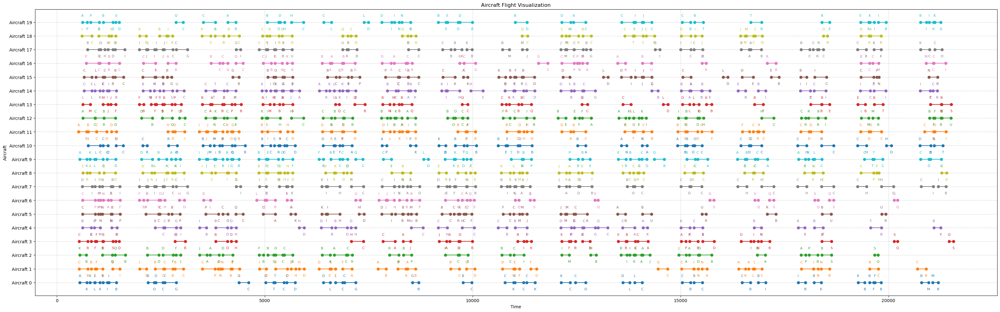

The optimal Cost provided is 6162058.0
Le coût à l'optimal a pour valeur:  5948380.0


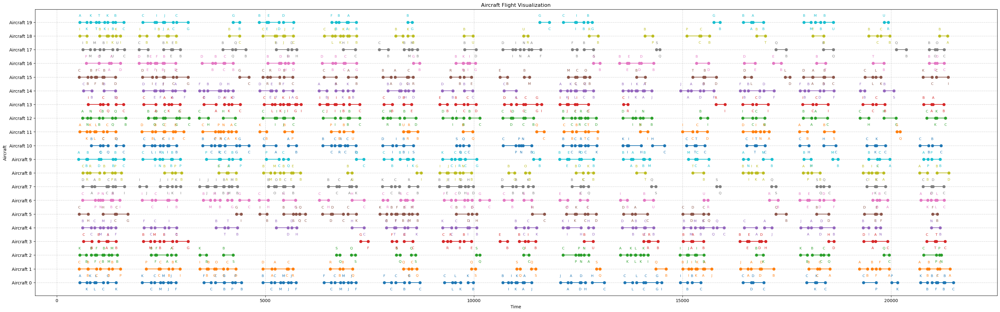

The optimal Cost provided is 5948380.0
Le coût à l'optimal a pour valeur:  6065426.0


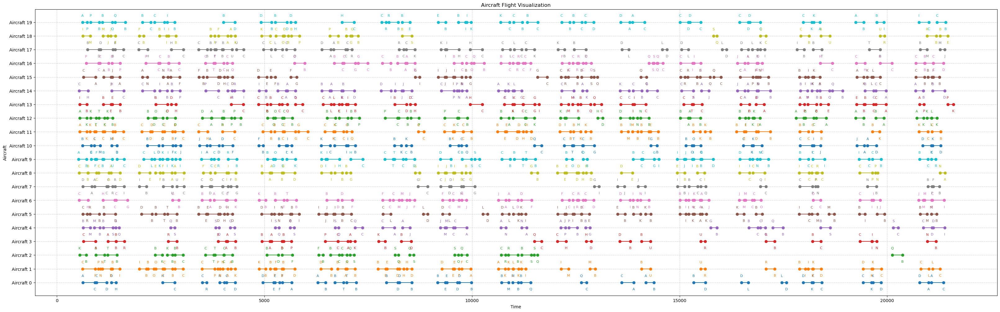

The optimal Cost provided is 6065426.0
Le coût à l'optimal a pour valeur:  6053973.0


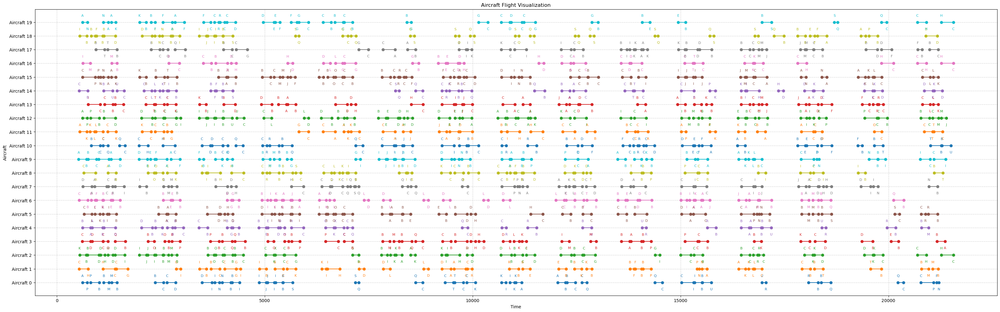

The optimal Cost provided is 6053973.0
Le coût à l'optimal a pour valeur:  6149976.0


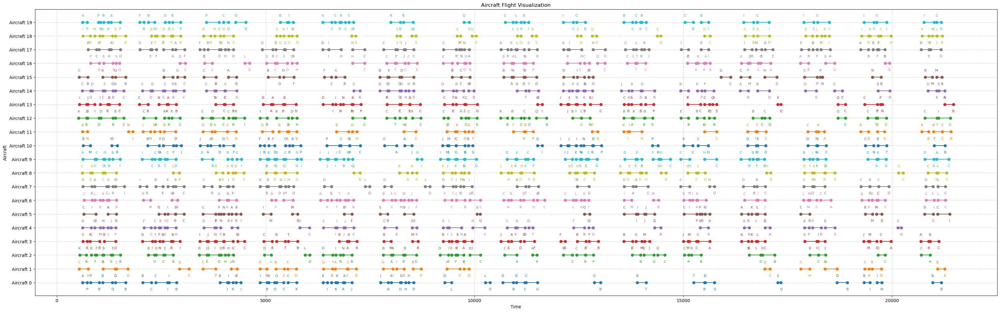

The optimal Cost provided is 6149976.0
Le coût à l'optimal a pour valeur:  6149976.0


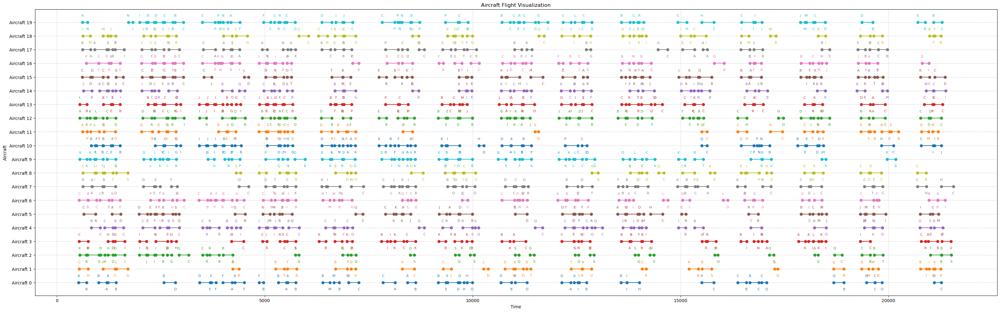

The optimal Cost provided is 6149976.0
Le coût à l'optimal a pour valeur:  6126649.0


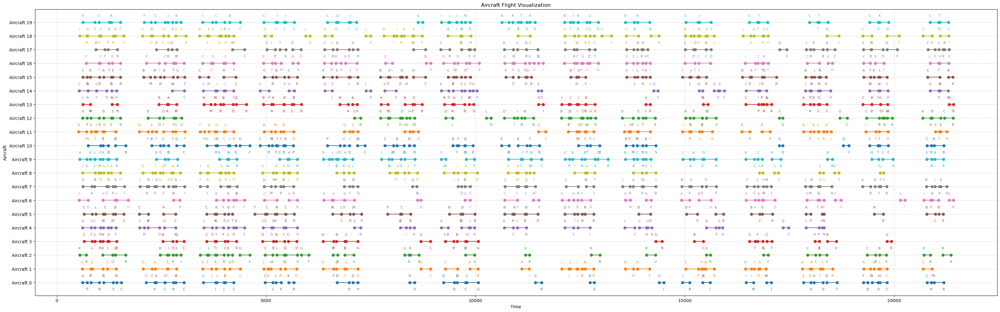

The optimal Cost provided is 6126649.0


In [45]:
for d in [0.5, 0.7, 1]:
    for h in [7, 15]:
        for p in [10, 20]:
            for t in range (10):
                Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
                    d=d, p=p, h=h, t=t, file_path=None
                )
                m = Model(str((d,h,p,t)))

                Solve_and_represent(m,(d,h,p,t),optimal_representation(p,h))

                file_path_sol = "d="+str(d)+"\p="+str(p)+"\h="+str(h)+"\Optimal_Solution_density="+str(d)+"_p="+str(p)+"_h="+str(h)+"_test_"+str(t)+".txt"
                otpimal_objective[(d,p,h,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

                print("The optimal Cost provided is", otpimal_objective[(d,p,h,t)])

In [46]:
print(solving_time)

{(0.5, 7, 10, 1): 0.04900002479553223, (0.5, 7, 20, 1): 0.8459999561309814, (0.5, 7, 10, 0): 0.0819997787475586, (0.5, 7, 10, 2): 0.14800000190734863, (0.5, 7, 10, 3): 0.06700015068054199, (0.5, 7, 10, 4): 0.0969998836517334, (0.5, 7, 10, 5): 0.056999921798706055, (0.5, 7, 10, 6): 0.09300017356872559, (0.5, 7, 10, 7): 0.06699991226196289, (0.5, 7, 10, 8): 0.039999961853027344, (0.5, 7, 10, 9): 0.04400014877319336, (0.5, 7, 20, 0): 0.8009998798370361, (0.5, 7, 20, 2): 1.3320000171661377, (0.5, 7, 20, 3): 0.6809999942779541, (0.5, 7, 20, 4): 1.687999963760376, (0.5, 7, 20, 5): 1.562000036239624, (0.5, 7, 20, 6): 0.7180001735687256, (0.5, 7, 20, 7): 1.1539998054504395, (0.5, 7, 20, 8): 1.1710000038146973, (0.5, 7, 20, 9): 0.7080001831054688, (0.5, 15, 10, 0): 0.1679999828338623, (0.5, 15, 10, 1): 0.15799999237060547, (0.5, 15, 10, 2): 0.43200016021728516, (0.5, 15, 10, 3): 0.15199995040893555, (0.5, 15, 10, 4): 0.8640000820159912, (0.5, 15, 10, 5): 0.3380000591278076, (0.5, 15, 10, 6): 0.

{(0.5, 7, 10, 1): 0.04900002479553223, (0.5, 7, 20, 1): 0.8459999561309814, (0.5, 7, 10, 0): 0.0819997787475586, (0.5, 7, 10, 2): 0.14800000190734863, (0.5, 7, 10, 3): 0.06700015068054199, (0.5, 7, 10, 4): 0.0969998836517334, (0.5, 7, 10, 5): 0.056999921798706055, (0.5, 7, 10, 6): 0.09300017356872559, (0.5, 7, 10, 7): 0.06699991226196289, (0.5, 7, 10, 8): 0.039999961853027344, (0.5, 7, 10, 9): 0.04400014877319336, (0.5, 7, 20, 0): 0.8009998798370361, (0.5, 7, 20, 2): 1.3320000171661377, (0.5, 7, 20, 3): 0.6809999942779541, (0.5, 7, 20, 4): 1.687999963760376, (0.5, 7, 20, 5): 1.562000036239624, (0.5, 7, 20, 6): 0.7180001735687256, (0.5, 7, 20, 7): 1.1539998054504395, (0.5, 7, 20, 8): 1.1710000038146973, (0.5, 7, 20, 9): 0.7080001831054688, (0.5, 15, 10, 0): 0.1679999828338623, (0.5, 15, 10, 1): 0.15799999237060547, (0.5, 15, 10, 2): 0.43200016021728516, (0.5, 15, 10, 3): 0.15199995040893555, (0.5, 15, 10, 4): 0.8640000820159912, (0.5, 15, 10, 5): 0.3380000591278076, (0.5, 15, 10, 6): 0.24400019645690918, (0.5, 15, 10, 7): 0.16499996185302734, (0.5, 15, 10, 8): 0.6449999809265137, (0.5, 15, 10, 9): 0.10599994659423828, (0.5, 15, 20, 0): 2.948000192642212, (0.5, 15, 20, 1): 3.5850000381469727, (0.5, 15, 20, 2): 3.6649999618530273, (0.5, 15, 20, 3): 3.4860000610351562, (0.5, 15, 20, 4): 7.833999872207642, (0.5, 15, 20, 5): 8.687999963760376, (0.5, 15, 20, 6): 1.7770001888275146, (0.5, 15, 20, 7): 10.164999961853027, (0.5, 15, 20, 8): 1.5079998970031738, (0.5, 15, 20, 9): 4.266000032424927, (0.7, 7, 10, 0): 0.1530001163482666, (0.7, 7, 10, 1): 0.3529999256134033, (0.7, 7, 10, 2): 0.22600007057189941, (0.7, 7, 10, 3): 0.25300002098083496, (0.7, 7, 10, 4): 0.2850000858306885, (0.7, 7, 10, 5): 0.17100000381469727, (0.7, 7, 10, 6): 0.3970000743865967, (0.7, 7, 10, 7): 0.4269998073577881, (0.7, 7, 10, 8): 0.3529999256134033, (0.7, 7, 10, 9): 0.13700008392333984, (0.7, 7, 20, 0): 3.195000171661377, (0.7, 7, 20, 1): 2.9169998168945312, (0.7, 7, 20, 2): 1.933000087738037, (0.7, 7, 20, 3): 6.132999897003174, (0.7, 7, 20, 4): 7.659999847412109, (0.7, 7, 20, 5): 4.562999963760376, (0.7, 7, 20, 6): 3.9010000228881836, (0.7, 7, 20, 7): 4.13100004196167, (0.7, 7, 20, 8): 2.68500018119812, (0.7, 7, 20, 9): 2.6410000324249268, (0.7, 15, 10, 0): 0.874000072479248, (0.7, 15, 10, 1): 0.10400009155273438, (0.7, 15, 10, 2): 0.3989999294281006, (0.7, 15, 10, 3): 1.1489999294281006, (0.7, 15, 10, 4): 0.5490000247955322, (0.7, 15, 10, 5): 0.20599985122680664, (0.7, 15, 10, 6): 0.7829999923706055, (0.7, 15, 10, 7): 0.9839999675750732, (0.7, 15, 10, 8): 0.6630001068115234, (0.7, 15, 10, 9): 0.8989999294281006, (0.7, 15, 20, 0): 68.88700008392334, (0.7, 15, 20, 1): 40.77500009536743, (0.7, 15, 20, 2): 27.52999997138977, (0.7, 15, 20, 3): 52.53099989891052, (0.7, 15, 20, 4): 23.514000177383423, (0.7, 15, 20, 5): 31.84999990463257, (0.7, 15, 20, 6): 7.434999942779541, (0.7, 15, 20, 7): 32.842000007629395, (0.7, 15, 20, 8): 27.13100004196167, (0.7, 15, 20, 9): 12.394000053405762, (1, 7, 10, 0): 0.7969999313354492, (1, 7, 10, 1): 0.6979999542236328, (1, 7, 10, 2): 1.0829999446868896, (1, 7, 10, 3): 0.8799998760223389, (1, 7, 10, 4): 0.7709999084472656, (1, 7, 10, 5): 0.9539999961853027, (1, 7, 10, 6): 1.0309998989105225, (1, 7, 10, 7): 0.935999870300293, (1, 7, 10, 8): 0.8880000114440918, (1, 7, 10, 9): 0.8660001754760742, (1, 7, 20, 0): 22.432999849319458, (1, 7, 20, 1): 37.12599992752075, (1, 7, 20, 2): 28.50600004196167, (1, 7, 20, 3): 26.69700002670288, (1, 7, 20, 4): 27.894999980926514, (1, 7, 20, 5): 22.22599983215332, (1, 7, 20, 6): 27.865999937057495, (1, 7, 20, 7): 42.424999952316284, (1, 7, 20, 8): 28.980000019073486, (1, 7, 20, 9): 34.132999897003174, (1, 15, 10, 0): 5.074999809265137, (1, 15, 10, 1): 7.28000020980835, (1, 15, 10, 2): 8.82800006866455, (1, 15, 10, 3): 6.2809998989105225, (1, 15, 10, 4): 8.188999891281128, (1, 15, 10, 5): 6.624000072479248, (1, 15, 10, 6): 5.6499998569488525, (1, 15, 10, 7): 10.31499981880188, (1, 15, 10, 8): 8.785999774932861, (1, 15, 10, 9): 7.999000072479248, (1, 15, 20, 0): 237.46599984169006, (1, 15, 20, 1): 240.29900002479553, (1, 15, 20, 2): 487.58899998664856, (1, 15, 20, 3): 320.0130000114441, (1, 15, 20, 4): 125.86300015449524, (1, 15, 20, 5): 250.9210000038147, (1, 15, 20, 6): 415.97300004959106, (1, 15, 20, 7): 256.6010000705719, (1, 15, 20, 8): 65.64400005340576, (1, 15, 20, 9): 50.76300001144409}

In [47]:
print(otpimal_objective)

{(0.5, 10, 7, 1): 767779.0, (0.5, 20, 7, 1): 1445118.0, (0.5, 10, 7, 0): 829836.0, (0.5, 10, 7, 2): 989823.0, (0.5, 10, 7, 3): 778912.0, (0.5, 10, 7, 4): 1014563.0, (0.5, 10, 7, 5): 519756.0, (0.5, 10, 7, 6): 837052.0, (0.5, 10, 7, 7): 853751.0, (0.5, 10, 7, 8): 790251.0, (0.5, 10, 7, 9): 837052.0, (0.5, 20, 7, 0): 1438457.0, (0.5, 20, 7, 2): 1646625.0, (0.5, 20, 7, 3): 1385789.0, (0.5, 20, 7, 4): 1699293.0, (0.5, 20, 7, 5): 1758830.0, (0.5, 20, 7, 6): 1353730.0, (0.5, 20, 7, 7): 1550867.0, (0.5, 20, 7, 8): 1532757.0, (0.5, 20, 7, 9): 1613735.0, (0.5, 10, 15, 0): 1137029.0, (0.5, 10, 15, 1): 1046314.0, (0.5, 10, 15, 2): 966938.0, (0.5, 10, 15, 3): 1489374.0, (0.5, 10, 15, 4): 1356806.0, (0.5, 10, 15, 5): 1598231.0, (0.5, 10, 15, 6): 1626888.0, (0.5, 10, 15, 7): 1364847.0, (0.5, 10, 15, 8): 1698636.0, (0.5, 10, 15, 9): 1137029.0, (0.5, 20, 15, 0): 2221799.0, (0.5, 20, 15, 1): 2324011.0, (0.5, 20, 15, 2): 2036737.0, (0.5, 20, 15, 3): 2036737.0, (0.5, 20, 15, 4): 2538842.0, (0.5, 20, 15, 

{(0.5, 10, 7, 1): 767779.0, (0.5, 20, 7, 1): 1445118.0, (0.5, 10, 7, 0): 829836.0, (0.5, 10, 7, 2): 989823.0, (0.5, 10, 7, 3): 778912.0, (0.5, 10, 7, 4): 1014563.0, (0.5, 10, 7, 5): 519756.0, (0.5, 10, 7, 6): 837052.0, (0.5, 10, 7, 7): 853751.0, (0.5, 10, 7, 8): 790251.0, (0.5, 10, 7, 9): 837052.0, (0.5, 20, 7, 0): 1438457.0, (0.5, 20, 7, 2): 1646625.0, (0.5, 20, 7, 3): 1385789.0, (0.5, 20, 7, 4): 1699293.0, (0.5, 20, 7, 5): 1758830.0, (0.5, 20, 7, 6): 1353730.0, (0.5, 20, 7, 7): 1550867.0, (0.5, 20, 7, 8): 1532757.0, (0.5, 20, 7, 9): 1613735.0, (0.5, 10, 15, 0): 1137029.0, (0.5, 10, 15, 1): 1046314.0, (0.5, 10, 15, 2): 966938.0, (0.5, 10, 15, 3): 1489374.0, (0.5, 10, 15, 4): 1356806.0, (0.5, 10, 15, 5): 1598231.0, (0.5, 10, 15, 6): 1626888.0, (0.5, 10, 15, 7): 1364847.0, (0.5, 10, 15, 8): 1698636.0, (0.5, 10, 15, 9): 1137029.0, (0.5, 20, 15, 0): 2221799.0, (0.5, 20, 15, 1): 2324011.0, (0.5, 20, 15, 2): 2036737.0, (0.5, 20, 15, 3): 2036737.0, (0.5, 20, 15, 4): 2538842.0, (0.5, 20, 15, 5): 2559451.0, (0.5, 20, 15, 6): 1758830.0, (0.5, 20, 15, 7): 2959970.0, (0.5, 20, 15, 8): 1715114.0, (0.5, 20, 15, 9): 2341705.0, (0.7, 10, 7, 0): 1098476.0, (0.7, 10, 7, 1): 1098476.0, (0.7, 10, 7, 2): 837052.0, (0.7, 10, 7, 3): 1239495.0, (0.7, 10, 7, 4): 1105073.0, (0.7, 10, 7, 5): 974566.0, (0.7, 10, 7, 6): 1272070.0, (0.7, 10, 7, 7): 1323200.0, (0.7, 10, 7, 8): 1293099.0, (0.7, 10, 7, 9): 966938.0, (0.7, 20, 7, 0): 2171423.0, (0.7, 20, 7, 1): 2145402.0, (0.7, 20, 7, 2): 1892474.0, (0.7, 20, 7, 3): 2373764.0, (0.7, 20, 7, 4): 2622943.0, (0.7, 20, 7, 5): 2293618.0, (0.7, 20, 7, 6): 2301320.0, (0.7, 20, 7, 7): 2373764.0, (0.7, 20, 7, 8): 2175378.0, (0.7, 20, 7, 9): 2018209.0, (0.7, 10, 15, 0): 2141696.0, (0.7, 10, 15, 1): 1020336.0, (0.7, 10, 15, 2): 1498239.0, (0.7, 10, 15, 3): 2076959.0, (0.7, 10, 15, 4): 1798629.0, (0.7, 10, 15, 5): 1454737.0, (0.7, 10, 15, 6): 1789351.0, (0.7, 10, 15, 7): 1941504.0, (0.7, 10, 15, 8): 2124790.0, (0.7, 10, 15, 9): 1789351.0, (0.7, 20, 15, 0): 4391577.0, (0.7, 20, 15, 1): 3943073.0, (0.7, 20, 15, 2): 3311405.0, (0.7, 20, 15, 3): 4084455.0, (0.7, 20, 15, 4): 3492325.0, (0.7, 20, 15, 5): 3576434.0, (0.7, 20, 15, 6): 2671030.0, (0.7, 20, 15, 7): 4187939.0, (0.7, 20, 15, 8): 3748198.0, (0.7, 20, 15, 9): 3039295.0, (1, 10, 7, 0): 1924392.0, (1, 10, 7, 1): 1824400.0, (1, 10, 7, 2): 1844192.0, (1, 10, 7, 3): 1832234.0, (1, 10, 7, 4): 1941504.0, (1, 10, 7, 5): 1850789.0, (1, 10, 7, 6): 1882539.0, (1, 10, 7, 7): 1874292.0, (1, 10, 7, 8): 1828317.0, (1, 10, 7, 9): 1945421.0, (1, 20, 7, 0): 3606833.0, (1, 20, 7, 1): 3700313.0, (1, 20, 7, 2): 3670334.0, (1, 20, 7, 3): 3715929.0, (1, 20, 7, 4): 3661174.0, (1, 20, 7, 5): 3648890.0, (1, 20, 7, 6): 3656593.0, (1, 20, 7, 7): 3787547.0, (1, 20, 7, 8): 3656593.0, (1, 20, 7, 9): 3656593.0, (1, 10, 15, 0): 3428876.0, (1, 10, 15, 1): 3470938.0, (1, 10, 15, 2): 3354028.0, (1, 10, 15, 3): 3377533.0, (1, 10, 15, 4): 3404957.0, (1, 10, 15, 5): 3342893.0, (1, 10, 15, 6): 3424958.0, (1, 10, 15, 7): 3412174.0, (1, 10, 15, 8): 3470938.0, (1, 10, 15, 9): 3365368.0, (1, 20, 15, 0): 6031271.0, (1, 20, 15, 1): 6086043.0, (1, 20, 15, 2): 6086043.0, (1, 20, 15, 3): 6162058.0, (1, 20, 15, 4): 5948380.0, (1, 20, 15, 5): 6065426.0, (1, 20, 15, 6): 6053973.0, (1, 20, 15, 7): 6149976.0, (1, 20, 15, 8): 6149976.0, (1, 20, 15, 9): 6126649.0}

In [48]:
print(solved_objective)

{(0.5, 7, 10, 1): 767779.0, (0.5, 7, 20, 1): 1445118.0, (0.5, 7, 10, 0): 829836.0, (0.5, 7, 10, 2): 989823.0, (0.5, 7, 10, 3): 778912.0, (0.5, 7, 10, 4): 1014563.0, (0.5, 7, 10, 5): 519756.0, (0.5, 7, 10, 6): 837052.0, (0.5, 7, 10, 7): 853751.0, (0.5, 7, 10, 8): 790251.0, (0.5, 7, 10, 9): 837052.0, (0.5, 7, 20, 0): 1438457.0, (0.5, 7, 20, 2): 1646625.0, (0.5, 7, 20, 3): 1385789.0, (0.5, 7, 20, 4): 1699293.0, (0.5, 7, 20, 5): 1758830.0, (0.5, 7, 20, 6): 1353730.0, (0.5, 7, 20, 7): 1550867.0, (0.5, 7, 20, 8): 1532757.0, (0.5, 7, 20, 9): 1613735.0, (0.5, 15, 10, 0): 1137029.0, (0.5, 15, 10, 1): 1046314.0, (0.5, 15, 10, 2): 966938.0, (0.5, 15, 10, 3): 1489374.0, (0.5, 15, 10, 4): 1356806.0, (0.5, 15, 10, 5): 1598231.0, (0.5, 15, 10, 6): 1626888.0, (0.5, 15, 10, 7): 1364847.0, (0.5, 15, 10, 8): 1698636.0, (0.5, 15, 10, 9): 1137029.0, (0.5, 15, 20, 0): 2221799.0, (0.5, 15, 20, 1): 2324011.0, (0.5, 15, 20, 2): 2036737.0, (0.5, 15, 20, 3): 2036737.0, (0.5, 15, 20, 4): 2538842.0, (0.5, 15, 20, 

{(0.5, 7, 10, 1): 767779.0, (0.5, 7, 20, 1): 1445118.0, (0.5, 7, 10, 0): 829836.0, (0.5, 7, 10, 2): 989823.0, (0.5, 7, 10, 3): 778912.0, (0.5, 7, 10, 4): 1014563.0, (0.5, 7, 10, 5): 519756.0, (0.5, 7, 10, 6): 837052.0, (0.5, 7, 10, 7): 853751.0, (0.5, 7, 10, 8): 790251.0, (0.5, 7, 10, 9): 837052.0, (0.5, 7, 20, 0): 1438457.0, (0.5, 7, 20, 2): 1646625.0, (0.5, 7, 20, 3): 1385789.0, (0.5, 7, 20, 4): 1699293.0, (0.5, 7, 20, 5): 1758830.0, (0.5, 7, 20, 6): 1353730.0, (0.5, 7, 20, 7): 1550867.0, (0.5, 7, 20, 8): 1532757.0, (0.5, 7, 20, 9): 1613735.0, (0.5, 15, 10, 0): 1137029.0, (0.5, 15, 10, 1): 1046314.0, (0.5, 15, 10, 2): 966938.0, (0.5, 15, 10, 3): 1489374.0, (0.5, 15, 10, 4): 1356806.0, (0.5, 15, 10, 5): 1598231.0, (0.5, 15, 10, 6): 1626888.0, (0.5, 15, 10, 7): 1364847.0, (0.5, 15, 10, 8): 1698636.0, (0.5, 15, 10, 9): 1137029.0, (0.5, 15, 20, 0): 2221799.0, (0.5, 15, 20, 1): 2324011.0, (0.5, 15, 20, 2): 2036737.0, (0.5, 15, 20, 3): 2036737.0, (0.5, 15, 20, 4): 2538842.0, (0.5, 15, 20, 5): 2559451.0, (0.5, 15, 20, 6): 1758830.0, (0.5, 15, 20, 7): 2959970.0, (0.5, 15, 20, 8): 1715114.0, (0.5, 15, 20, 9): 2341705.0, (0.7, 7, 10, 0): 1098476.0, (0.7, 7, 10, 1): 1098476.0, (0.7, 7, 10, 2): 837052.0, (0.7, 7, 10, 3): 1239495.0, (0.7, 7, 10, 4): 1105073.0, (0.7, 7, 10, 5): 974566.0, (0.7, 7, 10, 6): 1272070.0, (0.7, 7, 10, 7): 1323200.0, (0.7, 7, 10, 8): 1293099.0, (0.7, 7, 10, 9): 966938.0, (0.7, 7, 20, 0): 2171423.0, (0.7, 7, 20, 1): 2145402.0, (0.7, 7, 20, 2): 1892474.0, (0.7, 7, 20, 3): 2373764.0, (0.7, 7, 20, 4): 2622943.0, (0.7, 7, 20, 5): 2293618.0, (0.7, 7, 20, 6): 2301320.0, (0.7, 7, 20, 7): 2373764.0, (0.7, 7, 20, 8): 2175378.0, (0.7, 7, 20, 9): 2018209.0, (0.7, 15, 10, 0): 2141696.0, (0.7, 15, 10, 1): 1020336.0, (0.7, 15, 10, 2): 1498239.0, (0.7, 15, 10, 3): 2076959.0, (0.7, 15, 10, 4): 1798629.0, (0.7, 15, 10, 5): 1454737.0, (0.7, 15, 10, 6): 1789351.0, (0.7, 15, 10, 7): 1941504.0, (0.7, 15, 10, 8): 2124790.0, (0.7, 15, 10, 9): 1789351.0, (0.7, 15, 20, 0): 4391577.0, (0.7, 15, 20, 1): 3943073.0, (0.7, 15, 20, 2): 3311405.0, (0.7, 15, 20, 3): 4084455.0, (0.7, 15, 20, 4): 3492325.0, (0.7, 15, 20, 5): 3576434.0, (0.7, 15, 20, 6): 2671030.0, (0.7, 15, 20, 7): 4187939.0, (0.7, 15, 20, 8): 3748198.0, (0.7, 15, 20, 9): 3039295.0, (1, 7, 10, 0): 1924392.0, (1, 7, 10, 1): 1824400.0, (1, 7, 10, 2): 1844192.0, (1, 7, 10, 3): 1832234.0, (1, 7, 10, 4): 1941504.0, (1, 7, 10, 5): 1850789.0, (1, 7, 10, 6): 1882539.0, (1, 7, 10, 7): 1874292.0, (1, 7, 10, 8): 1828317.0, (1, 7, 10, 9): 1945421.0, (1, 7, 20, 0): 3606833.0, (1, 7, 20, 1): 3700313.0, (1, 7, 20, 2): 3670334.0, (1, 7, 20, 3): 3715929.0, (1, 7, 20, 4): 3661174.0, (1, 7, 20, 5): 3648890.0, (1, 7, 20, 6): 3656593.0, (1, 7, 20, 7): 3787547.0, (1, 7, 20, 8): 3656593.0, (1, 7, 20, 9): 3656593.0, (1, 15, 10, 0): 3428876.0, (1, 15, 10, 1): 3470938.0, (1, 15, 10, 2): 3354028.0, (1, 15, 10, 3): 3377533.0, (1, 15, 10, 4): 3404957.0, (1, 15, 10, 5): 3342893.0, (1, 15, 10, 6): 3424958.0, (1, 15, 10, 7): 3412174.0, (1, 15, 10, 8): 3470938.0, (1, 15, 10, 9): 3365368.0, (1, 15, 20, 0): 6031271.0, (1, 15, 20, 1): 6086043.0, (1, 15, 20, 2): 6086043.0, (1, 15, 20, 3): 6162058.0, (1, 15, 20, 4): 5948380.0, (1, 15, 20, 5): 6065426.0, (1, 15, 20, 6): 6053973.0, (1, 15, 20, 7): 6149976.0, (1, 15, 20, 8): 6149976.0, (1, 15, 20, 9): 6126649.0}

### Ilyass

In [ ]:
import random
d=0.5
for h in [7, 15, 21]:
    for p in [10, 20, 30]:
        t=random.randint(0, 9)
        Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
            d=d, p=p, h=h, t=t, file_path=None
        )
        m = Model(str((d,h,p,t)))

        Solve_and_represent(m,(d,h,p,t),optimal_representation(p,h))

        file_path_sol = "d="+str(d)+"\p="+str(p)+"\h="+str(h)+"\Optimal_Solution_density="+str(d)+"_p="+str(p)+"_h="+str(h)+"_test_"+str(t)+".txt"
        otpimal_objective[(d,p,h,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

        print("The optimal Cost provided is", otpimal_objective[(d,p,h,t)])

### Adam

In [ ]:
import random
d=0.7
for h in [7, 15, 21]:
    for p in [10, 20, 30]:
        t=random.randint(0, 9)
        Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
            d=d, p=p, h=h, t=t, file_path=None
        )
        m = Model(str((d,h,p,t)))

        Solve_and_represent(m,(d,h,p,t),optimal_representation(p,h))

        file_path_sol = "d="+str(d)+"\p="+str(p)+"\h="+str(h)+"\Optimal_Solution_density="+str(d)+"_p="+str(p)+"_h="+str(h)+"_test_"+str(t)+".txt"
        otpimal_objective[(d,p,h,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

        print("The optimal Cost provided is", otpimal_objective[(d,p,h,t)])

### Ayoub

In [ ]:
import random
d=1
for h in [7, 15, 21]:
    for p in [10, 20, 30]:
        t=random.randint(0, 9)
        Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
            d=d, p=p, h=h, t=t, file_path=None
        )
        m = Model(str((d,h,p,t)))

        Solve_and_represent(m,(d,h,p,t),optimal_representation(p,h))

        file_path_sol = "d="+str(d)+"\p="+str(p)+"\h="+str(h)+"\Optimal_Solution_density="+str(d)+"_p="+str(p)+"_h="+str(h)+"_test_"+str(t)+".txt"
        otpimal_objective[(d,p,h,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

        print("The optimal Cost provided is", otpimal_objective[(d,p,h,t)])

# STUFF

In [ ]:
d=1
p=30
h=30
print(d,p,h)
t=0
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(d=d, p=p, h=h, t=t, file_path=None)
m = Model(str((d,p,h,t)))
X = {
        (i, j): m.addVar(vtype=GRB.BINARY, name="x" + str(i) + str(j))
        for i in Aircrafts
        for j in Flights
    }

# -- Uniqueness of airplane assignment to flights
for j in Flights:
    m.addConstr(quicksum([X[(i, j)] for i in Aircrafts]) == 1, name="U" + str(j))


# -- Continuity of Flights for non origins
for i in Aircrafts:
    for j in Flights:
        if j not in O(i):
            m.addConstr(
                quicksum(
                    [X[(i, k)] for k in Co_minus(j) & A_d_minus(j)]
                    + [X[(i, l)] * (-1) for l in D(j) & D_d_minus(j)]
                    + [X[(i, j)] * (-1)]
                )
                >= 0, name="Co "+ str(i) + " " + str(j)
            )

# -- Departure / continuity for potential origins
for i in Aircrafts:
    for j in O(i):
        m.addConstr(
            quicksum(
                [X[(i, k)] for k in Co_minus(j) & A_d_minus(j)]
                + [X[(i, l)] * (-1) for l in D(j) & D_d_minus(j)]
                + [X[(i, j)] * (-1)]
            )
            >= -1, name="Co "+ str(i) + " " + str(j)
        )

# Objective Function
m.setObjective(
    quicksum(X[(i, j)] * cost[(i, j)] for i in Aircrafts for j in Flights),
    GRB.MINIMIZE,
)

m.update()
m.params.outputflag = 0
file_name=str((d,p,h,t))
m.write(str(file_name)+".lp")

m.optimize()
if m.status == GRB.INFEASIBLE:
    print("Le modèle n'a pas de solution. Voici les contraintes le rendant ainsi")
    m.computeIIS()
    for c in m.getConstrs():
        if c.IISConstr:
            print(f"\t{c.constrname}: {m.getRow(c)} {c.Sense} {c.RHS}")
elif m.status == GRB.UNBOUNDED:
    print("Le modèle est non borné")
else:
    print("Le coût à l'optimal a pour valeur: ", m.ObjVal)

solving_time[file_name]=m.Runtime
solved_objective[file_name]=m.ObjVal

# Define Aircraft Assignments based on Gurobi results
gurobi_vars = [var.x for var in m.getVars()]

flight_assignments = {}
index = 0
for aircraft in Aircrafts:
    for flight in Flights:
        if gurobi_vars[index] == 1.0:
            flight_assignments[flight] = aircraft
        index += 1

plot_flights(Aircrafts, flight_assignments,optimal_representation(p))

1 30 30


<>:15: SyntaxWarning: invalid escape sequence '\p'
<>:15: SyntaxWarning: invalid escape sequence '\h'
<>:15: SyntaxWarning: invalid escape sequence '\O'
<>:15: SyntaxWarning: invalid escape sequence '\p'
<>:15: SyntaxWarning: invalid escape sequence '\h'
<>:15: SyntaxWarning: invalid escape sequence '\O'
C:\Users\adame\AppData\Local\Temp\ipykernel_30180\1610626514.py:15: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d="+str(d)+"\p="+str(p)+"\h="+str(h)+"\Optimal_Solution_density="+str(d)+"_p="+str(p)+"_h="+str(h)+"_test_"+str(t)+".txt"
C:\Users\adame\AppData\Local\Temp\ipykernel_30180\1610626514.py:15: SyntaxWarning: invalid escape sequence '\h'
  file_path_sol = "d="+str(d)+"\p="+str(p)+"\h="+str(h)+"\Optimal_Solution_density="+str(d)+"_p="+str(p)+"_h="+str(h)+"_test_"+str(t)+".txt"
C:\Users\adame\AppData\Local\Temp\ipykernel_30180\1610626514.py:15: SyntaxWarning: invalid escape sequence '\O'
  file_path_sol = "d="+str(d)+"\p="+str(p)+"\h="+str(h)+"\Optimal_Solution_d

d= 0.5 p= 10 h= 7
test= 7
Le coût à l'optimal a pour valeur:  853751.0


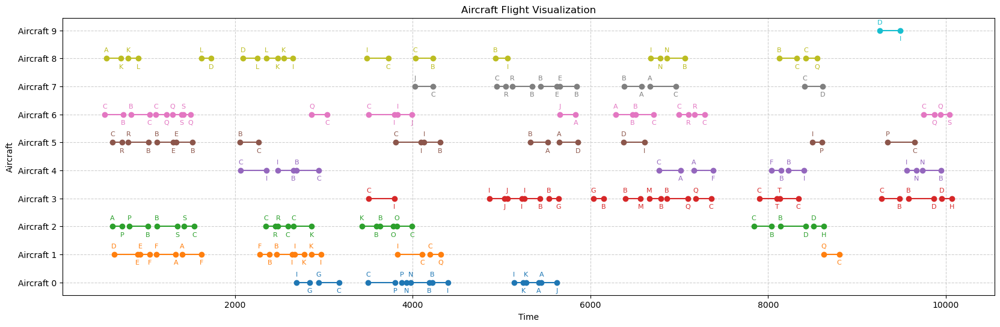

The optimal Cost provided is 853751.0
d= 0.5 p= 10 h= 15
test= 4
Le coût à l'optimal a pour valeur:  1356806.0


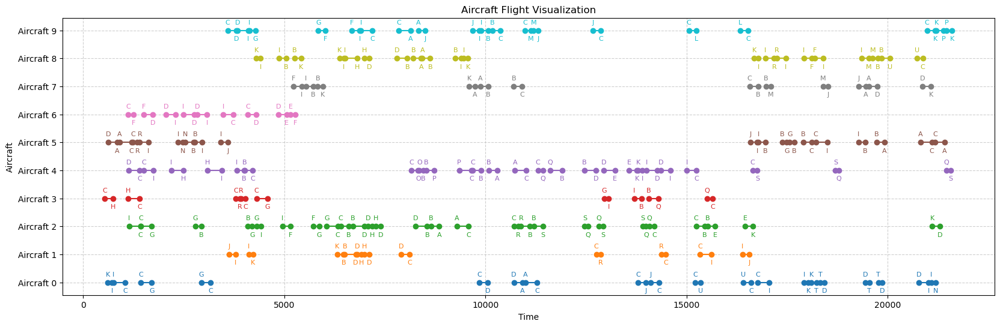

The optimal Cost provided is 1356806.0
d= 0.5 p= 10 h= 21
test= 7
Le coût à l'optimal a pour valeur:  1230217.0


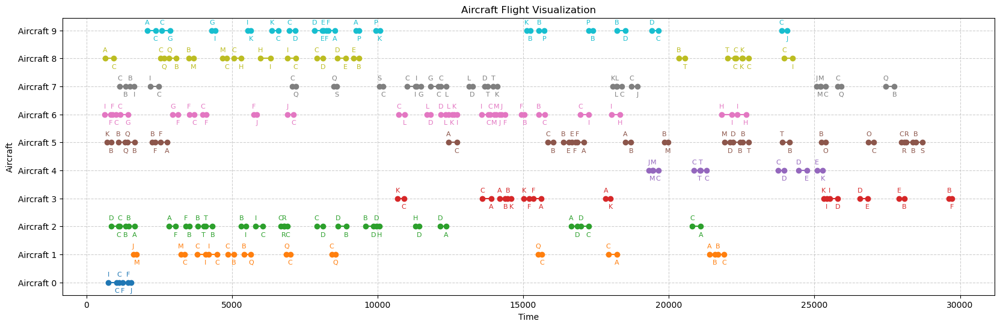

The optimal Cost provided is 1230217.0
d= 0.5 p= 10 h= 30
test= 7
Le coût à l'optimal a pour valeur:  1750798.0


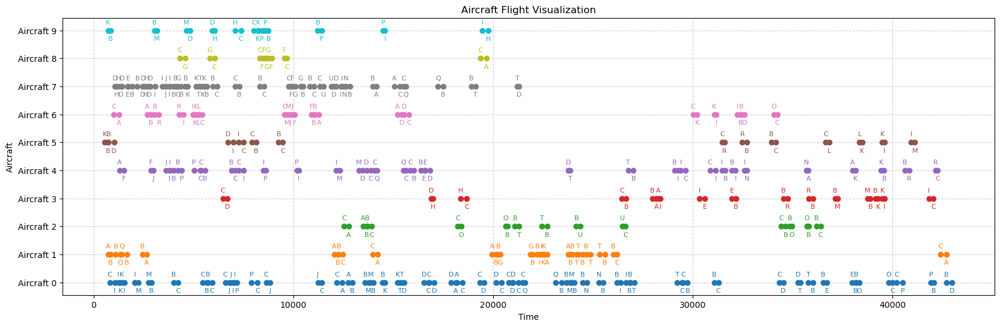

The optimal Cost provided is 1750798.0
d= 0.5 p= 20 h= 7
test= 8
Le coût à l'optimal a pour valeur:  1532757.0


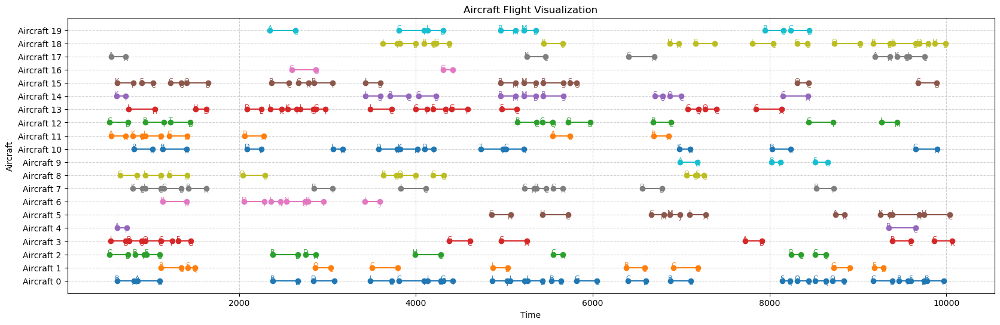

The optimal Cost provided is 1532757.0
d= 0.5 p= 20 h= 15
test= 4
Le coût à l'optimal a pour valeur:  2538842.0


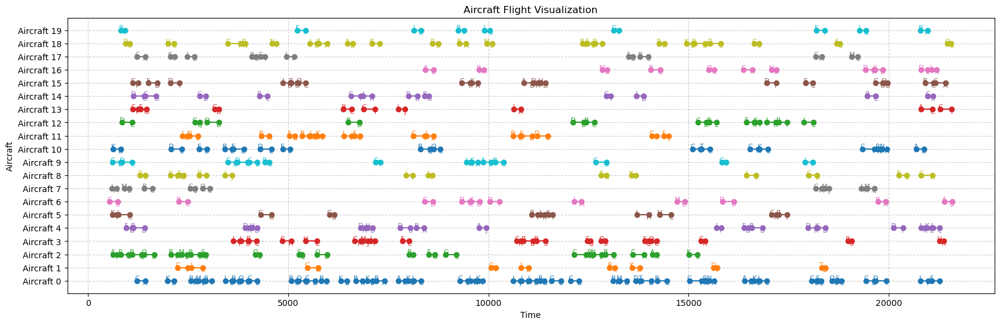

The optimal Cost provided is 2538842.0
d= 0.5 p= 20 h= 21
test= 4
Le coût à l'optimal a pour valeur:  2922500.0


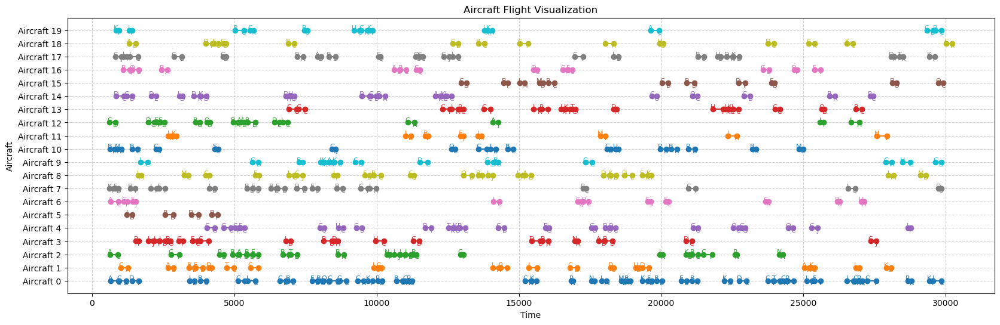

The optimal Cost provided is 2922500.0
d= 0.5 p= 20 h= 30
test= 6
Le coût à l'optimal a pour valeur:  3192942.0


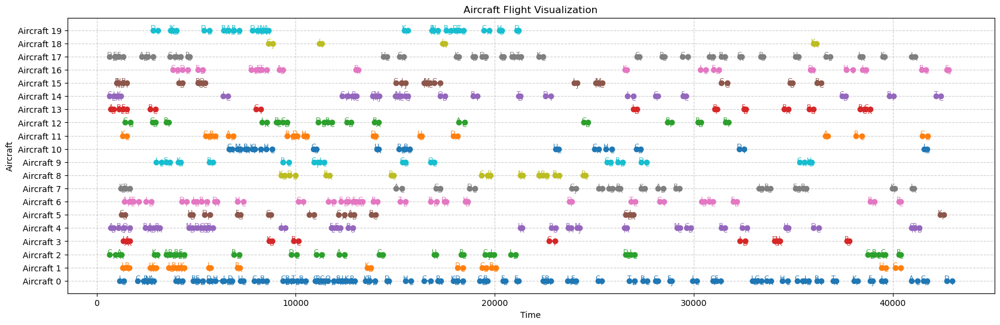

The optimal Cost provided is 3192942.0
d= 0.5 p= 30 h= 7
test= 9
Le coût à l'optimal a pour valeur:  2773285.0


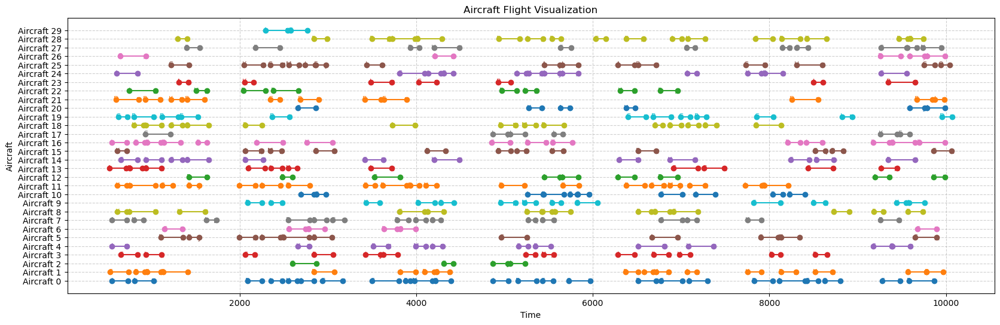

The optimal Cost provided is 2773285.0
d= 0.5 p= 30 h= 15
test= 3
Le coût à l'optimal a pour valeur:  3626675.0


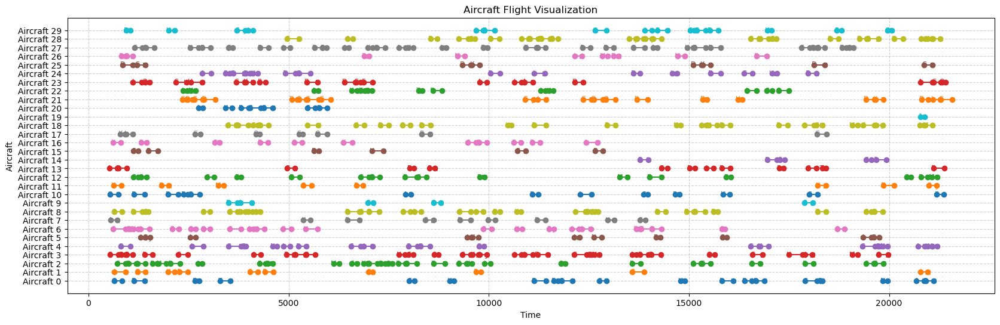

The optimal Cost provided is 3626675.0
d= 0.5 p= 30 h= 21
d= 0.5 p= 30 h= 30
test= 4
Le coût à l'optimal a pour valeur:  5121299.0


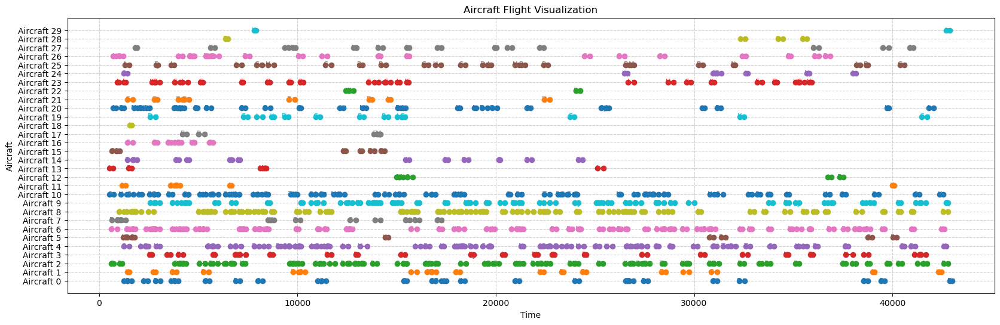

The optimal Cost provided is 5121299.0
d= 0.5 p= 40 h= 7
test= 8
Le coût à l'optimal a pour valeur:  3080201.0


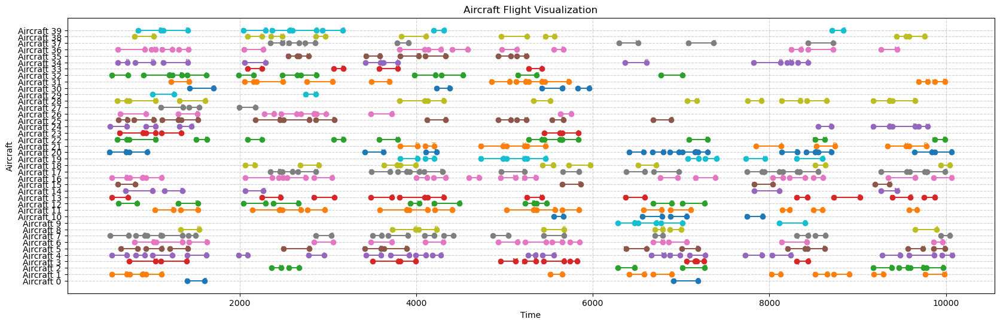

The optimal Cost provided is 3080201.0
d= 0.5 p= 40 h= 15
test= 2
Le coût à l'optimal a pour valeur:  4837925.0


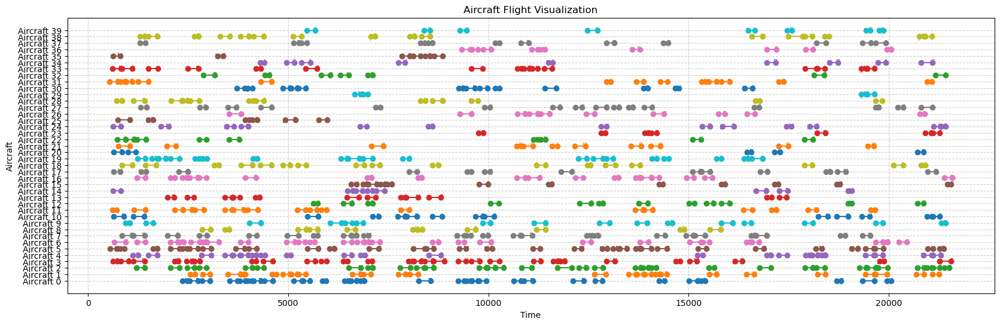

The optimal Cost provided is 4837925.0
d= 0.5 p= 40 h= 21
test= 2
Le coût à l'optimal a pour valeur:  5168537.0


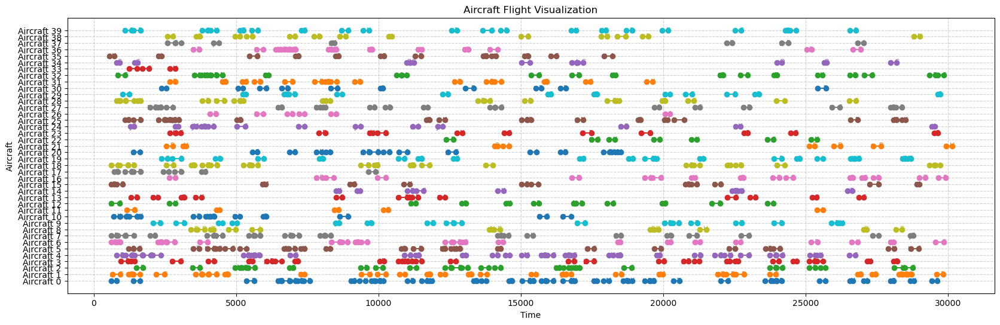

The optimal Cost provided is 5168537.0
d= 0.5 p= 40 h= 30
test= 7
Le coût à l'optimal a pour valeur:  6102864.0


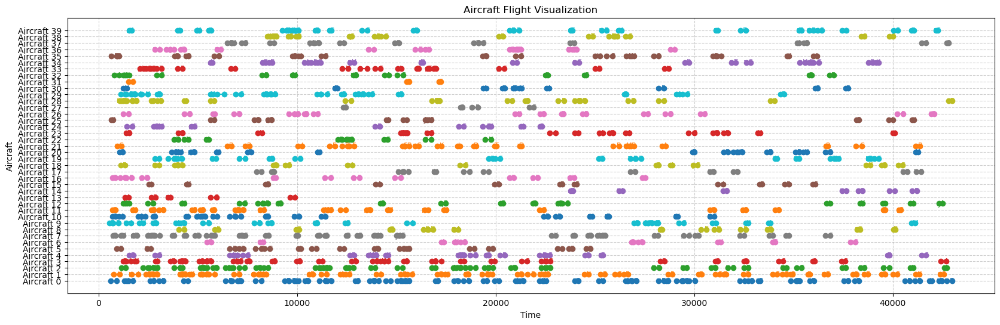

The optimal Cost provided is 6102864.0
d= 0.7 p= 10 h= 7
test= 4
Le coût à l'optimal a pour valeur:  1105073.0


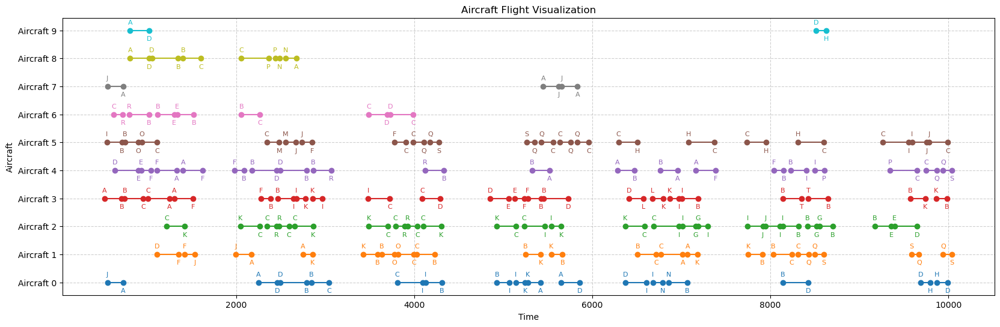

The optimal Cost provided is 1105073.0
d= 0.7 p= 10 h= 15
test= 3
Le coût à l'optimal a pour valeur:  2076959.0


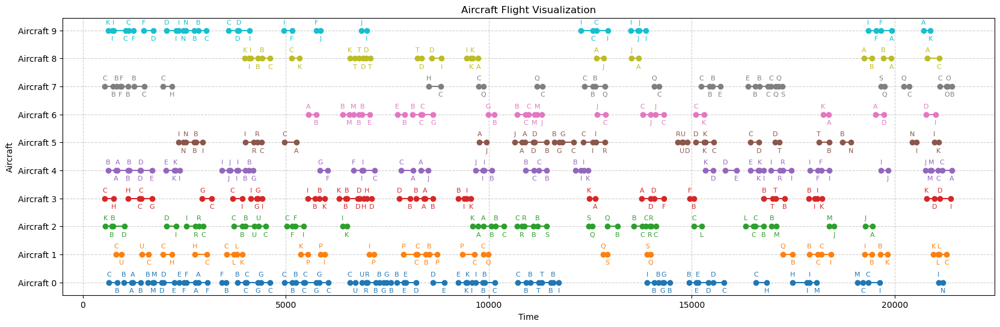

The optimal Cost provided is 2076959.0
d= 0.7 p= 10 h= 21
test= 1
Le coût à l'optimal a pour valeur:  1789351.0


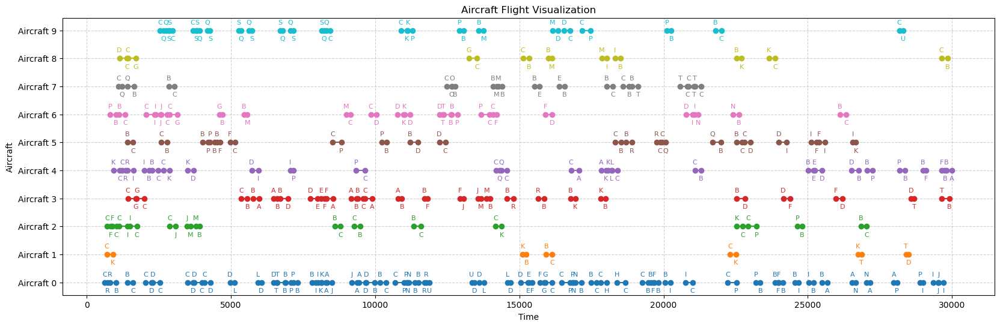

The optimal Cost provided is 1789351.0
d= 0.7 p= 10 h= 30
test= 5
Le coût à l'optimal a pour valeur:  1768734.0


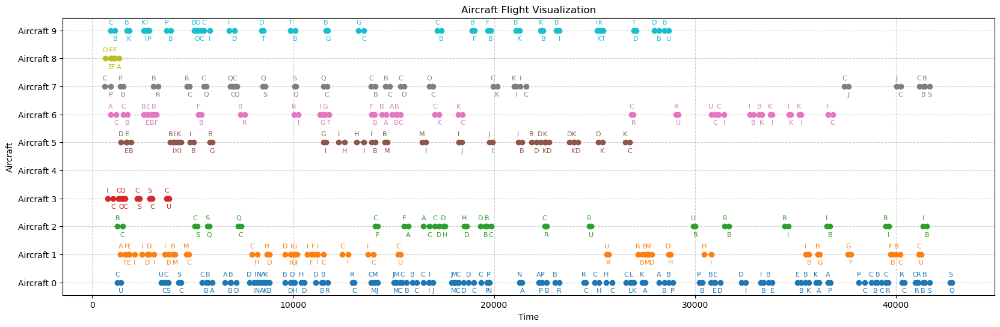

The optimal Cost provided is 1768734.0
d= 0.7 p= 20 h= 7
test= 3
Le coût à l'optimal a pour valeur:  2373764.0


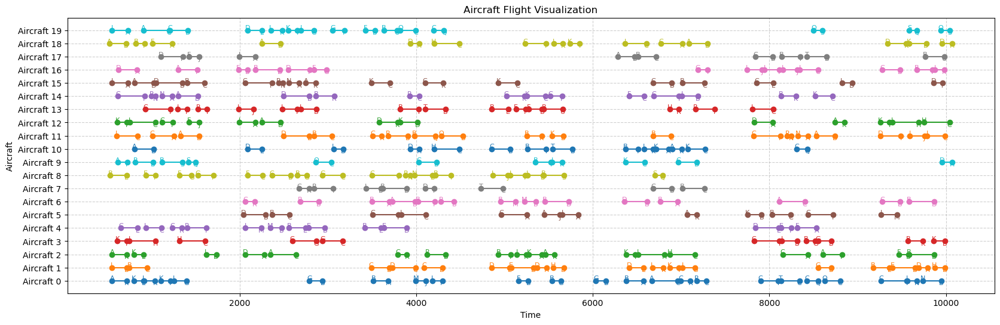

The optimal Cost provided is 2373764.0
d= 0.7 p= 20 h= 15
test= 4
Le coût à l'optimal a pour valeur:  3492325.0


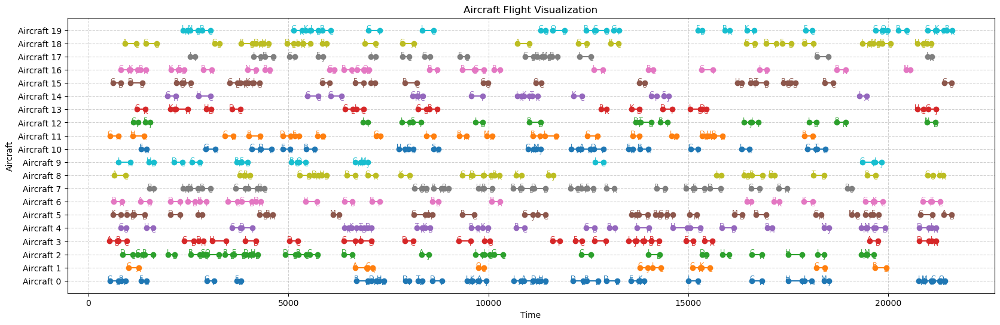

The optimal Cost provided is 3492325.0
d= 0.7 p= 20 h= 21
test= 3
Le coût à l'optimal a pour valeur:  4294549.0


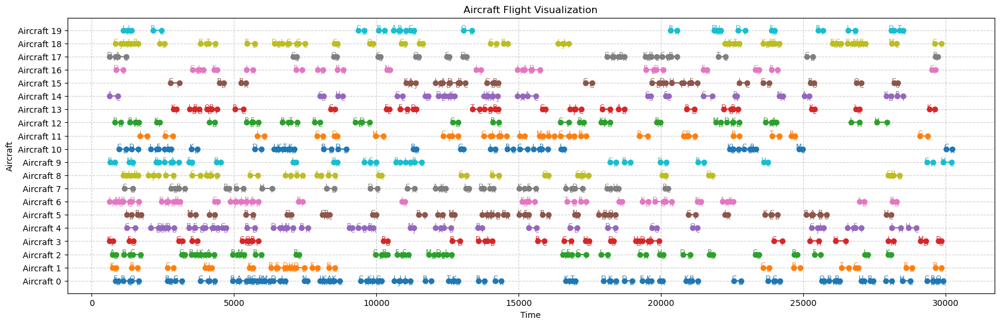

The optimal Cost provided is 4294549.0
d= 0.7 p= 20 h= 30
test= 0
Le coût à l'optimal a pour valeur:  4990227.0


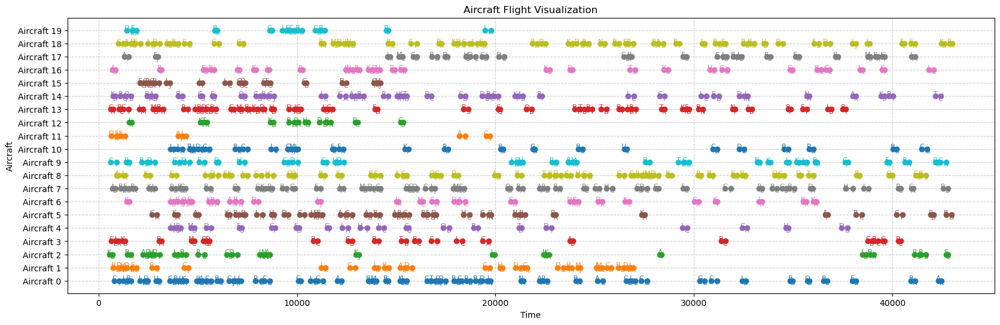

The optimal Cost provided is 4990227.0
d= 0.7 p= 30 h= 7
test= 4
Le coût à l'optimal a pour valeur:  3412245.0


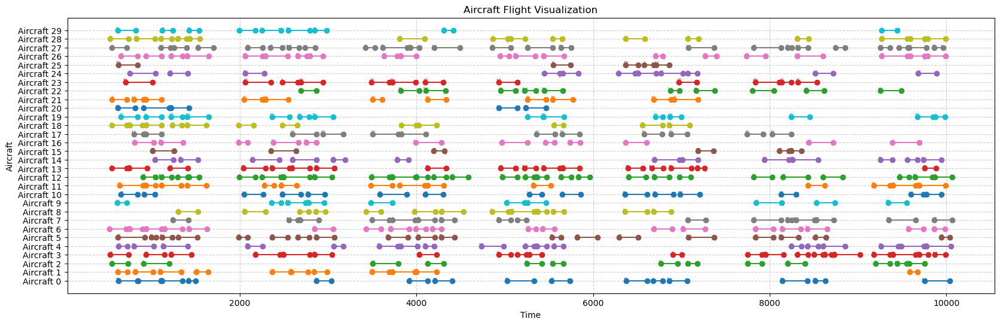

The optimal Cost provided is 3412245.0
d= 0.7 p= 30 h= 15
test= 4
Le coût à l'optimal a pour valeur:  4517916.0


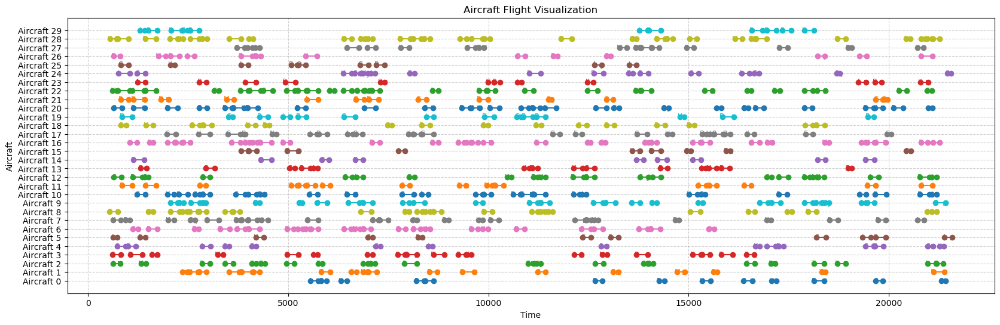

The optimal Cost provided is 4517916.0
d= 0.7 p= 30 h= 21
test= 9
Le coût à l'optimal a pour valeur:  6142237.0


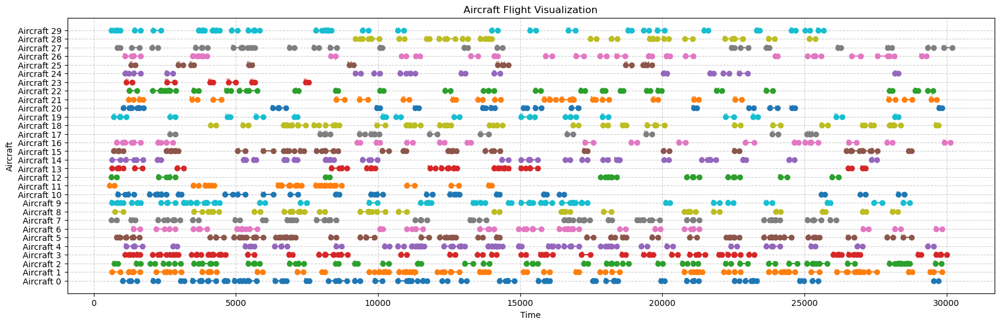

The optimal Cost provided is 6142237.0
d= 0.7 p= 30 h= 30
test= 5
Le coût à l'optimal a pour valeur:  5737034.0


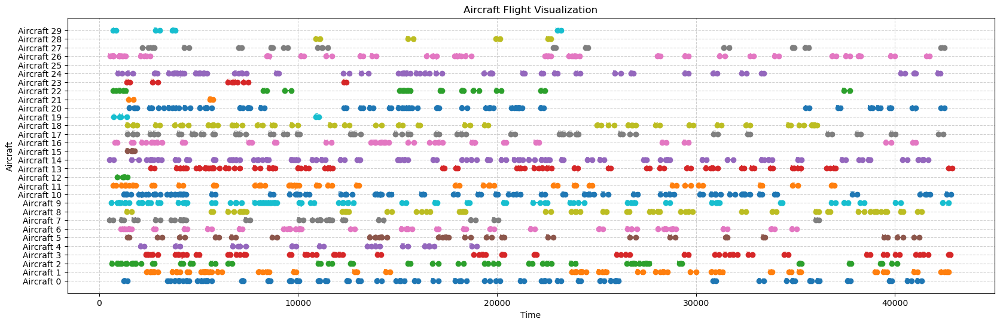

The optimal Cost provided is 5737034.0
d= 0.7 p= 40 h= 7
test= 7
Le coût à l'optimal a pour valeur:  4579532.0


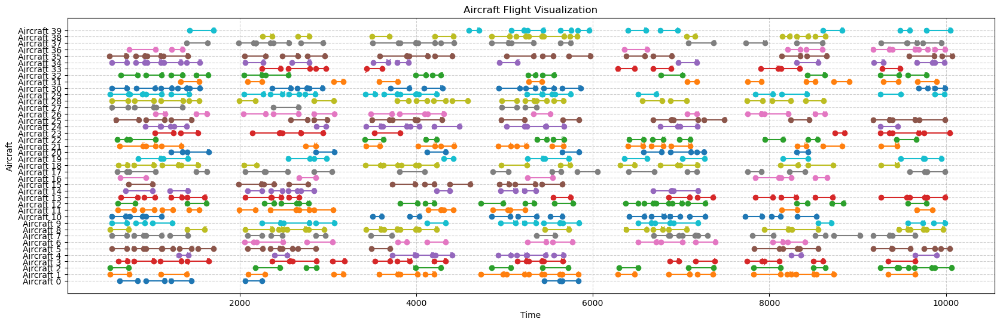

The optimal Cost provided is 4579532.0
d= 0.7 p= 40 h= 15
test= 7
Le coût à l'optimal a pour valeur:  7190582.0


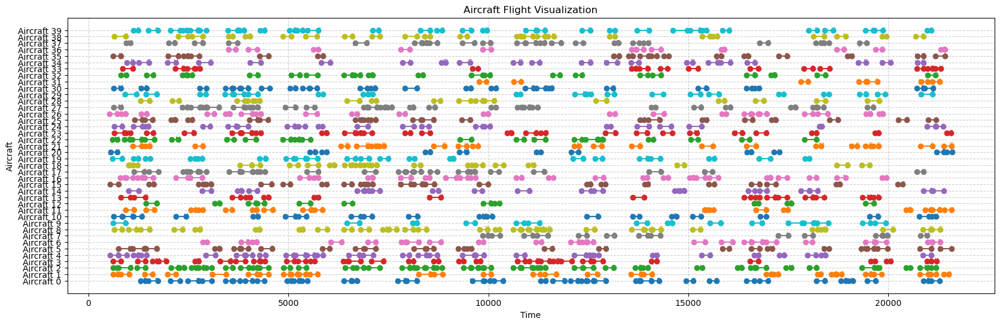

The optimal Cost provided is 7190582.0
d= 0.7 p= 40 h= 21
test= 3
Le coût à l'optimal a pour valeur:  7756063.0


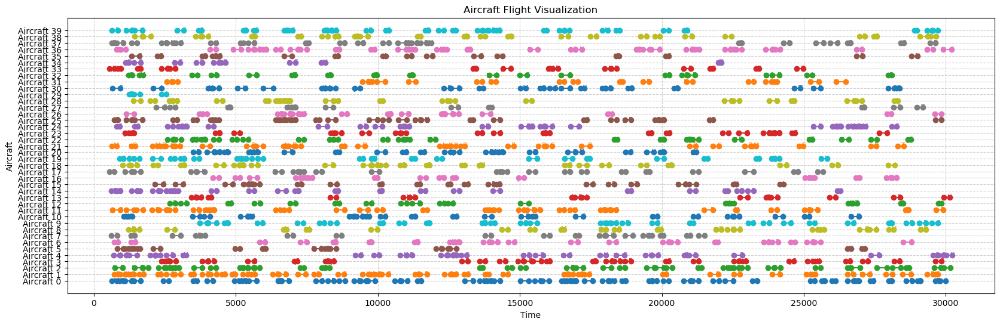

The optimal Cost provided is 7756063.0
d= 0.7 p= 40 h= 30
test= 8
Le coût à l'optimal a pour valeur:  8392549.0


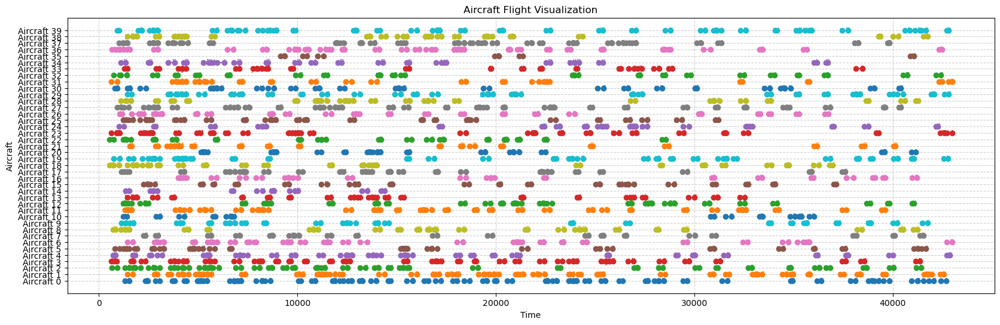

The optimal Cost provided is 8392549.0
d= 1 p= 10 h= 7
test= 9
Le coût à l'optimal a pour valeur:  1945421.0


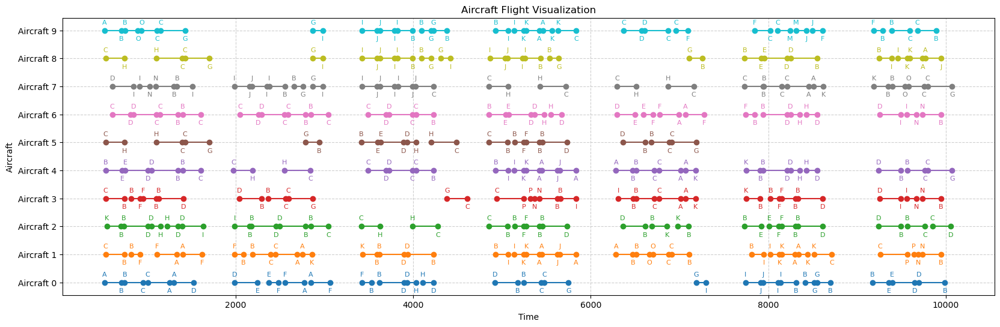

The optimal Cost provided is 1945421.0
d= 1 p= 10 h= 15
test= 0
Le coût à l'optimal a pour valeur:  3428876.0


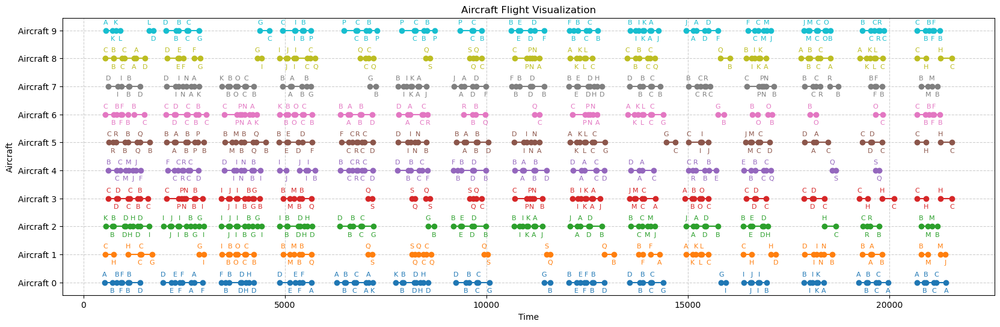

The optimal Cost provided is 3428876.0
d= 1 p= 10 h= 21
test= 4
Le coût à l'optimal a pour valeur:  4071405.0


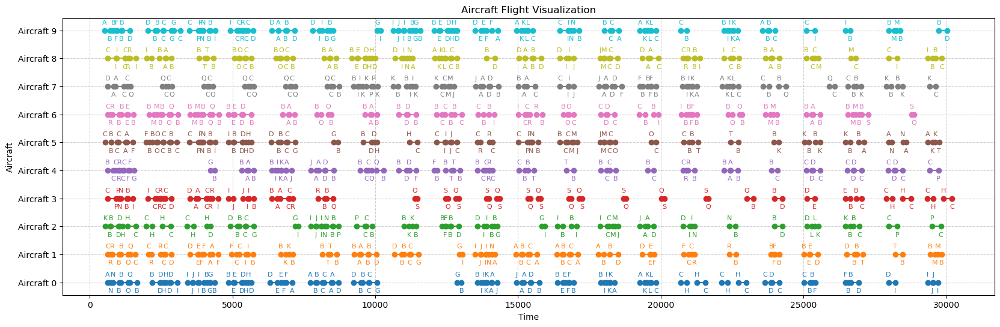

The optimal Cost provided is 4071405.0
d= 1 p= 10 h= 30
test= 2
Le coût à l'optimal a pour valeur:  4812760.0


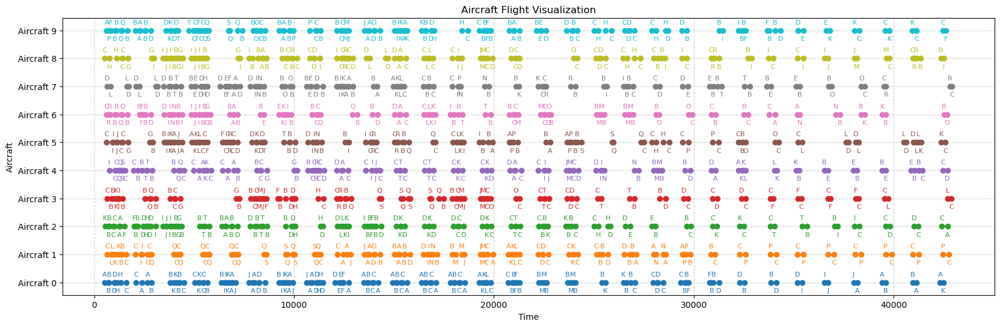

The optimal Cost provided is 4812760.0
d= 1 p= 20 h= 7
test= 5
Le coût à l'optimal a pour valeur:  3648890.0


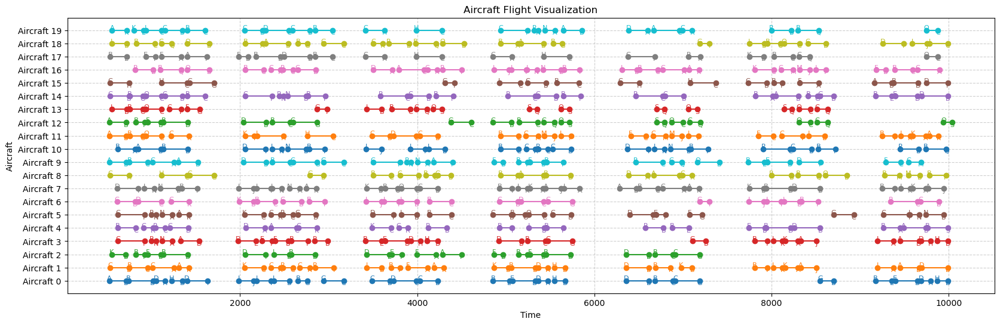

The optimal Cost provided is 3648890.0
d= 1 p= 20 h= 15
test= 0
Le coût à l'optimal a pour valeur:  6031271.0


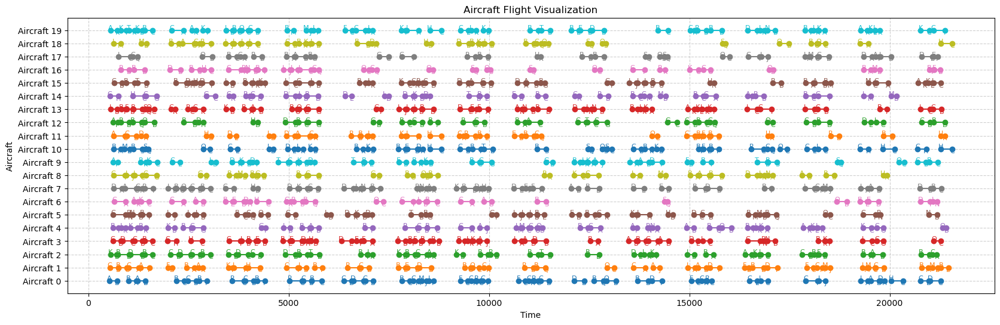

The optimal Cost provided is 6031271.0
d= 1 p= 20 h= 21
test= 3
Le coût à l'optimal a pour valeur:  7319684.0


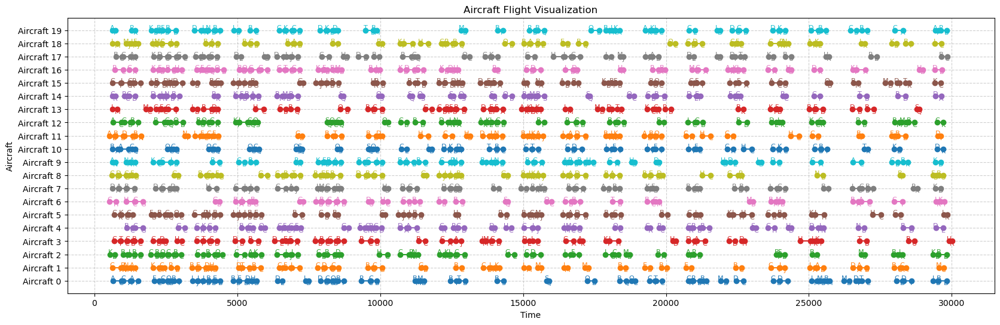

The optimal Cost provided is 7319684.0
d= 1 p= 20 h= 30
test= 4
Le coût à l'optimal a pour valeur:  8249995.0


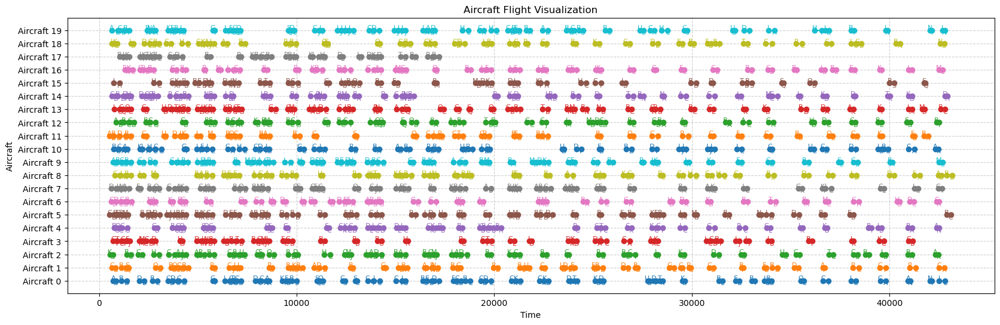

The optimal Cost provided is 8249995.0
d= 1 p= 30 h= 7
test= 7
Le coût à l'optimal a pour valeur:  5151475.0


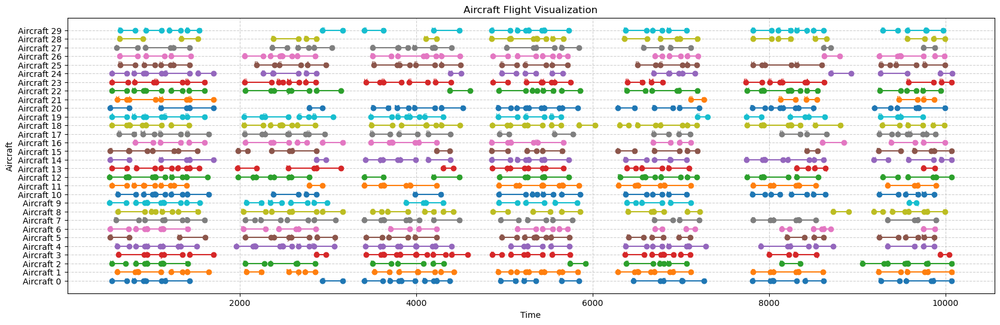

The optimal Cost provided is 5151475.0
d= 1 p= 30 h= 15
test= 3
Le coût à l'optimal a pour valeur:  8308948.0


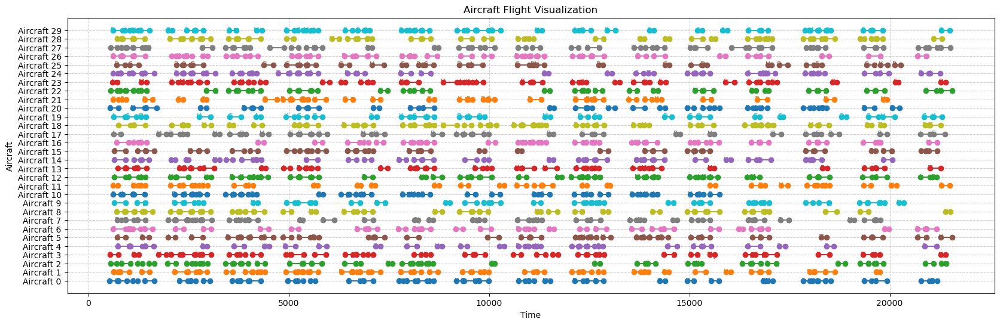

The optimal Cost provided is 8308948.0
d= 1 p= 30 h= 21
test= 3
Le coût à l'optimal a pour valeur:  9666845.0


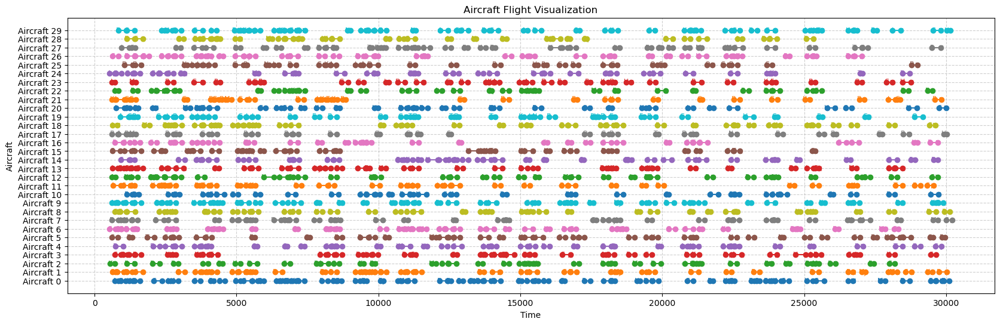

The optimal Cost provided is 9666845.0
d= 1 p= 30 h= 30
test= 2


In [ ]:
for d in [0.5,0.7,1]:
    for p in [10,20,30,40]:
        for h in [7,15,21,30]:
            print("d=",d,"p=",p,"h=",h)
            if d!=0.5 or p!=30 or h!=21:
                t=np.random.randint(0,10)
                print("test=", t)
                Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
                        d=d, p=p, h=h, t=t, file_path=None
                    )
                m = Model(str((d,p,h,t)))

                Solve_and_represent(m,(d,p,h,t),optimal_representation(p))

                file_path_sol = "d="+str(d)+"\p="+str(p)+"\h="+str(h)+"\Optimal_Solution_density="+str(d)+"_p="+str(p)+"_h="+str(h)+"_test_"+str(t)+".txt"
                otpimal_objective[(d,p,h,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

                print("The optimal Cost provided is", otpimal_objective[(d,p,h,t)])

In [1]:
print(solving_time)

NameError: name 'solving_time' is not defined

## d=0.5
### p=10 
#### h=7


<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\1572200805.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  767779.0


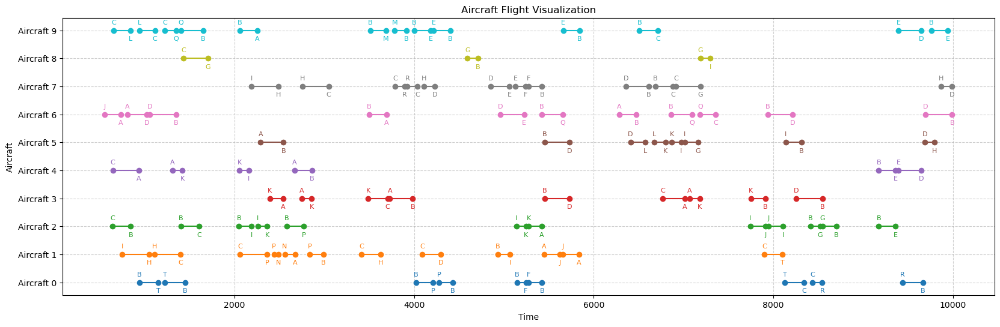

The optimal Cost provided is 767779.0


In [200]:
# test 1
t=1
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=7, t=t, file_path=None
)
m = Model(str((0.5,10,7,t)))

Solve_and_represent(m,(0.5,10,7,t),0.4)

file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,7,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,7,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\3549826370.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  989823.0


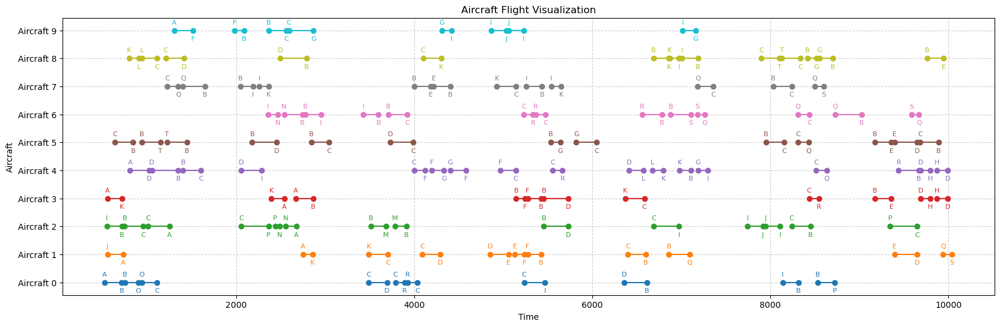

The optimal Cost provided is 989823.0


In [201]:
# test 2
t=2
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=7, t=t, file_path=None
)
m = Model(str((0.5,10,7,t)))

Solve_and_represent(m,(0.5,10,7,t),0.4)

file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,7,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,7,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\1116295287.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  778912.0


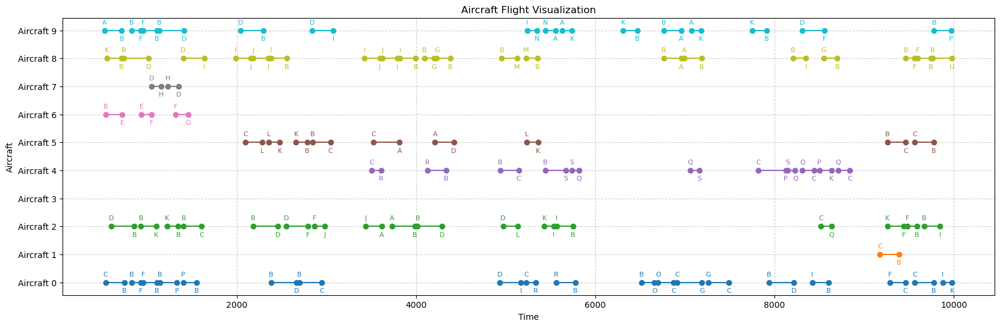

The optimal Cost provided is 778912.0


In [202]:
# test 3
t=3
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=7, t=t, file_path=None
)
m = Model(str((0.5,10,7,t)))

Solve_and_represent(m,(0.5,10,7,t),0.4)

file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,7,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,7,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\451680069.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  1014563.0


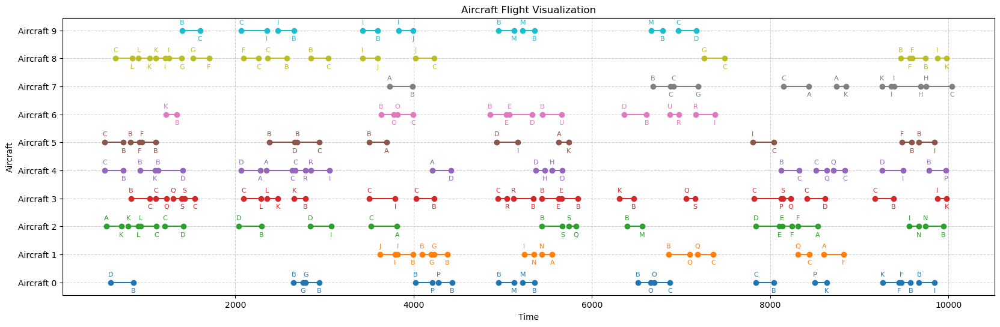

The optimal Cost provided is 1014563.0


In [203]:
# test 4
t=4
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=7, t=t, file_path=None
)
m = Model(str((0.5,10,7,t)))

Solve_and_represent(m,(0.5,10,7,t),0.4)

file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,7,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,7,t)])

Le coût à l'optimal a pour valeur:  519756.0


<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\2219431247.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"


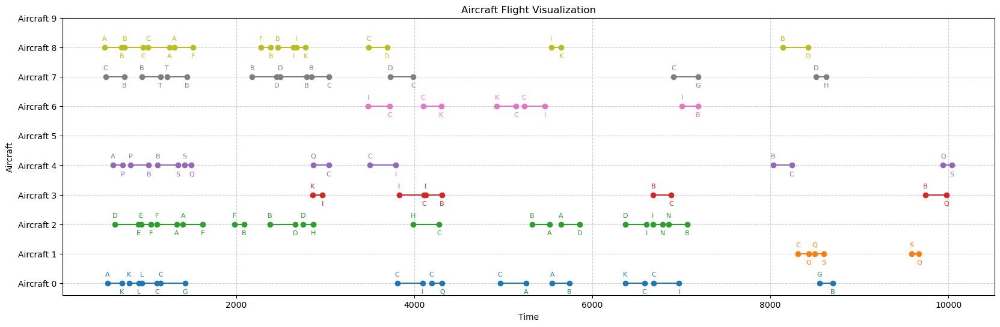

The optimal Cost provided is 519756.0


In [204]:
# test 5
t=5
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=7, t=t, file_path=None
)
m = Model(str((0.5,10,7,t)))

Solve_and_represent(m,(0.5,10,7,t),0.4)

file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,7,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,7,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\705347647.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  837052.0


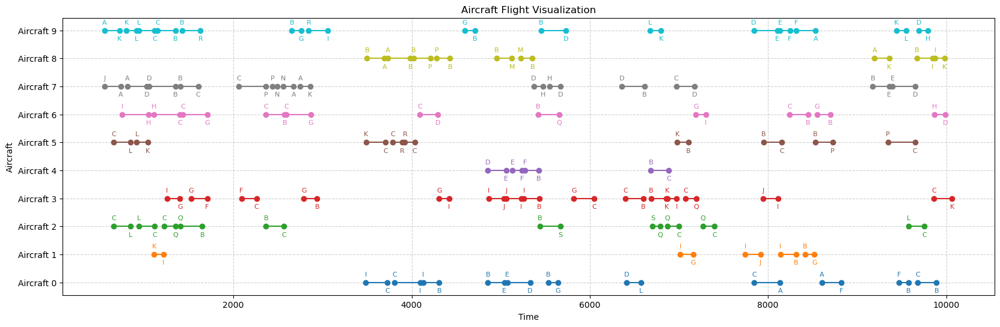

The optimal Cost provided is 837052.0


In [205]:
# test 6
t=6
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=7, t=t, file_path=None
)
m = Model(str((0.5,10,7,t)))

Solve_and_represent(m,(0.5,10,7,t),0.4)

file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,7,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,7,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\2420268553.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  853751.0


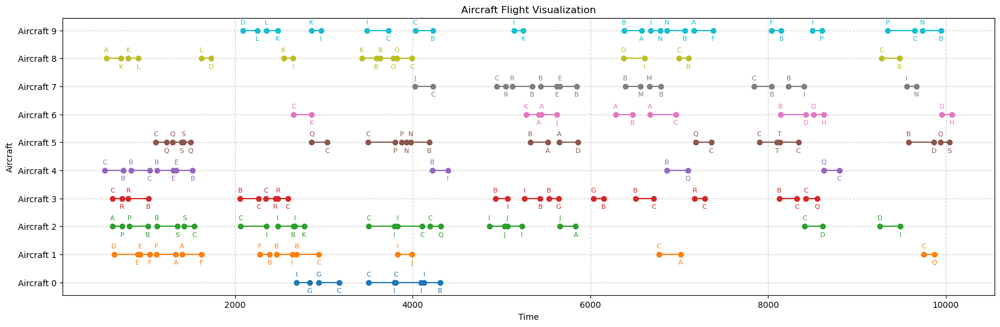

The optimal Cost provided is 853751.0


In [206]:
# test 7
t=7
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=7, t=t, file_path=None
)
m = Model(str((0.5,10,7,t)))

Solve_and_represent(m,(0.5,10,7,t),0.4)

file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,7,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,7,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\3674900145.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  790251.0


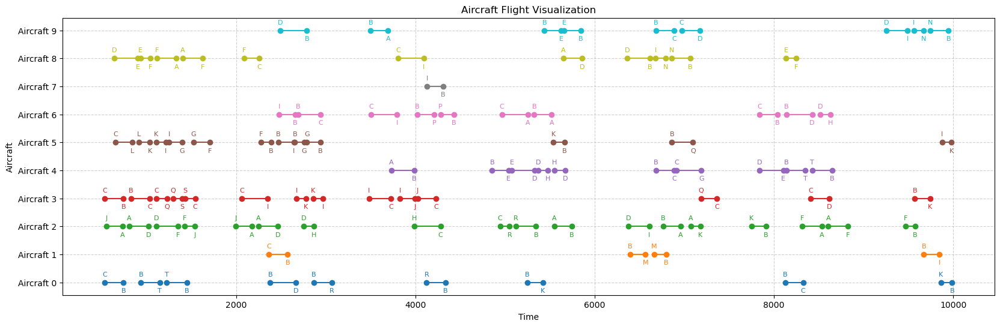

The optimal Cost provided is 790251.0


In [207]:
# test 8
t=8
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=7, t=t, file_path=None
)
m = Model(str((0.5,10,7,t)))

Solve_and_represent(m,(0.5,10,7,t),0.4)

file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,7,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,7,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\1009963392.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  837052.0


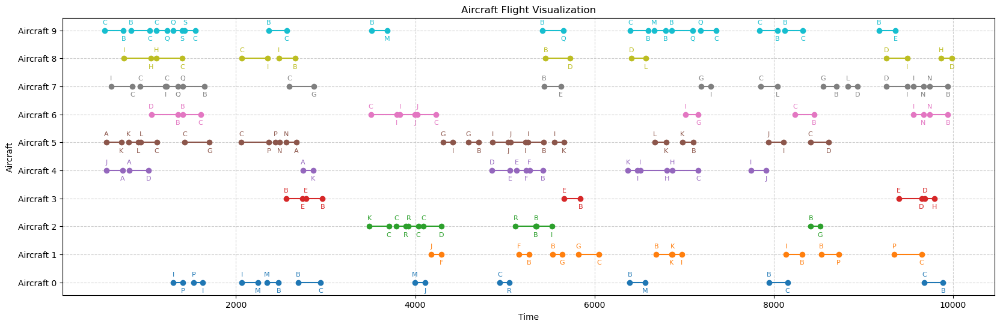

The optimal Cost provided is 837052.0


In [208]:
# test 9
t=9
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=7, t=t, file_path=None
)
m = Model(str((0.5,10,7,t)))

Solve_and_represent(m,(0.5,10,7,t),0.4)

file_path_sol = "d=0.5\p=10\h=7\Optimal_Solution_density=0.5_p=10_h=7_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,7,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,7,t)])

In [209]:
print(solving_time)

{(0.5, 10, 7, 0): 0.04699993133544922, (0.5, 10, 7, 1): 0.05299997329711914, (0.5, 10, 7, 2): 0.07799983024597168, (0.5, 10, 7, 3): 0.0690000057220459, (0.5, 10, 7, 4): 0.06599998474121094, (0.5, 10, 7, 5): 0.014999866485595703, (0.5, 10, 7, 6): 0.042999982833862305, (0.5, 10, 7, 7): 0.039999961853027344, (0.5, 10, 7, 8): 0.03099989891052246, (0.5, 10, 7, 9): 0.03800010681152344}


## d=0.5
### p=10 
#### h=15

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\182896788.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  1137029.0


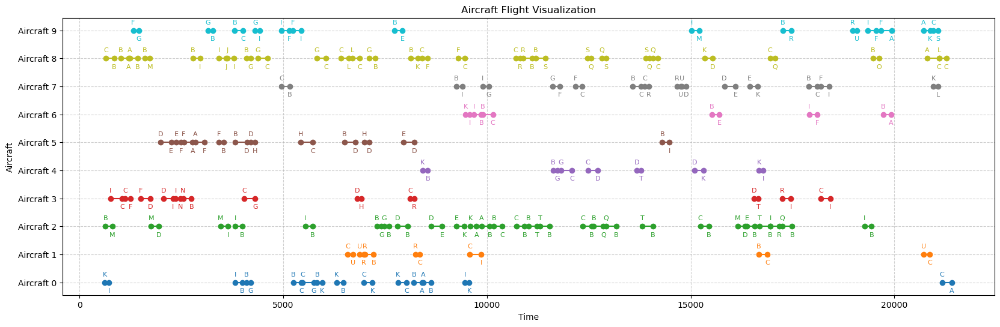

The optimal Cost provided is 1137029.0


In [212]:
# test 0
t=0
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=15, t=t, file_path=None
)
m = Model(str((0.5,10,15,t)))

Solve_and_represent(m,(0.5,10,15,t),0.4)

file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,15,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,15,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\71163560.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  1046314.0


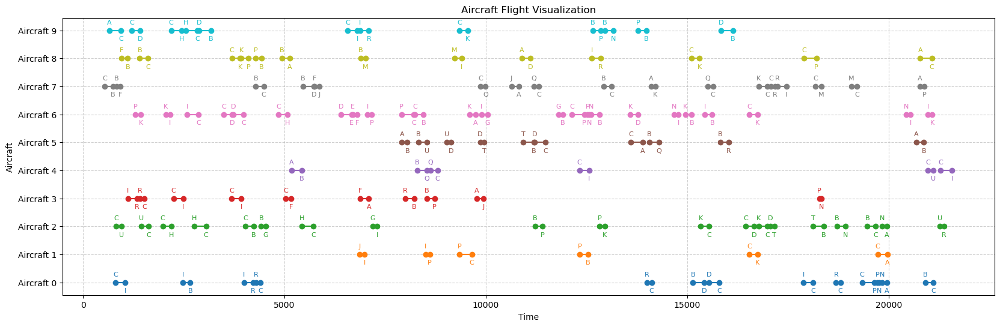

The optimal Cost provided is 1046314.0


In [213]:
# test 1
t=1
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=15, t=t, file_path=None
)
m = Model(str((0.5,10,15,t)))

Solve_and_represent(m,(0.5,10,15,t),0.4)

file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,15,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,15,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\1560727285.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  966938.0


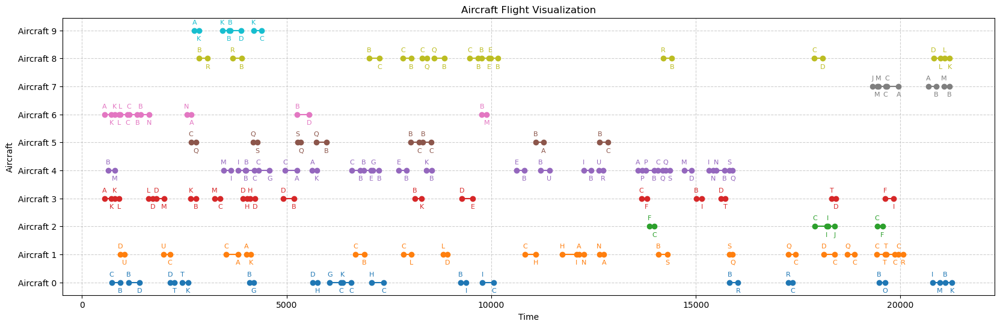

The optimal Cost provided is 966938.0


In [214]:
# test 2
t=2
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=15, t=t, file_path=None
)
m = Model(str((0.5,10,15,t)))

Solve_and_represent(m,(0.5,10,15,t),0.4)

file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,15,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,15,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\3402596066.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  1489374.0


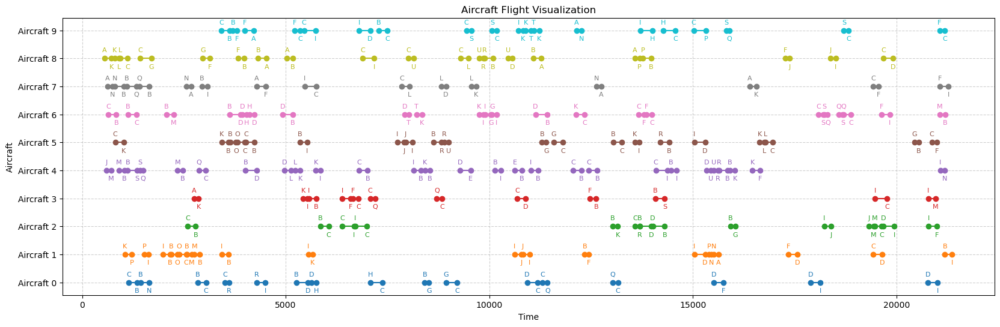

The optimal Cost provided is 1489374.0


In [215]:
# test 3
t=3
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=15, t=t, file_path=None
)
m = Model(str((0.5,10,15,t)))

Solve_and_represent(m,(0.5,10,15,t),0.4)

file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,15,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,15,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\4222042649.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  1356806.0


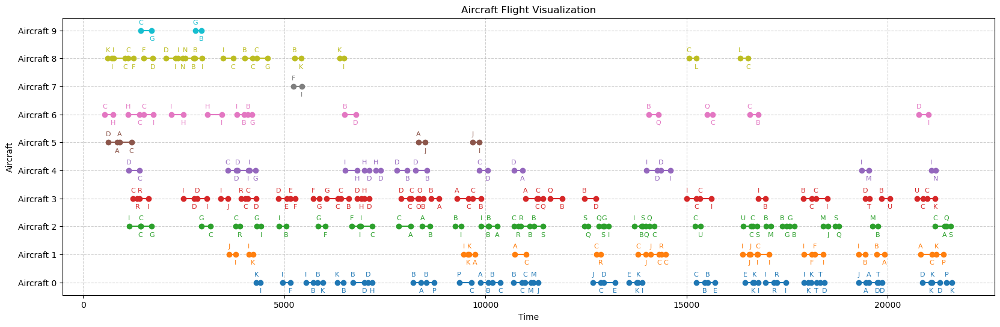

The optimal Cost provided is 1356806.0


In [216]:
# test 4
t=4
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=15, t=t, file_path=None
)
m = Model(str((0.5,10,15,t)))

Solve_and_represent(m,(0.5,10,15,t),0.4)

file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,15,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,15,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\2279167228.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  1598231.0


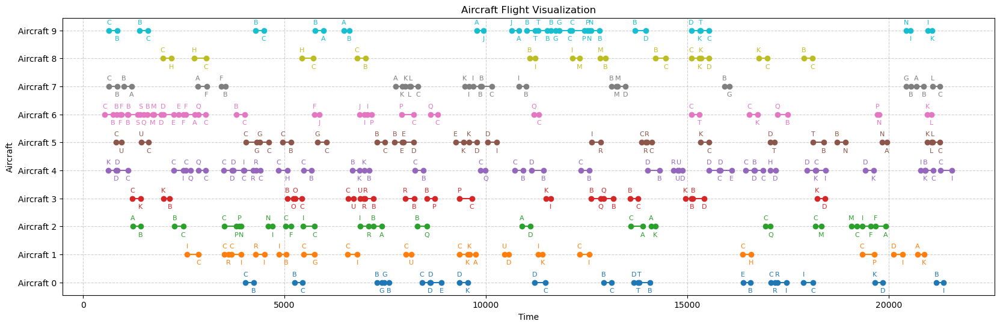

The optimal Cost provided is 1598231.0


In [217]:
# test 5
t=5
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=15, t=t, file_path=None
)
m = Model(str((0.5,10,15,t)))

Solve_and_represent(m,(0.5,10,15,t),0.4)

file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,15,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,15,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\2747343592.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  1626888.0


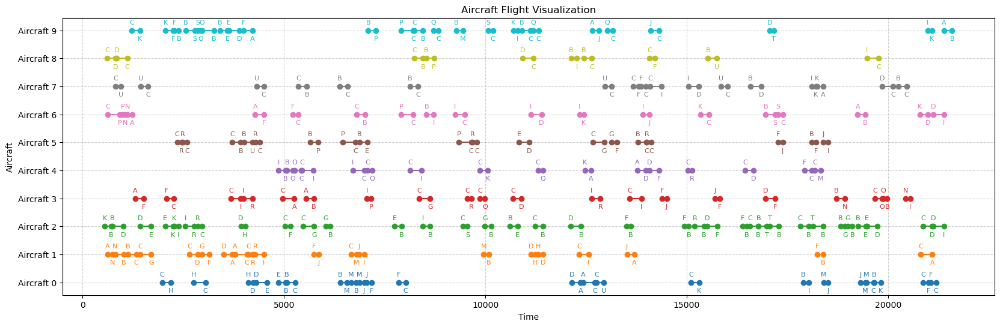

The optimal Cost provided is 1626888.0


In [218]:
# test 6
t=6
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=15, t=t, file_path=None
)
m = Model(str((0.5,10,15,t)))

Solve_and_represent(m,(0.5,10,15,t),0.4)

file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,15,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,15,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\2324712366.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  1364847.0


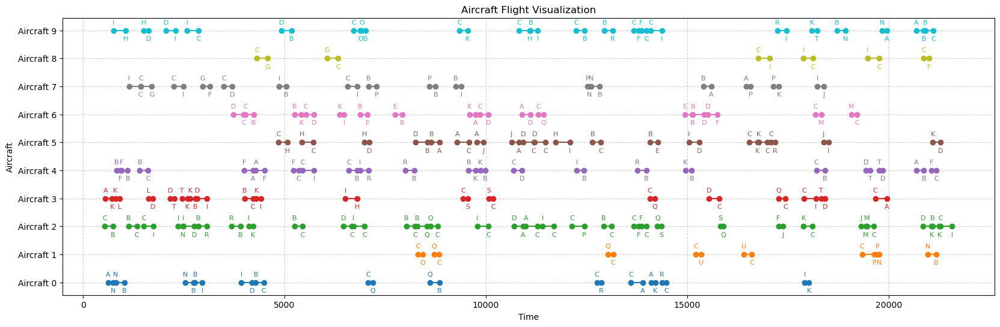

The optimal Cost provided is 1364847.0


In [219]:
# test 7
t=7
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=15, t=t, file_path=None
)
m = Model(str((0.5,10,15,t)))

Solve_and_represent(m,(0.5,10,15,t),0.4)

file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,15,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,15,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\2235225573.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  1698636.0


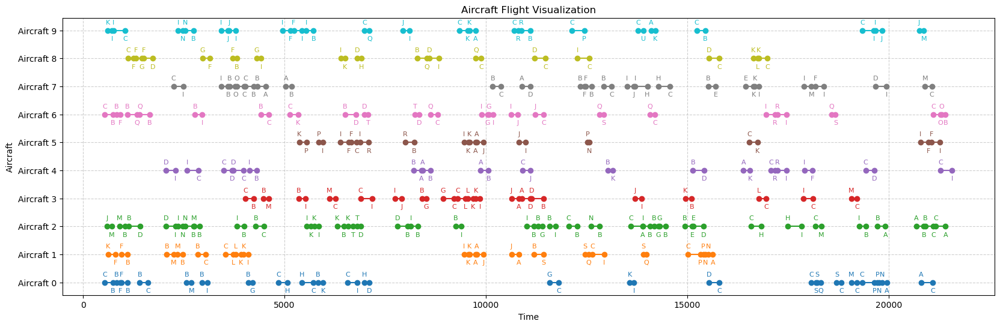

The optimal Cost provided is 1698636.0


In [220]:
# test 8
t=8
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=15, t=t, file_path=None
)
m = Model(str((0.5,10,15,t)))

Solve_and_represent(m,(0.5,10,15,t),0.4)

file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,15,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,15,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\1184297514.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  1137029.0


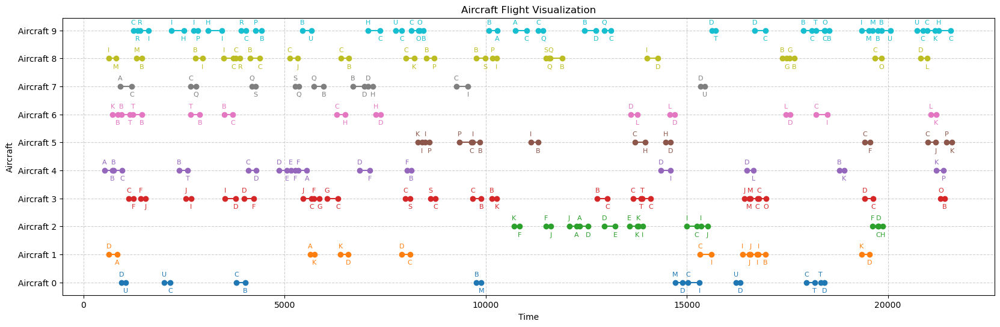

The optimal Cost provided is 1137029.0


In [221]:
# test 9
t=9
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=15, t=t, file_path=None
)
m = Model(str((0.5,10,15,t)))

Solve_and_represent(m,(0.5,10,15,t),0.4)

file_path_sol = "d=0.5\p=10\h=15\Optimal_Solution_density=0.5_p=10_h=15_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,15,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,15,t)])

## d=0.5
### p=10 
#### h=21

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\4082969027.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  883645.0


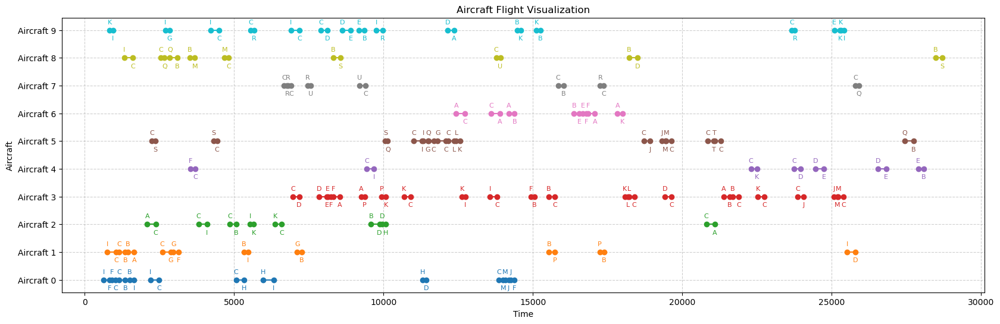

The optimal Cost provided is 883645.0


In [222]:
# test 0
t=0
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=21, t=t, file_path=None
)
m = Model(str((0.5,10,21,t)))

Solve_and_represent(m,(0.5,10,21,t),0.4)

file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,21,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,21,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\1283738635.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  865709.0


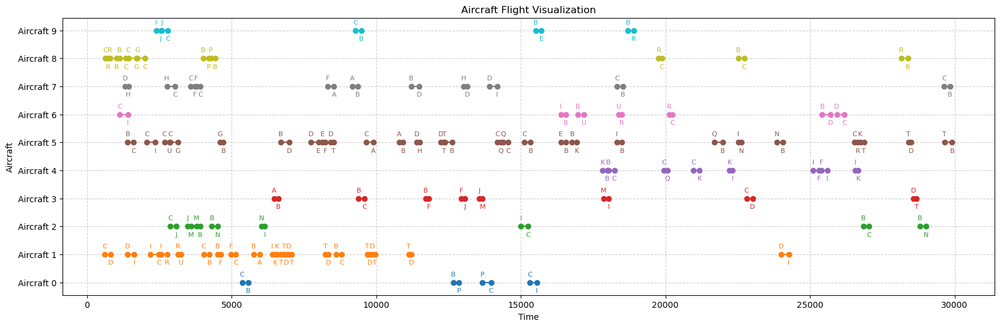

The optimal Cost provided is 865709.0


In [223]:
# test 1
t=1
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=21, t=t, file_path=None
)
m = Model(str((0.5,10,21,t)))

Solve_and_represent(m,(0.5,10,21,t),0.4)

file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,21,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,21,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\1117617159.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  1008378.0


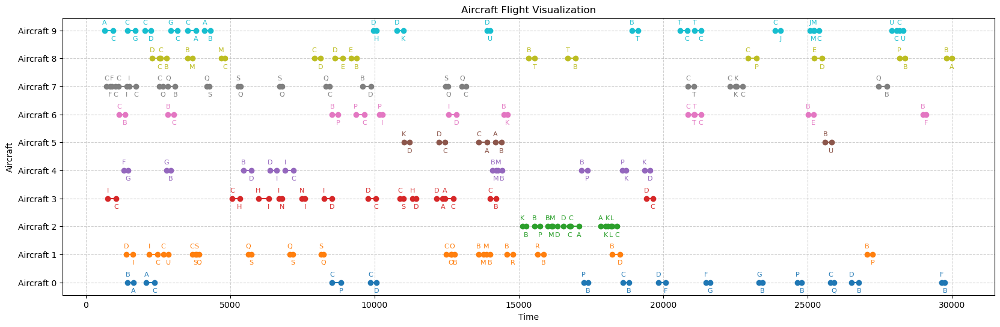

The optimal Cost provided is 1008378.0


In [224]:
# test 2
t=2
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=21, t=t, file_path=None
)
m = Model(str((0.5,10,21,t)))

Solve_and_represent(m,(0.5,10,21,t),0.4)

file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,21,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,21,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\682366364.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  913334.0


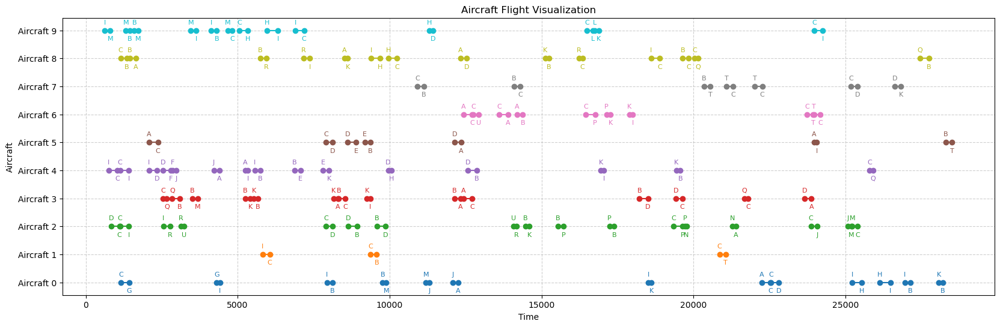

The optimal Cost provided is 913334.0


In [225]:
# test 3
t=3
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=21, t=t, file_path=None
)
m = Model(str((0.5,10,21,t)))

Solve_and_represent(m,(0.5,10,21,t),0.4)

file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,21,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,21,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\1834464066.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  1364847.0


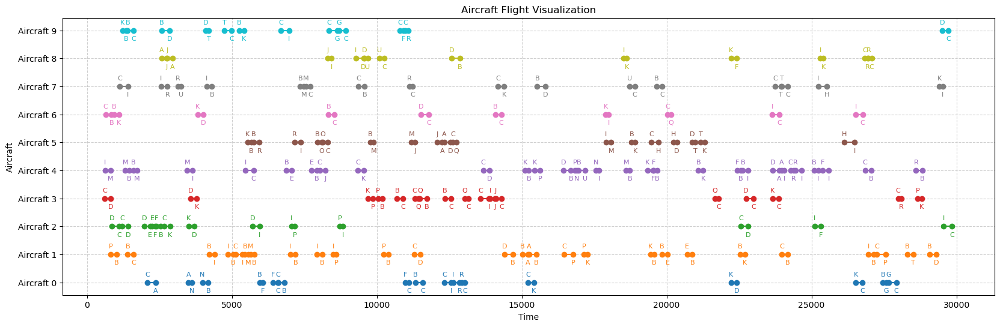

The optimal Cost provided is 1364847.0


In [226]:
# test 4
t=4
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=21, t=t, file_path=None
)
m = Model(str((0.5,10,21,t)))

Solve_and_represent(m,(0.5,10,21,t),0.4)

file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,21,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,21,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\622146772.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  1323200.0


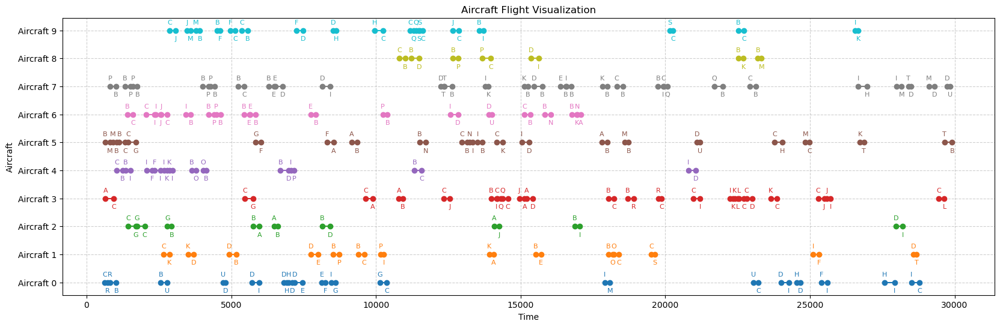

The optimal Cost provided is 1323200.0


In [227]:
# test 5
t=5
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=21, t=t, file_path=None
)
m = Model(str((0.5,10,21,t)))

Solve_and_represent(m,(0.5,10,21,t),0.4)

file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,21,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,21,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\2025520427.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  1050850.0


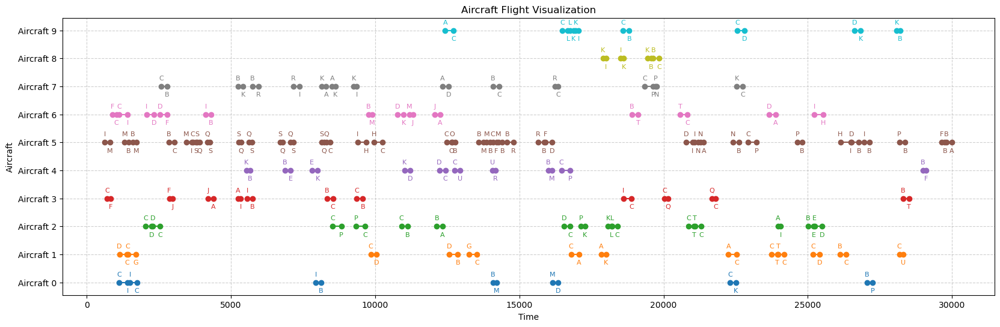

The optimal Cost provided is 1050850.0


In [228]:
# test 6
t=6
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=21, t=t, file_path=None
)
m = Model(str((0.5,10,21,t)))

Solve_and_represent(m,(0.5,10,21,t),0.4)

file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,21,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,21,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\2836670742.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  1230217.0


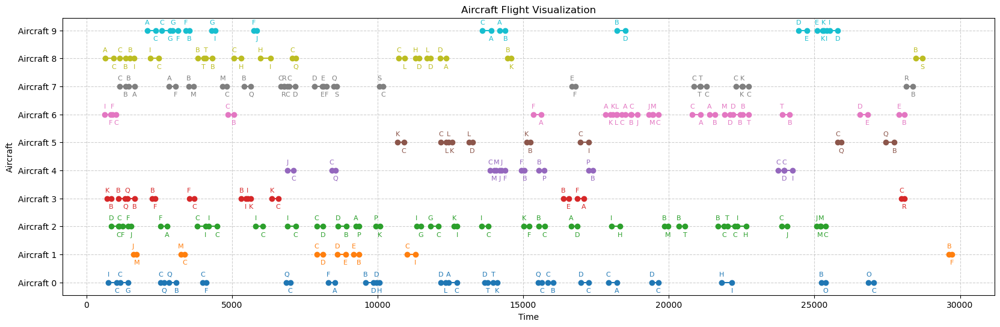

The optimal Cost provided is 1230217.0


In [229]:
# test 7
t=7
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=21, t=t, file_path=None
)
m = Model(str((0.5,10,21,t)))

Solve_and_represent(m,(0.5,10,21,t),0.4)

file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,21,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,21,t)])

<>:10: SyntaxWarning: invalid escape sequence '\p'
<>:10: SyntaxWarning: invalid escape sequence '\p'
C:\Users\ASUS\AppData\Local\Temp\ipykernel_19364\1931852721.py:10: SyntaxWarning: invalid escape sequence '\p'
  file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"


Le coût à l'optimal a pour valeur:  1535967.0


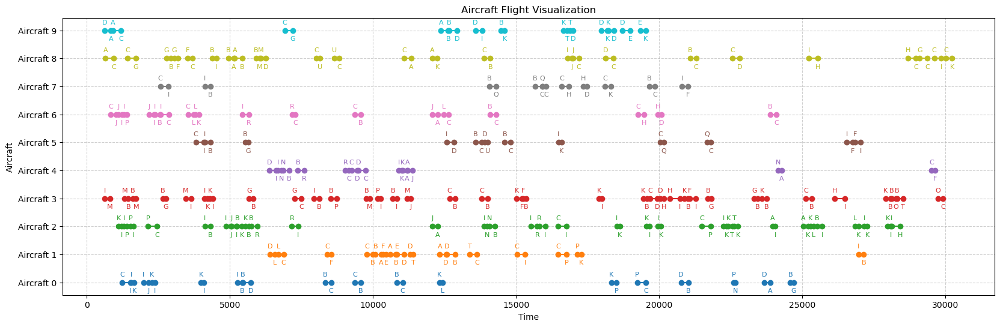

The optimal Cost provided is 1535967.0


In [230]:
# test 8
t=8
Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = Extract(
    d=0.5, p=10, h=21, t=t, file_path=None
)
m = Model(str((0.5,10,21,t)))

Solve_and_represent(m,(0.5,10,21,t),0.4)

file_path_sol = "d=0.5\p=10\h=21\Optimal_Solution_density=0.5_p=10_h=21_test_"+str(t)+".txt"
otpimal_objective[(0.5,10,21,t)] = Extract_cost_from_sol(file_path_sol=file_path_sol)

print("The optimal Cost provided is", otpimal_objective[(0.5,10,21,t)])

## Runtime representation

In [210]:
def runtime(d, p, h, t):
    Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin = (
        Extract(d=d, p=p, h=h, t=t)
    )
    m = Model("Test 2")
    X = {
        (i, j): m.addVar(vtype=GRB.BINARY, name="x" + str(i) + " " + str(j))
        for i in Aircrafts
        for j in Flights
    }

    # -- Uniqueness of airplane assignment to flights
    for j in Flights:
        m.addConstr(quicksum([X[(i, j)] for i in Aircrafts]) == 1, name="U" + str(j))

    # -- No Time Table Conflicts
    for j in Flights:
        for i in Aircrafts:
            for k in (D_d_plus(j) & D_a_minus(j)) | (A_d_plus(j) & A_a_minus(j)):
                m.addConstr(
                    X[(i, j)] + X[(i, k)] <= 1,
                    name="NTTC" + str(i) + " " + str(j) + " " + str(k),
                )

    # -- Continuity of Flights for non origins
    for i in Aircrafts:
        for j in Flights:
            if j not in O(i):
                m.addConstr(
                    quicksum(
                        [X[(i, k)] for k in Co_minus(j) & A_d_minus(j)]
                        + [X[(i, l)] * (-1) for l in D(j) & D_d_minus(j)]
                        + [X[(i, j)] * (-1)]
                    )
                    >= 0
                )

    # -- Departure / continuity for potential origins
    for i in Aircrafts:
        for j in O(i):
            m.addConstr(
                quicksum(
                    [X[(i, k)] for k in Co_minus(j) & A_d_minus(j)]
                    + [X[(i, l)] * (-1) for l in D(j) & D_d_minus(j)]
                    + [X[(i, j)] * (-1)]
                )
                >= -1
            )

    # Objective Function
    m.setObjective(
        quicksum(X[(i, j)] * cost[(i, j)] for i in Aircrafts for j in Flights),
        GRB.MINIMIZE,
    )

    m.setParam("OutputFlag", 0)
    m.update()

    m.write("Test3.lp")

    m.optimize()
    if m.status == GRB.INFEASIBLE:
        print("Le modèle n'a pas de solution. Voici les contraintes le rendant ainsi")
        m.computeIIS()
        for c in m.getConstrs():
            if c.IISConstr:
                print(f"\t{c.constrname}: {m.getRow(c)} {c.Sense} {c.RHS}")
    elif m.status == GRB.UNBOUNDED:
        print("Le modèle est non borné")
    else:
        print("Le coût à l'optimal a pour valeur: ", m.ObjVal)

    return m.Runtime

In [211]:
print(runtime(d=1, p=20, h=7, t=0))

KeyError: 104

# Linear Programming Model And Solution Representation :

We package below the linear Programming model and The Solution Representation as a callable function:

In [ ]:
def Solve_and_represent(
    Aero, Aircrafts, Flights, AeroDep, AeroArr, DateDep, DateArr, cost, Origin
):

    m = Model("Test 3")
    X = {
        (i, j): m.addVar(vtype=GRB.BINARY, name="x" + str(i) + str(j))
        for i in Aircrafts
        for j in Flights
    }

    # -- Uniqueness of airplane assignment to flights
    for j in Flights:
        m.addConstr(quicksum([X[(i, j)] for i in Aircrafts]) == 1, name="U" + str(j))

    # -- No Time Table Conflicts
    for j in Flights:
        for i in Aircrafts:
            for k in (D_d_plus(j) & D_a_minus(j)) | (A_d_plus(j) & A_a_minus(j)):
                m.addConstr(
                    X[(i, j)] + X[(i, k)] <= 1, name="NTTC" + str(i) + str(j) + str(k)
                )

    # -- Continuity of Flights for non origins
    for i in Aircrafts:
        for j in Flights:
            if j not in O(i):
                m.addConstr(
                    quicksum(
                        [X[(i, k)] for k in Co_minus(j) & A_d_minus(j)]
                        + [X[(i, j)] * (-1)]
                    )
                    >= 0
                )

    # -- Departure / continuity for potential origins
    for i in Aircrafts:
        for j in O(i):
            m.addConstr(
                quicksum(
                    [X[(i, k)] for k in Co_minus(j) & A_d_minus(j)]
                    + [X[(i, l)] * (-1) for l in D(j) & D_d_minus(j)]
                    + [X[(i, j)] * (-1)]
                )
                >= -1
            )

    # Objective Function
    m.setObjective(
        quicksum(X[(i, j)] * cost[(i, j)] for i in Aircrafts for j in Flights),
        GRB.MINIMIZE,
    )

    m.update()

    m.write("Test3.lp")

    m.optimize()
    if m.status == GRB.INFEASIBLE:
        print("Le modèle n'a pas de solution. Voici les contraintes le rendant ainsi")
        m.computeIIS()
        for c in m.getConstrs():
            if c.IISConstr:
                print(f"\t{c.constrname}: {m.getRow(c)} {c.Sense} {c.RHS}")
    elif m.status == GRB.UNBOUNDED:
        print("Le modèle est non borné")
    else:
        print("Le coût à l'optimal a pour valeur: ", m.ObjVal)

    print(m.getVars())

    # Define Aircraft Assignments based on Gurobi results
    gurobi_vars = [var.x for var in m.getVars()]

    flight_assignments = {}
    index = 0
    for aircraft in Aircrafts:
        for flight in Flights:
            if gurobi_vars[index] == 1.0:
                flight_assignments[flight] = aircraft
            index += 1

    def plot_flights(aircrafts, flight_assignments):
        aircraft_colors = {
            aircraft: plt.cm.tab10(i % 10) for i, aircraft in enumerate(aircrafts)
        }

        fig, ax = plt.subplots(figsize=(10, 6))
        aircraft_map = {aircraft: i for i, aircraft in enumerate(aircrafts)}

        for flight, aircraft in flight_assignments.items():
            color = aircraft_colors[aircraft]
            y_pos = aircraft_map[aircraft]
            ax.plot(
                [DateDep[flight], DateArr[flight]],
                [y_pos, y_pos],
                marker="o",
                color=color,
                label=(
                    aircraft
                    if aircraft not in ax.get_legend_handles_labels()[1]
                    else ""
                ),
            )
            ax.text(
                DateDep[flight],
                y_pos,
                AeroDep[flight],
                verticalalignment="bottom",
                horizontalalignment="right",
                fontsize=9,
                color=color,
            )
            ax.text(
                DateArr[flight],
                y_pos,
                AeroArr[flight],
                verticalalignment="bottom",
                horizontalalignment="left",
                fontsize=9,
                color=color,
            )

        ax.set_yticks(range(len(aircrafts)))
        ax.set_yticklabels([f"Aircraft {ac}" for ac in aircrafts])
        ax.set_xlabel("Time")
        ax.set_ylabel("Aircraft")
        ax.set_title("Aircraft Flight Visualization")
        # ax.legend(title="Aircrafts")
        plt.grid(True, linestyle="--", alpha=0.6)
        plt.show()

    plot_flights(Aircrafts, flight_assignments)